In [1]:
import argparse
import sys
# sys.path.append('/home/cass/applications/yt')
import yt
import numpy as np
import pylab
import matplotlib.pyplot as plt
import matplotlib

plt.rcParams['figure.figsize'] = (12,9)

In [2]:
def _cfl(field, data):
    return ( data["velocity_x"] * (data["courant_time_step"]) / data["dx"] + 
             data["velocity_y"] * (data["courant_time_step"]) / data["dy"] + 
             data["velocity_z"] * (data["courant_time_step"]) / data["dz"] )

yt.add_field(("gas", "cfl"), function=_cfl, units="dimensionless")

/home/cwagner4/applications/miniconda3/lib/python3.6/site-packages/yt/fields/local_fields.py:46: UserWarning: Because 'sampling_type' not specified, yt will assume a cell 'sampling_type'
  warnings.warn("Because 'sampling_type' not specified, yt will "


In [3]:
idx_start = 1
idx_end = 101
didx = 1

colormap = 'arbre'
field = 'density'
center_mode = 'c'
dpi = 1000

code_units = { "length_unit":(1.0,"kpc"),
               "time_unit"  :(3.08567758096e+13,"s"),
               "mass_unit"  :(1.4690033e+36,"g") }

In [35]:
# ts1 = yt.load(['no_driv/Data_%06d'%idx for idx in range(idx_start,idx_end+1,didx)])

In [4]:
ts = yt.load(['mar6_run/Data_%06d'%idx for idx in range(idx_start,idx_end+1,didx)])

In [43]:
print(ts.outputs.index("mar6_run/"+"Data_000001"))

print(ds1)

1
Data_000000


In [17]:
ds1 = yt.load("Data_000000")
ds2 = yt.load("Data_000001")
# dsn = yt.load("mar6_run/Data_000101")

yt : [INFO     ] 2019-04-02 13:59:06,754 Parameters: current_time              = 1e-05
yt : [INFO     ] 2019-04-02 13:59:06,755 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-02 13:59:06,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-02 13:59:06,757 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-02 13:59:06,758 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-02 13:59:06,759 Parameters: current_redshift          = 99998.99999999999
yt : [INFO     ] 2019-04-02 13:59:06,759 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-02 13:59:06,760 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-02 13:59:06,761 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-02 13:59:07,069 Parameters: current_time              = 1.0000001841031177e-05
yt : [INFO     ] 2019-04-02 13:59:07,070 Parameters: domain_dimensions         = [256 256 256

In [8]:
v1=ds1.time_unit * 1.544e-13
v2=ds1.r[:].min("courant_time_step")
print(v1/v2)

1.5469793637308998e-08 dimensionless


In [17]:
cg1.get_data(["velocity_x","velocity_y","velocity_z","dx","dy","dz"])

In [26]:
CFL = cg1["velocity_x"] * (1e-5 * yt.units.second) / cg1["dx"] + cg1["velocity_y"] * (1e-5 * yt.units.second) / cg1["dy"] + cg1["velocity_z"] * (1e-5 * yt.units.second) / cg1["dz"] 
print(CFL.mean())

-2.0205997910192906e-21 dimensionless


In [24]:
print(cg1["velocity_x"].max())

3474144212.0975986 cm/s


In [26]:
cg1 = ds1.covering_grid(0, left_edge = [0.0,0.0,0.0], dims=[256,256,256])
cg2 = ds2.covering_grid(0, left_edge = [0.0,0.0,0.0], dims=[256,256,256])
# cgn = dsn.covering_grid(0, left_edge = [0.0,0.0,0.0], dims=[256,256,256])

In [27]:
cg1.get_data(["mach_number", "pressure", "density", "sound_speed", "velocity_magnitude", "total_energy","courant_time_step","cfl"])
cg2.get_data(["mach_number", "pressure", "density", "sound_speed", "velocity_magnitude", "total_energy","courant_time_step", "cfl"])
# cgn.get_data(["mach_number", "pressure", "density", "sound_speed", "velocity_magnitude", "total_energy","courant_time_step"])

In [29]:
pressure1 = cg1["pressure"]
M_s1 = cg1["mach_number"]
c_s1 = cg1["sound_speed"]
v_mag1 = cg1["velocity_magnitude"]
density1 = cg1["density"]
energy1 = cg1["total_energy"]
courant1 = cg1["courant_time_step"]
cfl1 = cg1["cfl"]
pressure2 = cg2["pressure"]
M_s2 = cg2["mach_number"]
c_s2 = cg2["sound_speed"]
v_mag2 = cg2["velocity_magnitude"]
density2 = cg2["density"]
energy2 = cg2["total_energy"]
courant2 = cg2["courant_time_step"]
cfl2 = cg2["cfl"]
# pressure_n = cgn["pressure"]
# M_s_n = cgn["mach_number"]
# c_s_n = cgn["sound_speed"]
# v_mag_n = cgn["velocity_magnitude"]
# density_n = cgn["density"]
# energy_n = cgn["total_energy"]
# courant_n = cgn["courant_time_step"]

In [31]:
print("CFL 1:",cfl1.mean(),cfl1.max(),cfl1.min())
print("CFL 2:",cfl2.mean(),cfl2.max(),cfl2.min())

CFL 1: 0.1523065154881867 dimensionless 2.735974427660092 dimensionless -2.6795139620137256 dimensionless
CFL 2: 0.15274700897154733 dimensionless 2.7303383905331198 dimensionless -2.673759470117414 dimensionless


In [30]:
print('Begin mean pressure:',pressure1.mean().in_cgs())
print('Begin mean mach number:',M_s1.mean())
print('Begin mean sound speed:',c_s1.mean())
print('Begin mean velocity magntiude:',v_mag1.mean())
print('Begin mean density:',density1.mean())
print('Begin mean total energy:',energy1.mean())
print('Begin mean courant time:',courant1.mean())

print('2 mean pressure:',pressure2.mean().in_cgs())
print('2 mean mach number:',M_s2.mean())
print('2 mean sound speed:',c_s2.mean())
print('2 mean velocity magntiude:',v_mag2.mean())
print('2 mean density:',density2.mean())
print('2 mean total energy:',energy2.mean())
print('2 mean courant time:',courant2.mean())


print('Last mean pressure:',pressure_n.mean().in_cgs())
print('Last mean mach number:',M_s_n.mean())
print('Last mean sound speed:',c_s_n.mean())
print('Last mean velocity magntiude:',v_mag_n.mean())
print('Last mean density:',density_n.mean())
print('Last mean total energy:',energy_n.mean())
print('Last mean courant time:',courant_n.mean())


# print('Calculated density:',(pressure2.mean()/v_mag2.mean()**2).in_cgs())
# print('Calculated pressure:',(1.001-1.0)*(energy2.mean()*density2.mean()).in_cgs())

# calc_cs = np.sqrt(1.001e-4*(1.001-1.0)*(energy2.mean()*density2.mean()).in_cgs()/density2.mean()).in_cgs()

# print('Calculated sound speed:',calc_cs)
# print('Calculated mach number:',(v_mag2.mean() / calc_cs).in_cgs())

Begin mean pressure: 9.204563475736059e-16 g/(cm*s**2)
Begin mean mach number: 8.396326319668772 dimensionless
Begin mean sound speed: 21167568.311640806 cm/s
Begin mean velocity magntiude: 177219042.25657433 cm/s
Begin mean density: 9.204563475988708e-30 g/cm**3
Begin mean total energy: 7.605551611341714e+17 erg/g
Begin mean courant time: 195598331352493.2 s
2 mean pressure: 9.206905746021704e-16 g/(cm*s**2)
2 mean mach number: 8.370744243154352 dimensionless
2 mean sound speed: 21068266.952300087 cm/s
2 mean velocity magntiude: 175717777.88118836 cm/s
2 mean density: 9.204563476054355e-30 g/cm**3
2 mean total energy: 7.461135501673553e+17 erg/g
2 mean courant time: 195855864287819.12 s
Last mean pressure: 9.42857088216032e-16 g/(cm*s**2)
Last mean mach number: 5.873083899798367 dimensionless
Last mean sound speed: 14886126.287267696 cm/s
Last mean velocity magntiude: 80192168.90295641 cm/s
Last mean density: 9.204564012915019e-30 g/cm**3
Last mean total energy: 2.813857642231854e+17 

In [27]:
print(pressure2.mean()/pressure1.mean())
print(M_s2.mean()/M_s1.mean())
print(c_s2.mean()/c_s1.mean())
print(v_mag2.mean()/v_mag1.mean())
print(density2.mean()/density1.mean())
print(energy2.mean()/energy1.mean())

1.0008006967008034 dimensionless
1.0001064345541018 dimensionless
0.9998452611025274 dimensionless
1.000035066715004 dimensionless
0.9999999995224894 dimensionless
1.007246148494913 dimensionless


In [10]:
# ds.fields.gas.sound_speed.get_source()

In [9]:
# print(ds.r[:].argmax("mach_number"))
# print(ds.r[:].argmax("sound_speed"))

yt : [INFO     ] 2019-04-02 14:15:27,568 Parameters: current_time              = 1.0005325613361892e-05
yt : [INFO     ] 2019-04-02 14:15:27,568 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-02 14:15:27,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-02 14:15:27,570 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-02 14:15:27,571 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-02 14:15:27,571 Parameters: current_redshift          = 99945.77221344221
yt : [INFO     ] 2019-04-02 14:15:27,572 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-02 14:15:27,573 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-02 14:15:27,573 Parameters: hubble_constant           = 0.7



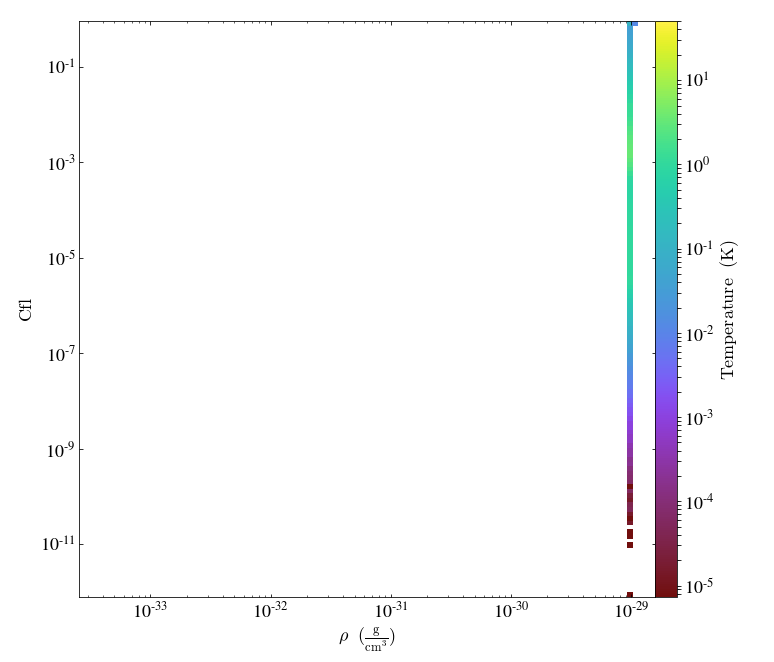

yt : [INFO     ] 2019-04-02 14:15:48,756 Parameters: current_time              = 1.0011506478603843e-05
yt : [INFO     ] 2019-04-02 14:15:48,757 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-02 14:15:48,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-02 14:15:48,759 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-02 14:15:48,760 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-02 14:15:48,760 Parameters: current_redshift          = 99884.06746084185
yt : [INFO     ] 2019-04-02 14:15:48,761 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-02 14:15:48,762 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-02 14:15:48,763 Parameters: hubble_constant           = 0.7



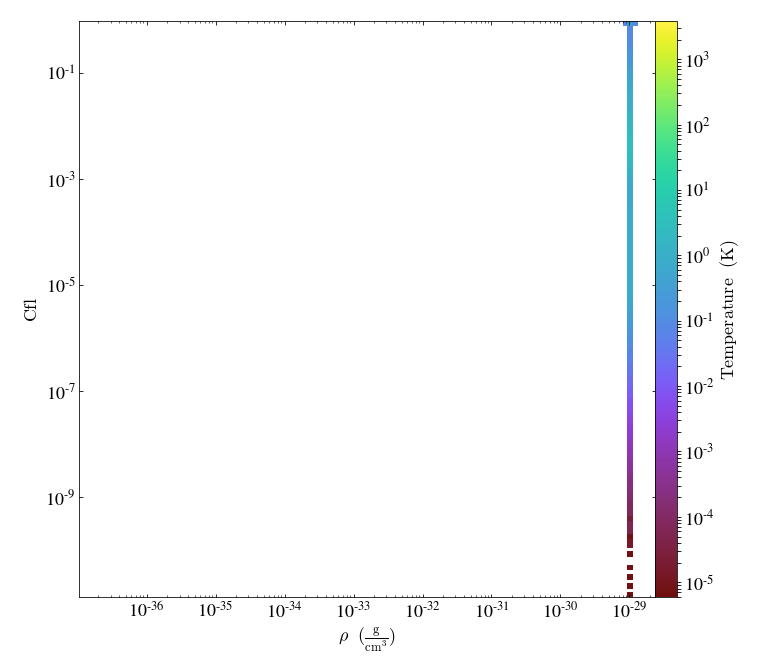

In [37]:
for ds in ts.piter():

    ad = ds.all_data()
    plot = yt.PhasePlot(ad, "density", "cfl", ["temperature"], weight_field=None)
#     plot.set_zlim("temperature",1e3,2e11)
#     plot.set_xlim(1e-33,1e-26)
#     plot.set_ylim(1e-8,1e2)
    plot.show()
#     plot.save(name=str(ds)+'_CFL_condition.png')

yt : [INFO     ] 2019-04-02 14:06:39,614 Parameters: current_time              = 1e-05
yt : [INFO     ] 2019-04-02 14:06:39,615 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-02 14:06:39,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-02 14:06:39,616 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-02 14:06:39,617 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-02 14:06:39,618 Parameters: current_redshift          = 99998.99999999999
yt : [INFO     ] 2019-04-02 14:06:39,619 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-02 14:06:39,620 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-02 14:06:39,620 Parameters: hubble_constant           = 0.7



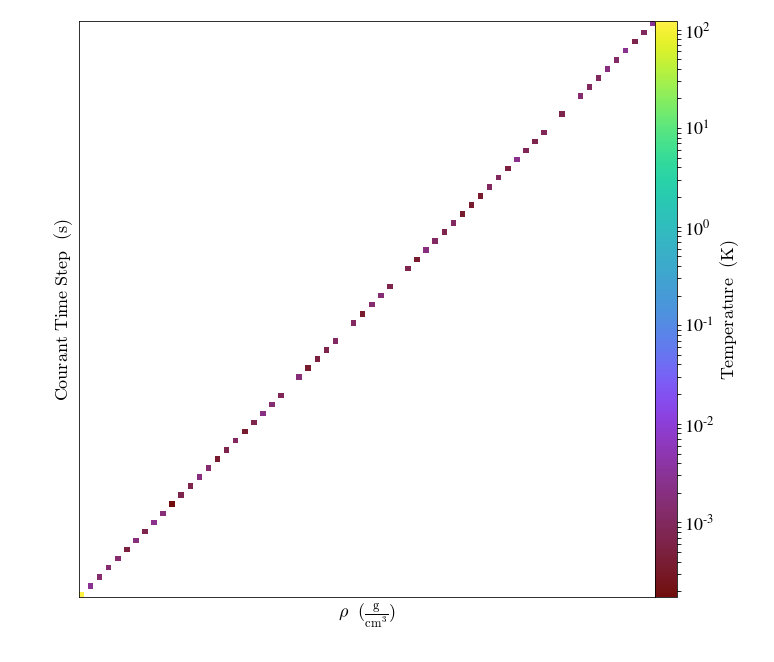

yt : [INFO     ] 2019-04-02 14:06:58,802 Parameters: current_time              = 1.0005325613361892e-05
yt : [INFO     ] 2019-04-02 14:06:58,803 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-02 14:06:58,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-02 14:06:58,804 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-02 14:06:58,805 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-02 14:06:58,806 Parameters: current_redshift          = 99945.77221344221
yt : [INFO     ] 2019-04-02 14:06:58,807 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-02 14:06:58,807 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-02 14:06:58,808 Parameters: hubble_constant           = 0.7



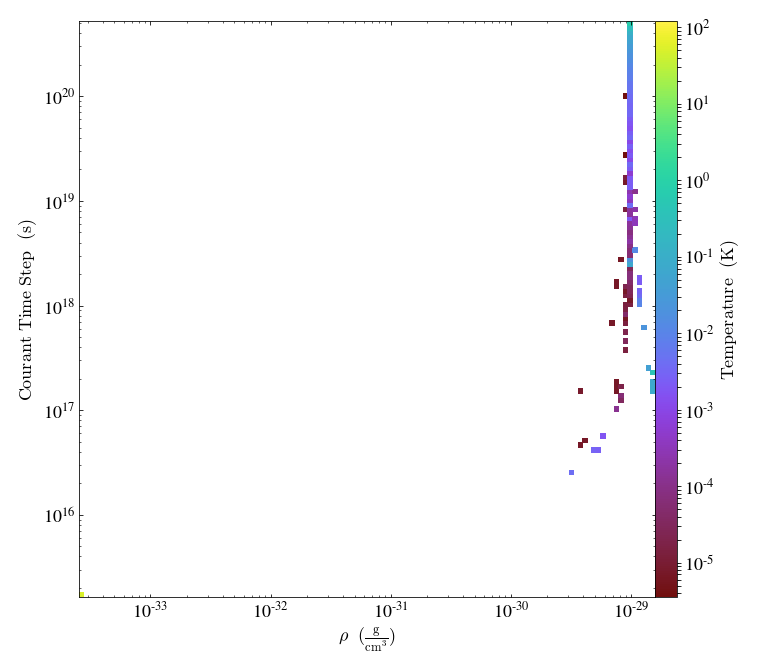

In [33]:
for ds in ts.piter():

    ad = ds.all_data()
    plot = yt.PhasePlot(ad, "density", "courant_time_step", ["temperature"], weight_field=None)
#     plot.set_zlim("temperature",1e3,2e11)
#     plot.set_xlim(1e-33,1e-26)
#     plot.set_ylim(1e12,2e16)
    plot.show()
#     plot.save(name=str(ds)+'_courant_time_step.png')

In [ ]:
### Lists to hold profiles, labels, and plot specifications.
profiles = []
labels = []
plot_specs = []

# Loop over each dataset in the time-series.
for ds in ts.piter():
    # Create a data container to hold the whole dataset.
    ad = ds.all_data()
    # Create a 1d profile of density vs. temperature.
    profiles.append(yt.create_profile(ad, ["density"],
                                   fields=["density"], weight_field=None,
                                     fractional=True))
    # Add labels and linestyles.
    labels.append("t = %.2f" % ds.current_time)
    plot_specs.append(dict(linewidth=2, alpha=0.7))

# Create the profile plot from the list of profiles.
plot = yt.ProfilePlot.from_profiles(profiles, labels=labels,
                                 plot_specs=plot_specs)

plot.show()

yt : [INFO     ] 2019-04-02 14:20:56,637 Parameters: current_time              = 1.0005325613361892e-05
yt : [INFO     ] 2019-04-02 14:20:56,638 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-02 14:20:56,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-02 14:20:56,640 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-02 14:20:56,641 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-02 14:20:56,642 Parameters: current_redshift          = 99945.77221344221
yt : [INFO     ] 2019-04-02 14:20:56,642 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-02 14:20:56,643 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-02 14:20:56,644 Parameters: hubble_constant           = 0.7



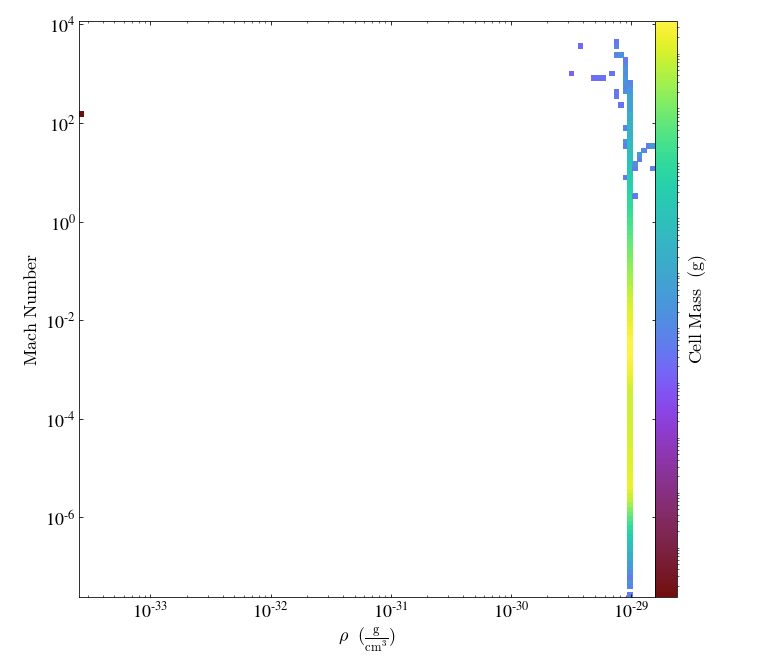

yt : [INFO     ] 2019-04-02 14:21:13,169 Parameters: current_time              = 1.0011506478603843e-05
yt : [INFO     ] 2019-04-02 14:21:13,170 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-02 14:21:13,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-02 14:21:13,172 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-02 14:21:13,173 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-02 14:21:13,174 Parameters: current_redshift          = 99884.06746084185
yt : [INFO     ] 2019-04-02 14:21:13,174 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-02 14:21:13,175 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-02 14:21:13,176 Parameters: hubble_constant           = 0.7



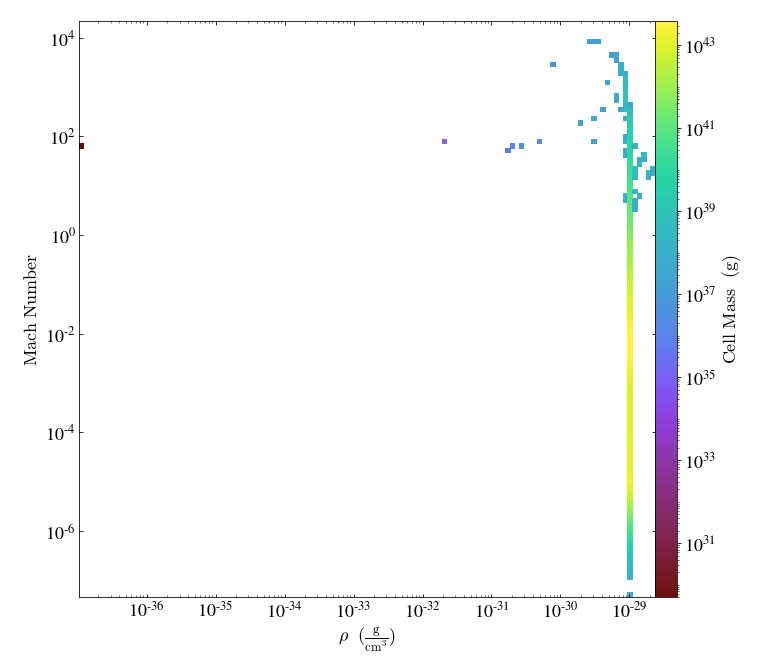

In [38]:
for ds in ts.piter():

    ad = ds.all_data()
    plot = yt.PhasePlot(ad, "density", "mach_number", ["cell_mass"], weight_field=None)
#     plot.set_zlim("cell_mass",1e34,1e43)
#     plot.set_xlim(1e-33,1e-26)
#     plot.set_ylim(1e-2,1e3)
    plot.show()
#     plot.save(name=str(ds)+'_2DPhase_dens_Ms.png')

yt : [INFO     ] 2019-04-16 11:28:00,704 Parameters: current_time              = 1.0000001841031177e-05
yt : [INFO     ] 2019-04-16 11:28:00,705 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:00,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:00,707 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:00,707 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:00,708 Parameters: current_redshift          = 99998.98158969163
yt : [INFO     ] 2019-04-16 11:28:00,709 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:00,710 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:00,711 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:02,884 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 11:28:02,886 ylim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 11:28:02,888 xlim = 


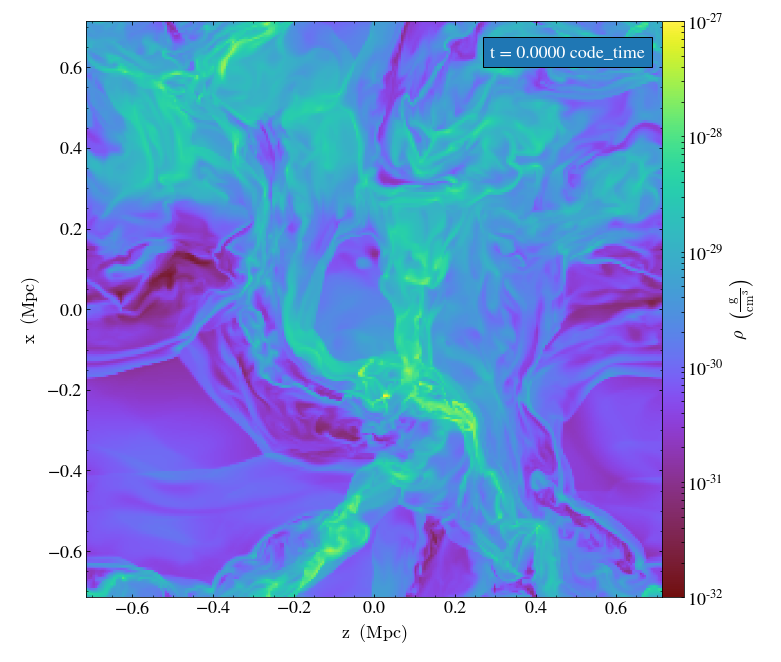

yt : [INFO     ] 2019-04-16 11:28:03,833 Saving plot Data_000001_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:04,502 Parameters: current_time              = 1.0000004458924037e-05
yt : [INFO     ] 2019-04-16 11:28:04,503 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:04,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:04,505 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:04,506 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:04,507 Parameters: current_redshift          = 99998.95541077951
yt : [INFO     ] 2019-04-16 11:28:04,508 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:04,508 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:04,509 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:06,518 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


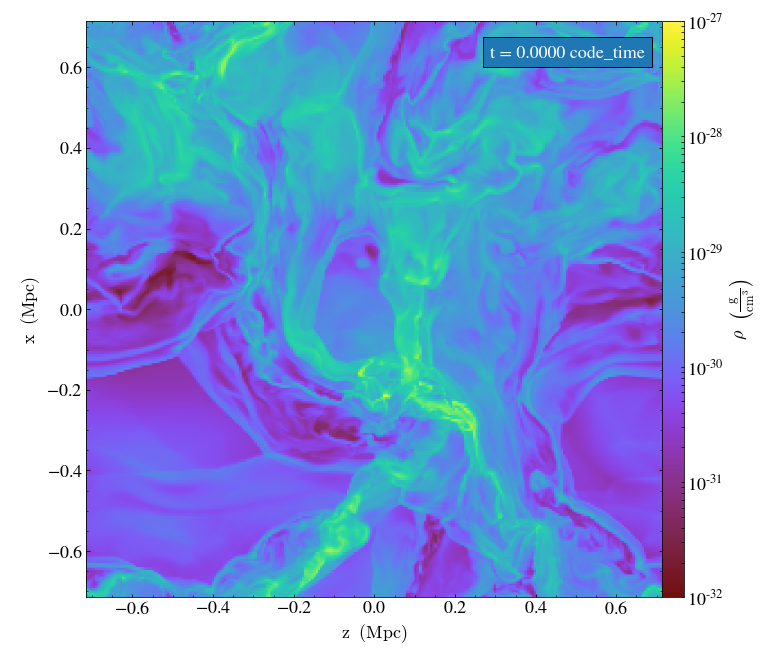

yt : [INFO     ] 2019-04-16 11:28:07,484 Saving plot Data_000002_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:08,173 Parameters: current_time              = 1.0000007152275187e-05
yt : [INFO     ] 2019-04-16 11:28:08,174 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:08,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:08,176 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:08,177 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:08,178 Parameters: current_redshift          = 99998.92847729928
yt : [INFO     ] 2019-04-16 11:28:08,178 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:08,179 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:08,180 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:10,223 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


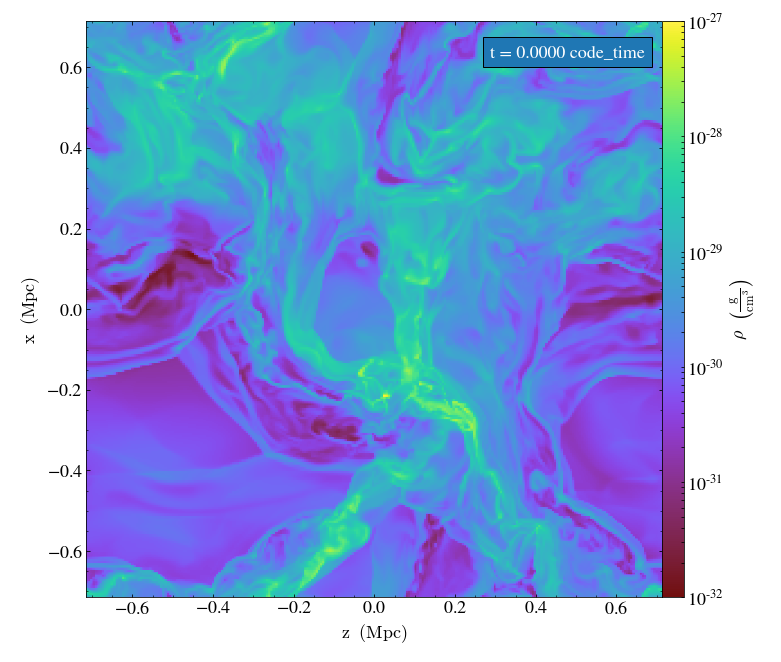

yt : [INFO     ] 2019-04-16 11:28:11,380 Saving plot Data_000003_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:12,070 Parameters: current_time              = 1.0000009746218316e-05
yt : [INFO     ] 2019-04-16 11:28:12,071 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:12,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:12,072 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:12,073 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:12,074 Parameters: current_redshift          = 99998.90253791184
yt : [INFO     ] 2019-04-16 11:28:12,075 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:12,076 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:12,077 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:14,132 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


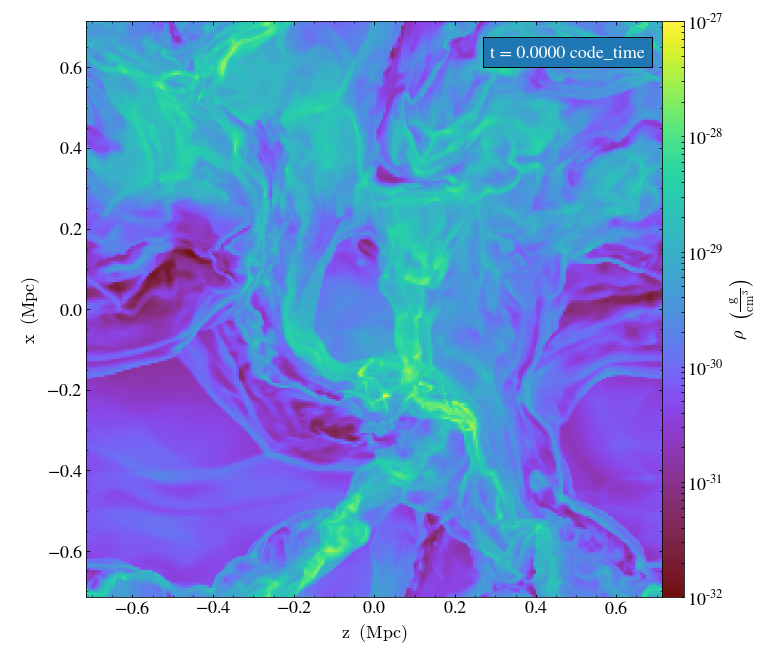

yt : [INFO     ] 2019-04-16 11:28:15,064 Saving plot Data_000004_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:15,930 Parameters: current_time              = 1.0000012293896476e-05
yt : [INFO     ] 2019-04-16 11:28:15,930 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:15,931 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:15,932 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:15,933 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:15,934 Parameters: current_redshift          = 99998.87706118639
yt : [INFO     ] 2019-04-16 11:28:15,935 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:15,936 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:15,936 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:18,556 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


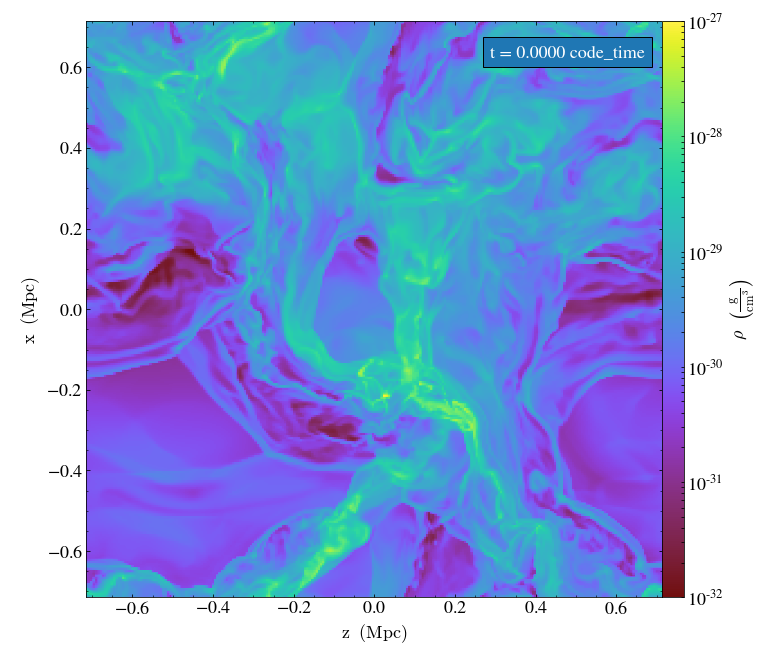

yt : [INFO     ] 2019-04-16 11:28:19,604 Saving plot Data_000005_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:20,502 Parameters: current_time              = 1.0000014342343237e-05
yt : [INFO     ] 2019-04-16 11:28:20,503 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:20,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:20,505 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:20,506 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:20,506 Parameters: current_redshift          = 99998.85657677334
yt : [INFO     ] 2019-04-16 11:28:20,507 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:20,508 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:20,509 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:23,247 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


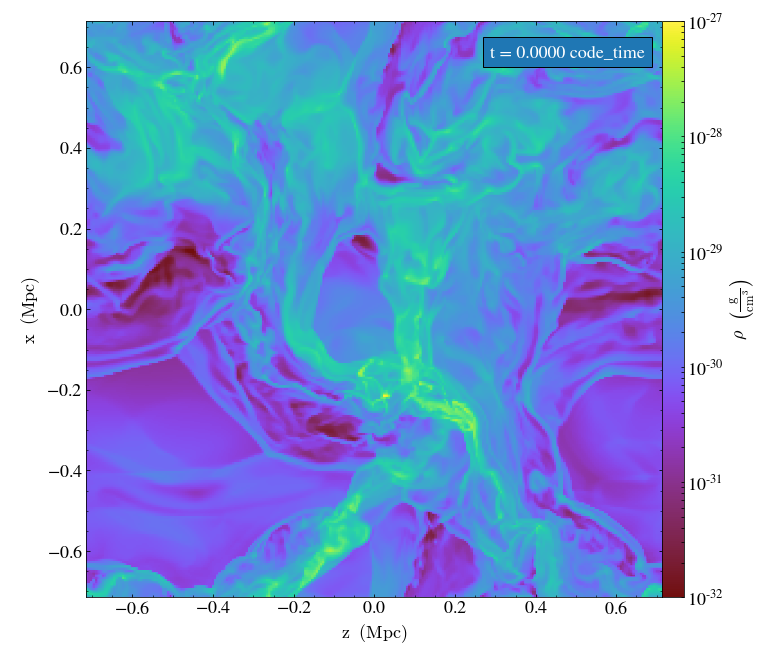

yt : [INFO     ] 2019-04-16 11:28:24,198 Saving plot Data_000006_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:25,059 Parameters: current_time              = 1.0000016614904162e-05
yt : [INFO     ] 2019-04-16 11:28:25,060 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:25,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:25,062 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:25,063 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:25,064 Parameters: current_redshift          = 99998.83385123443
yt : [INFO     ] 2019-04-16 11:28:25,064 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:25,065 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:25,066 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:27,717 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


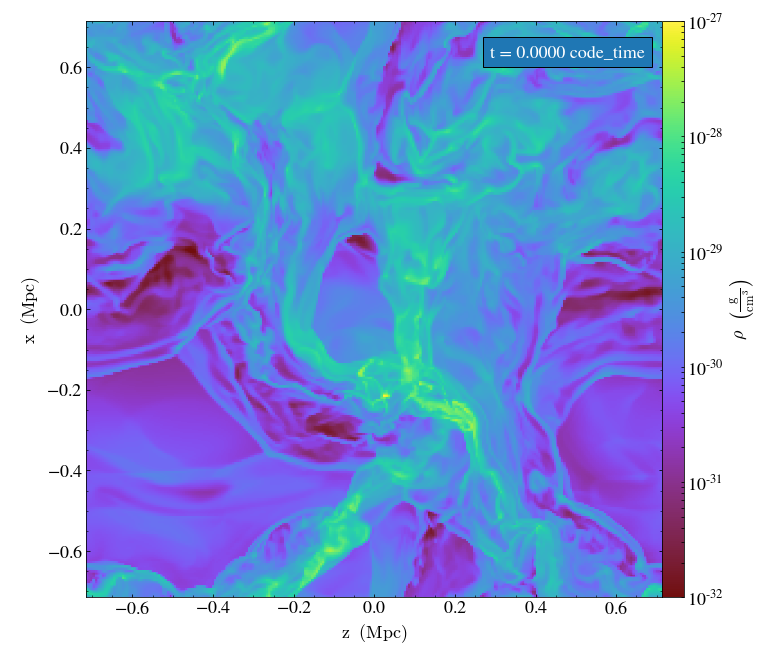

yt : [INFO     ] 2019-04-16 11:28:28,678 Saving plot Data_000007_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:29,586 Parameters: current_time              = 1.0000018288579861e-05
yt : [INFO     ] 2019-04-16 11:28:29,587 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:29,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:29,589 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:29,589 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:29,590 Parameters: current_redshift          = 99998.81711453586
yt : [INFO     ] 2019-04-16 11:28:29,591 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:29,592 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:29,592 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:32,154 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


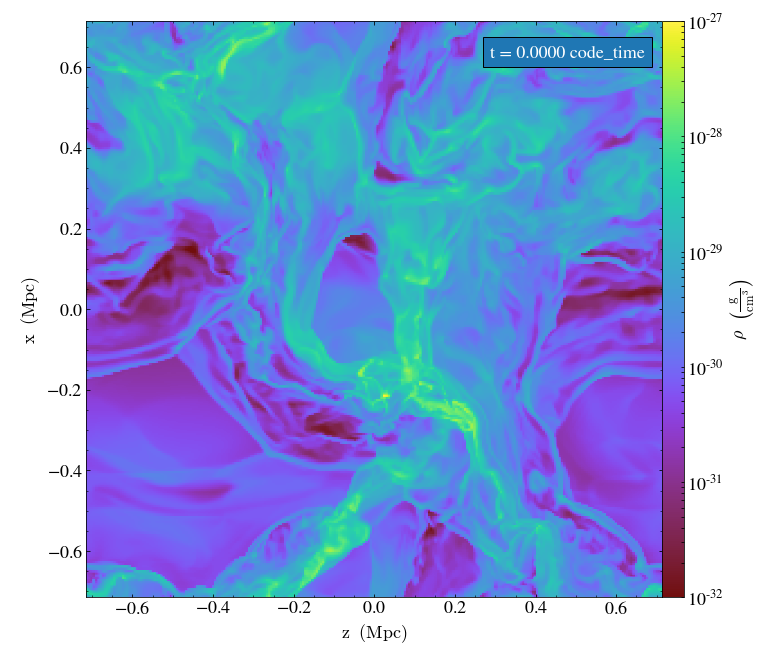

yt : [INFO     ] 2019-04-16 11:28:33,135 Saving plot Data_000008_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:33,941 Parameters: current_time              = 1.000002099137004e-05
yt : [INFO     ] 2019-04-16 11:28:33,942 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:33,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:33,944 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:33,945 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:33,946 Parameters: current_redshift          = 99998.79008674023
yt : [INFO     ] 2019-04-16 11:28:33,946 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:33,947 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:33,948 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:36,439 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


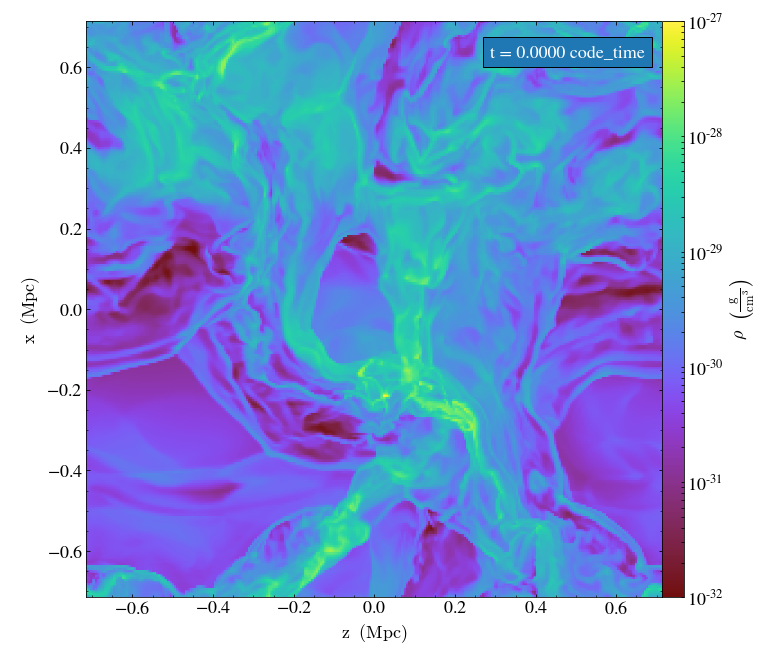

yt : [INFO     ] 2019-04-16 11:28:37,436 Saving plot Data_000009_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:38,302 Parameters: current_time              = 1.0000022906338907e-05
yt : [INFO     ] 2019-04-16 11:28:38,303 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:38,304 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:38,305 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:38,306 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:38,306 Parameters: current_redshift          = 99998.77093713563
yt : [INFO     ] 2019-04-16 11:28:38,307 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:38,308 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:38,308 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:40,957 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


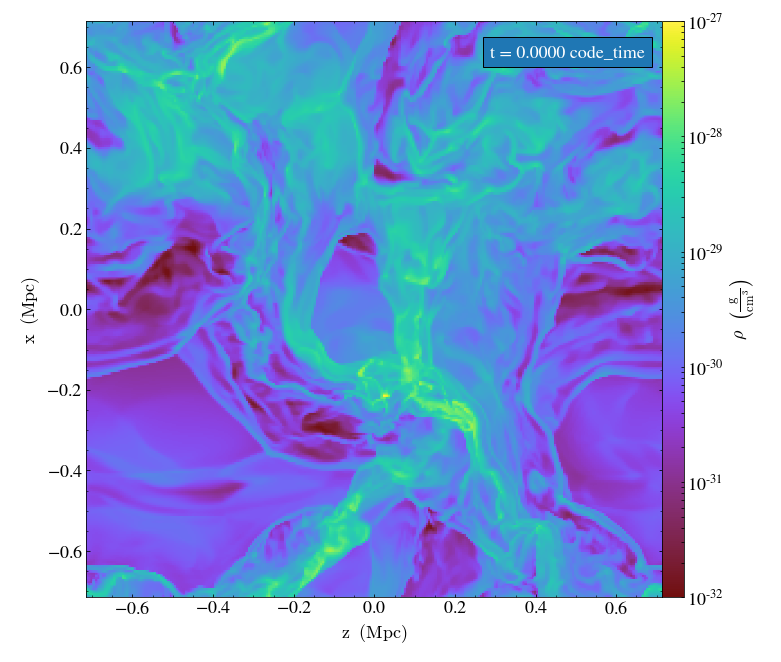

yt : [INFO     ] 2019-04-16 11:28:41,933 Saving plot Data_000010_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:42,830 Parameters: current_time              = 1.000002569217582e-05
yt : [INFO     ] 2019-04-16 11:28:42,831 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:42,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:42,833 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:42,834 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:42,835 Parameters: current_redshift          = 99998.74307890188
yt : [INFO     ] 2019-04-16 11:28:42,835 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:42,836 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:42,837 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:45,618 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


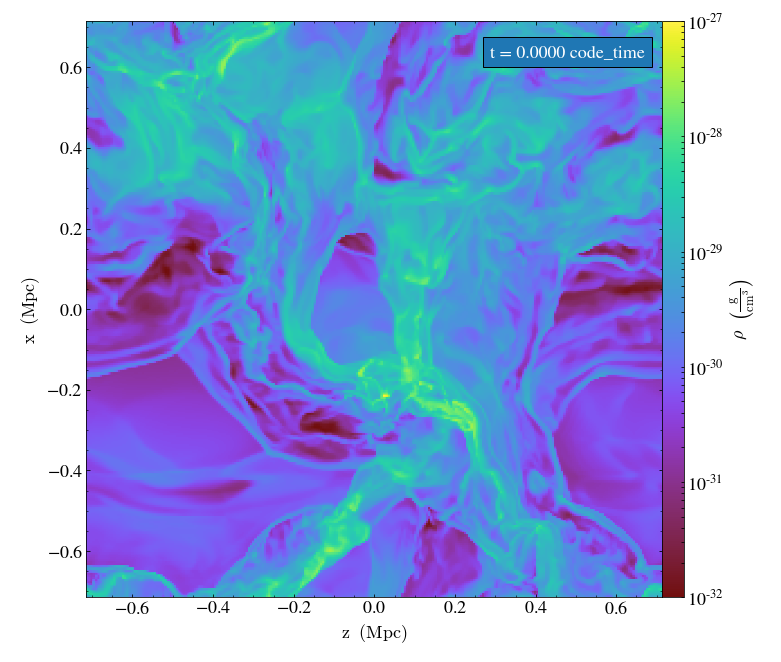

yt : [INFO     ] 2019-04-16 11:28:46,588 Saving plot Data_000011_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:47,492 Parameters: current_time              = 1.0000028609136235e-05
yt : [INFO     ] 2019-04-16 11:28:47,493 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:47,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:47,495 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:47,496 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:47,497 Parameters: current_redshift          = 99998.71390945613
yt : [INFO     ] 2019-04-16 11:28:47,498 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:47,498 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:47,499 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:50,124 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


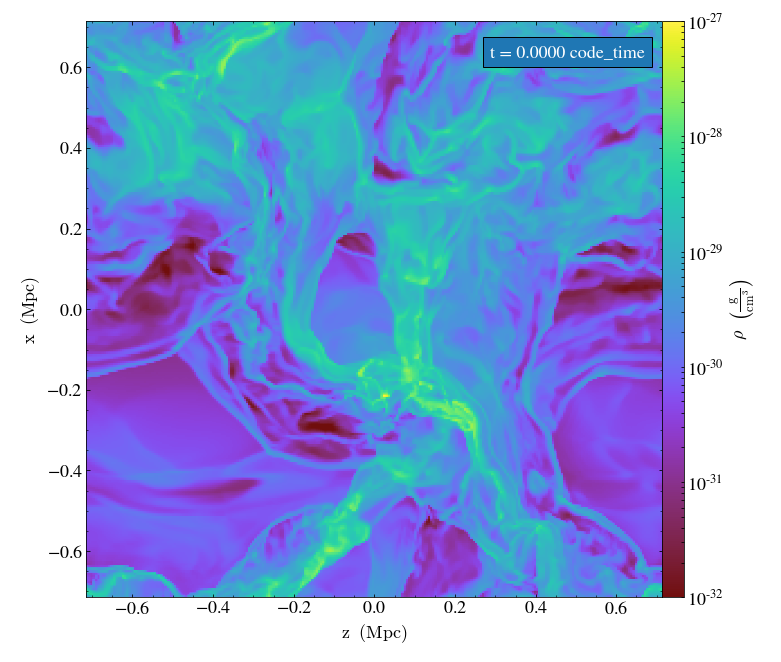

yt : [INFO     ] 2019-04-16 11:28:51,098 Saving plot Data_000012_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:51,977 Parameters: current_time              = 1.000003137187395e-05
yt : [INFO     ] 2019-04-16 11:28:51,978 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:51,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:51,980 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:51,981 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:51,982 Parameters: current_redshift          = 99998.6862822447
yt : [INFO     ] 2019-04-16 11:28:51,982 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:51,983 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:51,984 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:54,634 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 1


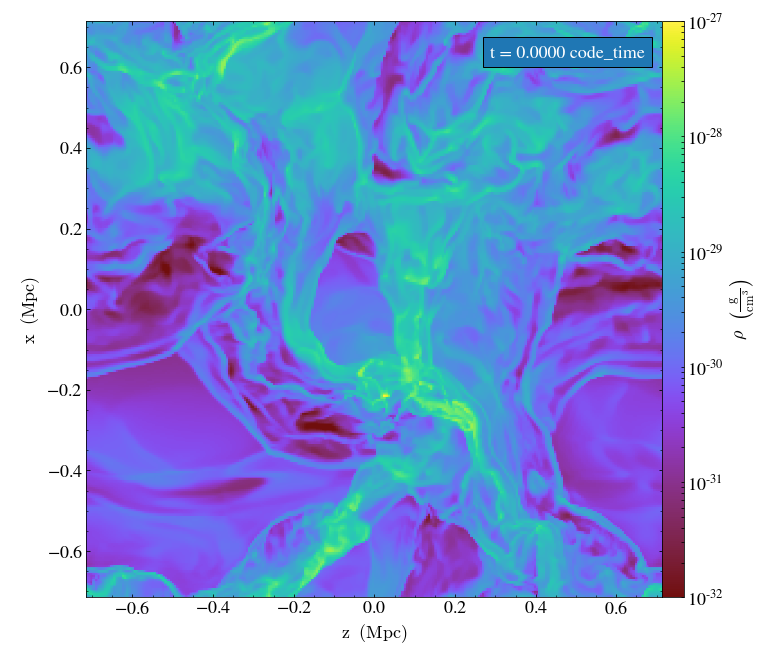

yt : [INFO     ] 2019-04-16 11:28:55,717 Saving plot Data_000013_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:28:56,608 Parameters: current_time              = 1.0000034186532752e-05
yt : [INFO     ] 2019-04-16 11:28:56,609 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:28:56,610 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:28:56,611 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:28:56,612 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:28:56,613 Parameters: current_redshift          = 99998.6581358412
yt : [INFO     ] 2019-04-16 11:28:56,614 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:28:56,615 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:28:56,615 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:28:59,297 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


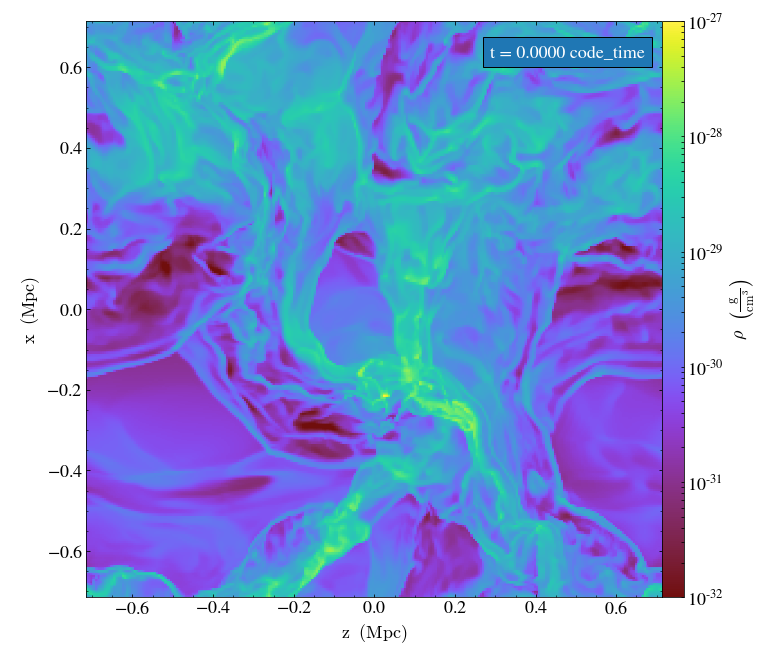

yt : [INFO     ] 2019-04-16 11:29:00,245 Saving plot Data_000014_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:01,176 Parameters: current_time              = 1.000003701333829e-05
yt : [INFO     ] 2019-04-16 11:29:01,177 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:01,178 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:01,179 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:01,180 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:01,181 Parameters: current_redshift          = 99998.6298679871
yt : [INFO     ] 2019-04-16 11:29:01,182 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:01,183 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:01,183 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:03,654 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 1


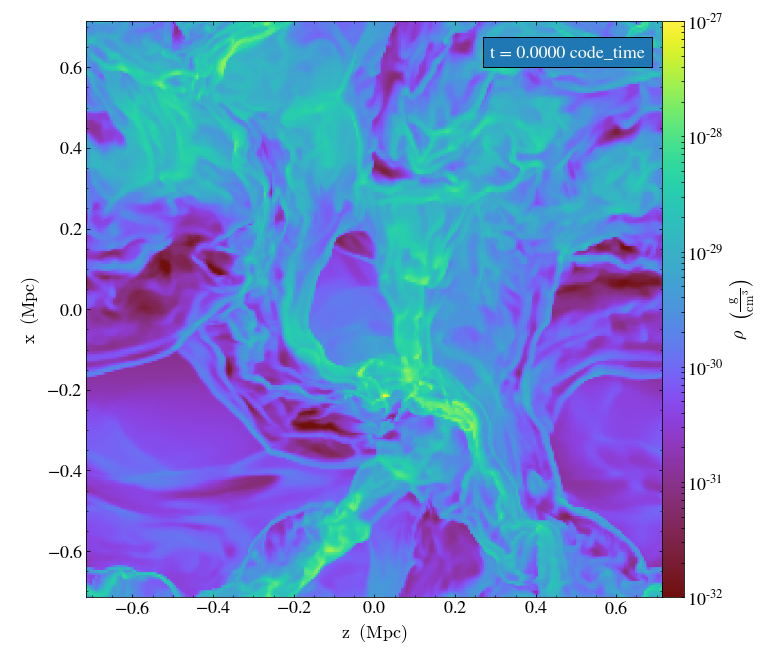

yt : [INFO     ] 2019-04-16 11:29:04,627 Saving plot Data_000015_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:05,546 Parameters: current_time              = 1.0000037753940052e-05
yt : [INFO     ] 2019-04-16 11:29:05,547 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:05,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:05,549 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:05,550 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:05,550 Parameters: current_redshift          = 99998.62246202482
yt : [INFO     ] 2019-04-16 11:29:05,551 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:05,552 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:05,553 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:08,422 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


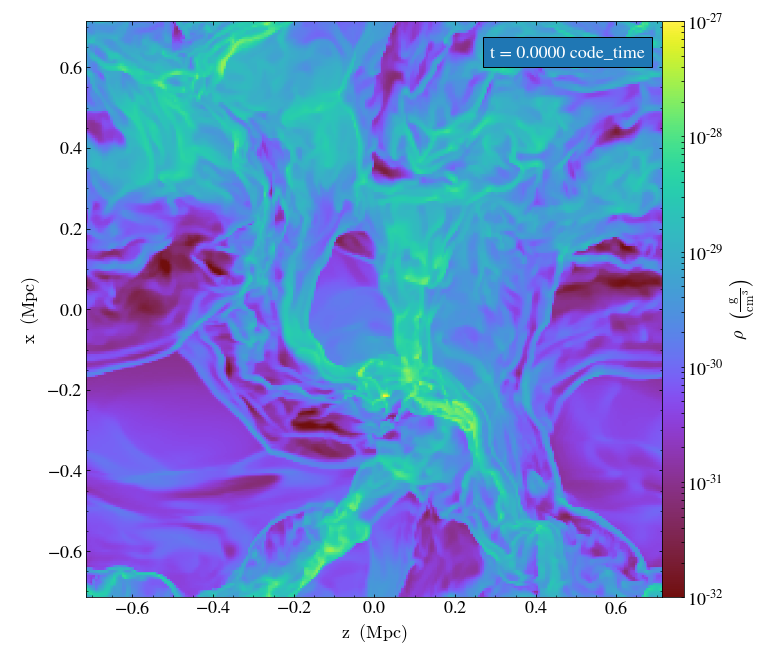

yt : [INFO     ] 2019-04-16 11:29:09,733 Saving plot Data_000016_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:10,615 Parameters: current_time              = 1.0000039152770795e-05
yt : [INFO     ] 2019-04-16 11:29:10,616 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:10,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:10,618 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:10,619 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:10,619 Parameters: current_redshift          = 99998.60847382498
yt : [INFO     ] 2019-04-16 11:29:10,620 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:10,621 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:10,622 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:13,060 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


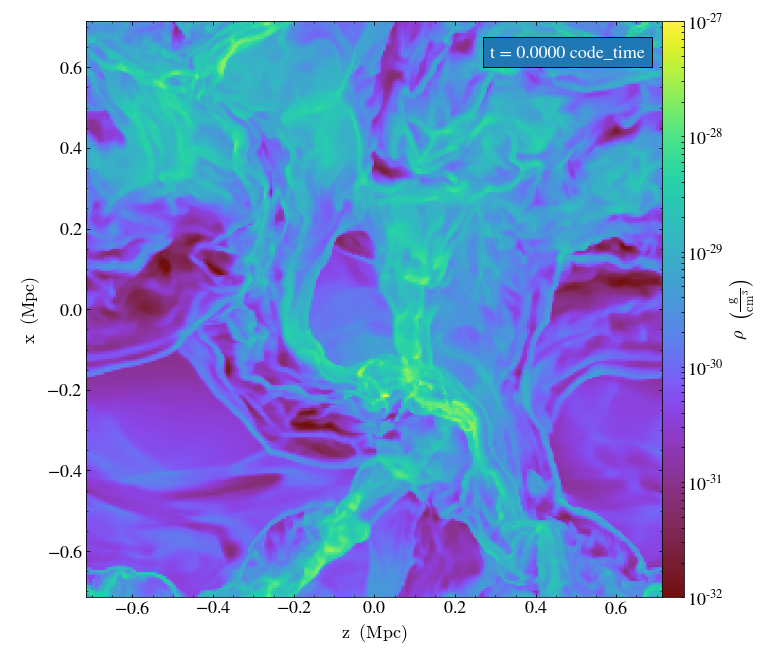

yt : [INFO     ] 2019-04-16 11:29:14,006 Saving plot Data_000017_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:14,859 Parameters: current_time              = 1.000004168591186e-05
yt : [INFO     ] 2019-04-16 11:29:14,860 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:14,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:14,861 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:14,862 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:14,863 Parameters: current_redshift          = 99998.58314261911
yt : [INFO     ] 2019-04-16 11:29:14,864 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:14,865 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:14,866 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:17,558 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


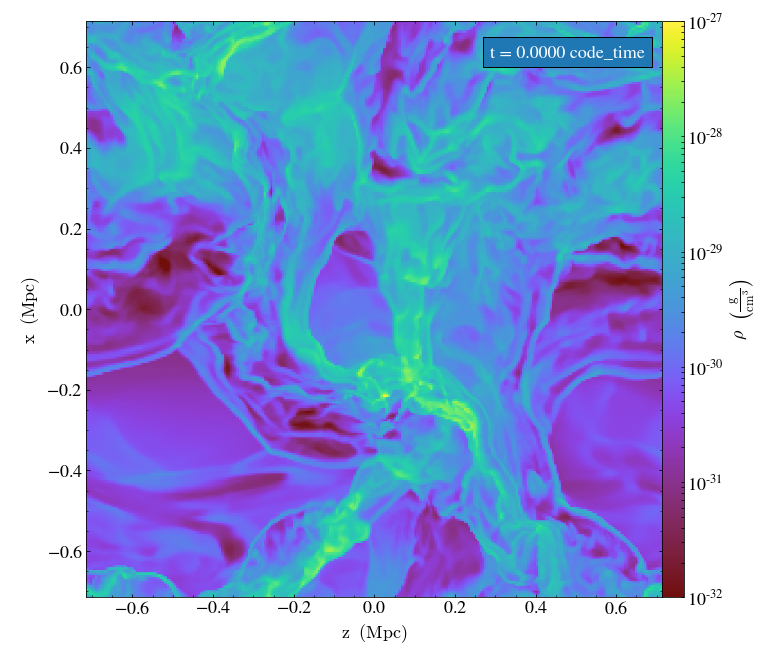

yt : [INFO     ] 2019-04-16 11:29:18,531 Saving plot Data_000018_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:19,284 Parameters: current_time              = 1.000004407615372e-05
yt : [INFO     ] 2019-04-16 11:29:19,285 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:19,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:19,287 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:19,288 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:19,288 Parameters: current_redshift          = 99998.5592404055
yt : [INFO     ] 2019-04-16 11:29:19,289 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:19,290 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:19,291 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:21,864 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 1


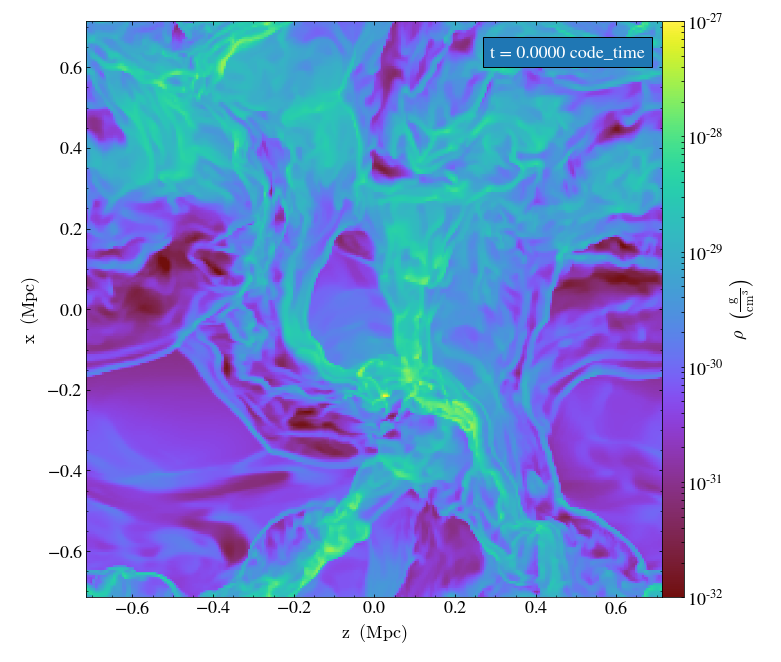

yt : [INFO     ] 2019-04-16 11:29:22,819 Saving plot Data_000019_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:23,698 Parameters: current_time              = 1.0000045590564961e-05
yt : [INFO     ] 2019-04-16 11:29:23,700 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:23,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:23,702 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:23,703 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:23,704 Parameters: current_redshift          = 99998.54409642887
yt : [INFO     ] 2019-04-16 11:29:23,705 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:23,705 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:23,706 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:26,528 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


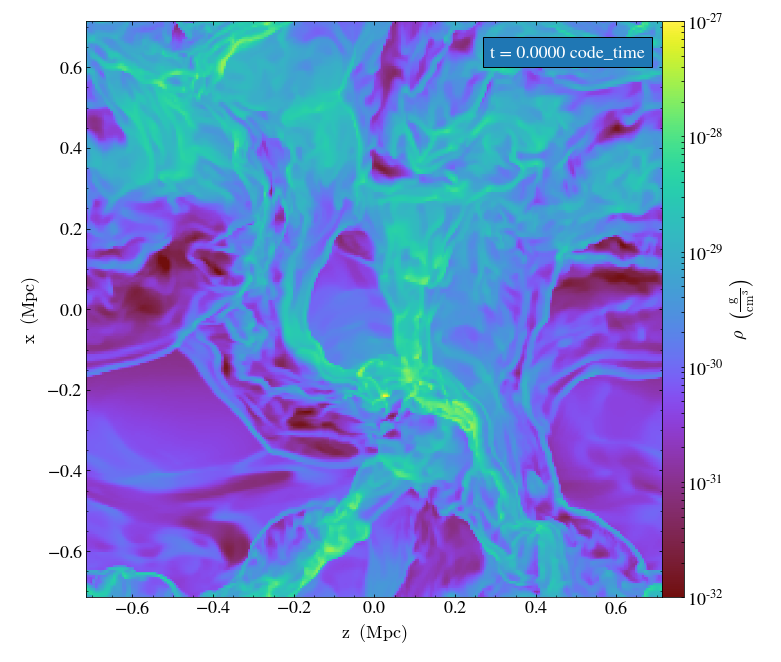

yt : [INFO     ] 2019-04-16 11:29:27,558 Saving plot Data_000020_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:28,397 Parameters: current_time              = 1.0000047180421241e-05
yt : [INFO     ] 2019-04-16 11:29:28,398 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:28,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:28,400 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:28,401 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:28,402 Parameters: current_redshift          = 99998.52819801358
yt : [INFO     ] 2019-04-16 11:29:28,403 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:28,403 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:28,404 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:31,213 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


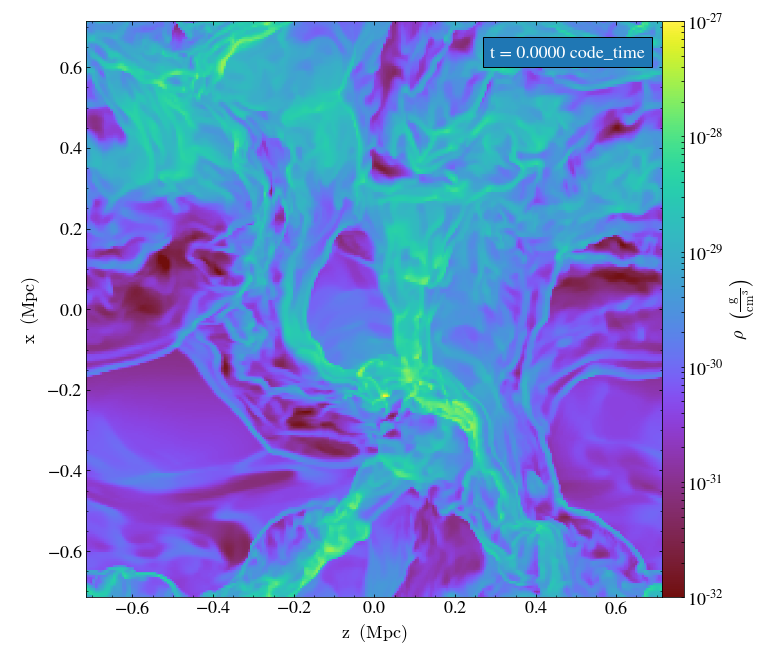

yt : [INFO     ] 2019-04-16 11:29:32,206 Saving plot Data_000021_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:33,095 Parameters: current_time              = 1.0000049420549683e-05
yt : [INFO     ] 2019-04-16 11:29:33,096 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:33,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:33,098 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:33,099 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:33,100 Parameters: current_redshift          = 99998.50579694555
yt : [INFO     ] 2019-04-16 11:29:33,100 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:33,101 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:33,102 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:35,757 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


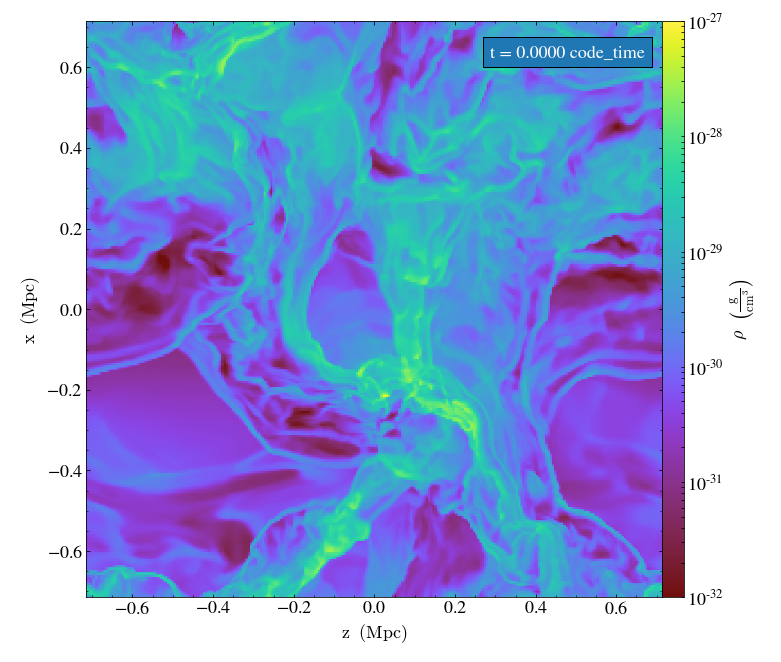

yt : [INFO     ] 2019-04-16 11:29:36,759 Saving plot Data_000022_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:37,695 Parameters: current_time              = 1.0000052154802992e-05
yt : [INFO     ] 2019-04-16 11:29:37,696 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:37,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:37,698 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:37,699 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:37,699 Parameters: current_redshift          = 99998.47845469018
yt : [INFO     ] 2019-04-16 11:29:37,700 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:37,701 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:37,702 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:40,320 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


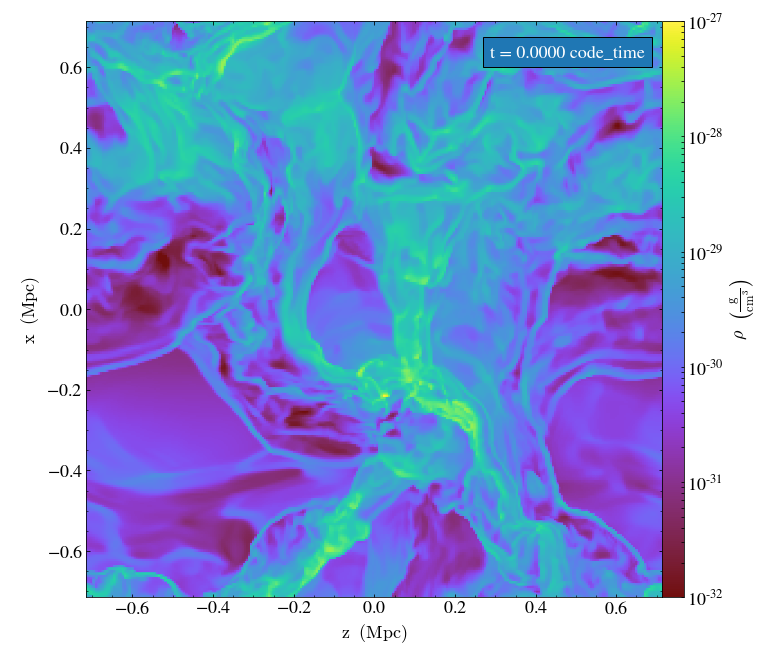

yt : [INFO     ] 2019-04-16 11:29:41,328 Saving plot Data_000023_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:42,209 Parameters: current_time              = 1.00000552570001e-05
yt : [INFO     ] 2019-04-16 11:29:42,210 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:42,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:42,212 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:42,213 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:42,214 Parameters: current_redshift          = 99998.44743305231
yt : [INFO     ] 2019-04-16 11:29:42,214 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:42,215 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:42,216 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:45,132 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 1


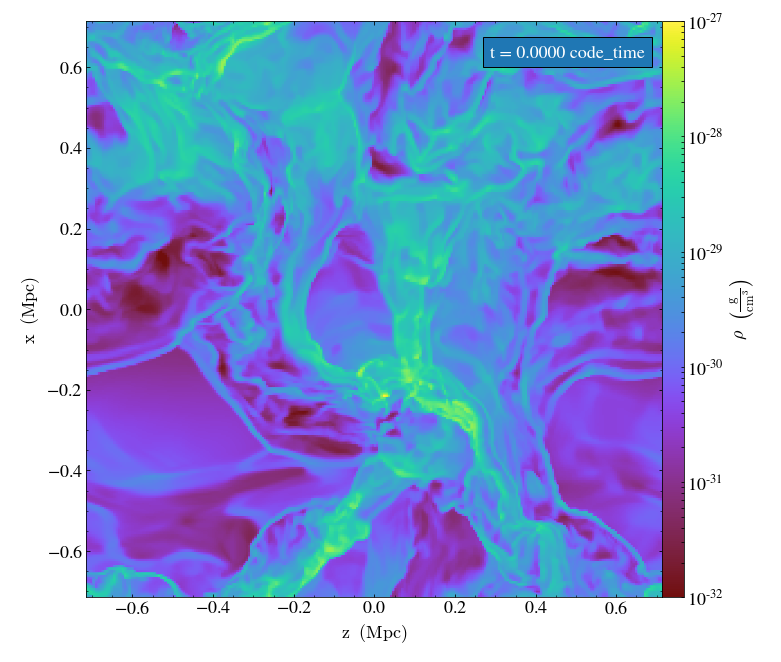

yt : [INFO     ] 2019-04-16 11:29:46,095 Saving plot Data_000024_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:46,981 Parameters: current_time              = 1.000005848354726e-05
yt : [INFO     ] 2019-04-16 11:29:46,982 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:46,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:46,984 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:46,985 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:46,985 Parameters: current_redshift          = 99998.4151679477
yt : [INFO     ] 2019-04-16 11:29:46,986 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:46,987 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:46,988 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:49,702 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 1


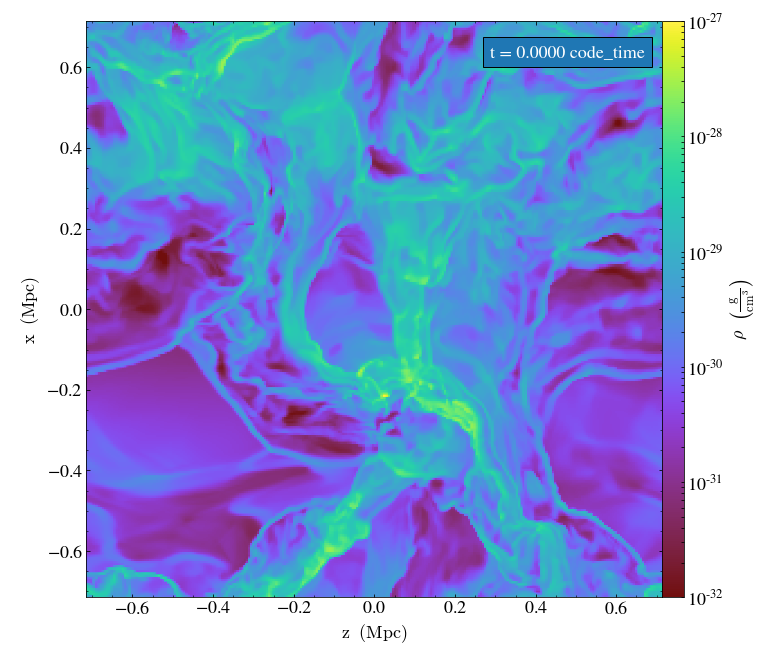

yt : [INFO     ] 2019-04-16 11:29:50,711 Saving plot Data_000025_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:51,614 Parameters: current_time              = 1.000006162492747e-05
yt : [INFO     ] 2019-04-16 11:29:51,615 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:51,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:51,617 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:51,618 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:51,619 Parameters: current_redshift          = 99998.3837545229
yt : [INFO     ] 2019-04-16 11:29:51,620 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:51,620 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:51,621 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:54,253 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 1


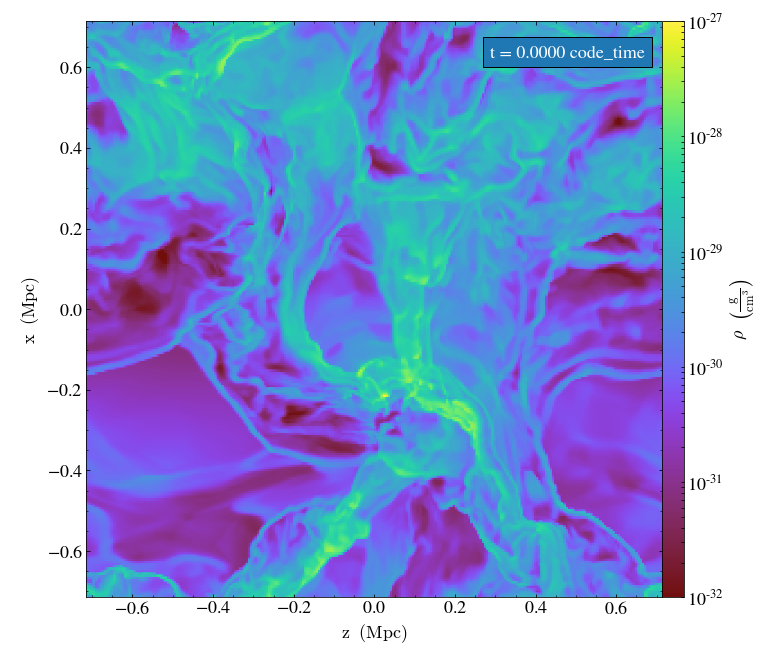

yt : [INFO     ] 2019-04-16 11:29:55,215 Saving plot Data_000026_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:29:56,004 Parameters: current_time              = 1.0000064623114496e-05
yt : [INFO     ] 2019-04-16 11:29:56,005 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:29:56,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:29:56,006 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:29:56,007 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:29:56,008 Parameters: current_redshift          = 99998.35377303115
yt : [INFO     ] 2019-04-16 11:29:56,009 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:29:56,010 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:29:56,010 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:29:58,729 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


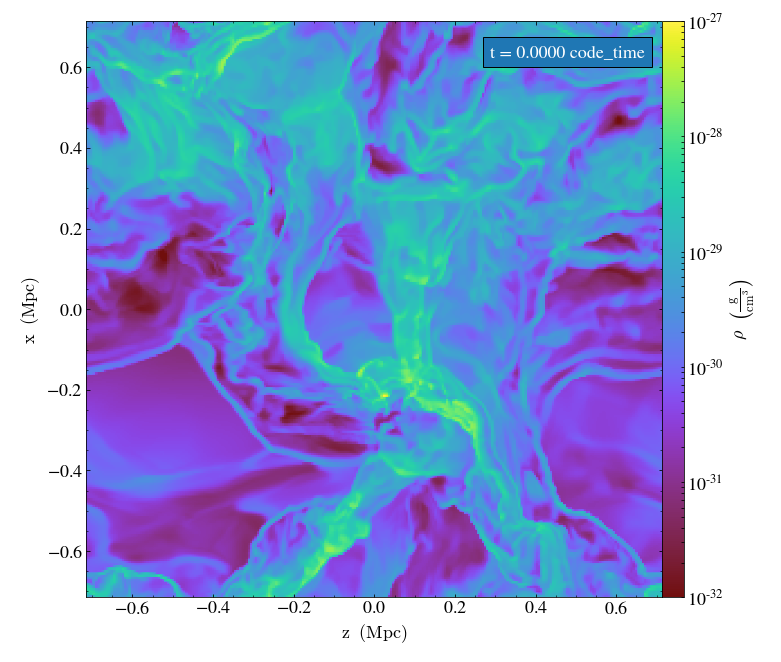

yt : [INFO     ] 2019-04-16 11:29:59,676 Saving plot Data_000027_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:00,503 Parameters: current_time              = 1.0000067771585763e-05
yt : [INFO     ] 2019-04-16 11:30:00,505 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:00,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:00,507 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:00,508 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:00,509 Parameters: current_redshift          = 99998.32228873532
yt : [INFO     ] 2019-04-16 11:30:00,509 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:00,510 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:00,511 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:03,343 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


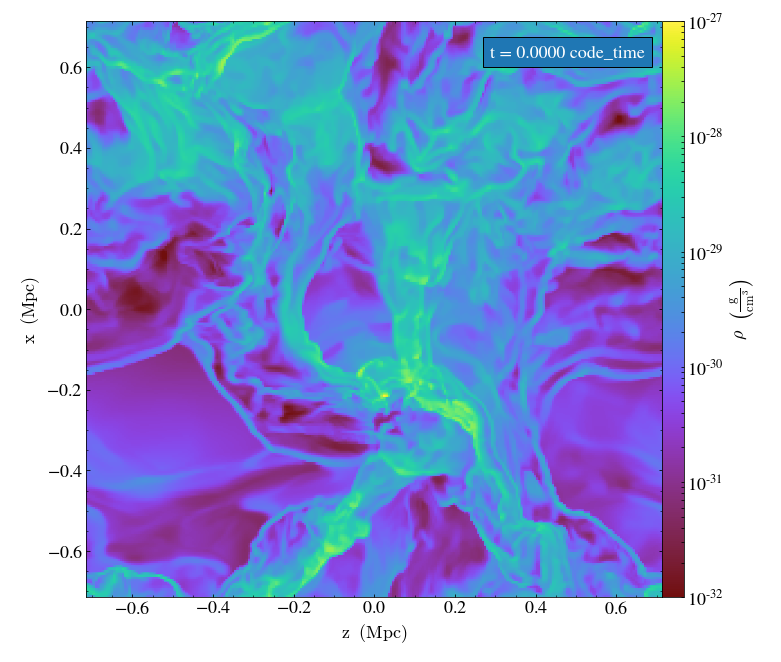

yt : [INFO     ] 2019-04-16 11:30:04,427 Saving plot Data_000028_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:05,389 Parameters: current_time              = 1.0000071025148566e-05
yt : [INFO     ] 2019-04-16 11:30:05,390 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:05,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:05,392 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:05,392 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:05,393 Parameters: current_redshift          = 99998.28975355887
yt : [INFO     ] 2019-04-16 11:30:05,393 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:05,393 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:05,394 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:08,038 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


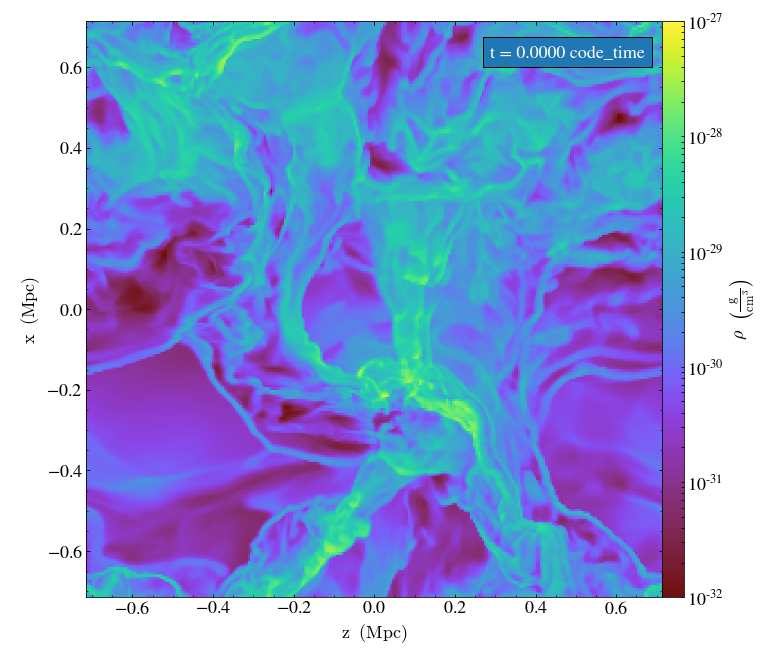

yt : [INFO     ] 2019-04-16 11:30:09,040 Saving plot Data_000029_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:09,894 Parameters: current_time              = 1.0000072474237589e-05
yt : [INFO     ] 2019-04-16 11:30:09,895 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:09,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:09,897 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:09,898 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:09,899 Parameters: current_redshift          = 99998.27526287659
yt : [INFO     ] 2019-04-16 11:30:09,899 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:09,900 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:09,901 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:12,666 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


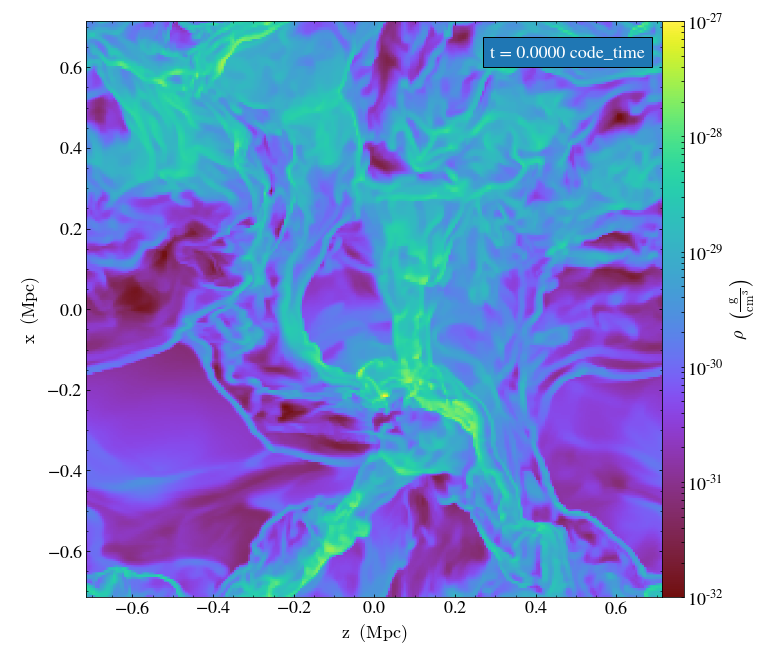

yt : [INFO     ] 2019-04-16 11:30:13,645 Saving plot Data_000030_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:14,619 Parameters: current_time              = 1.0000074226105853e-05
yt : [INFO     ] 2019-04-16 11:30:14,620 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:14,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:14,622 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:14,623 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:14,624 Parameters: current_redshift          = 99998.25774445094
yt : [INFO     ] 2019-04-16 11:30:14,624 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:14,625 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:14,626 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:17,389 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


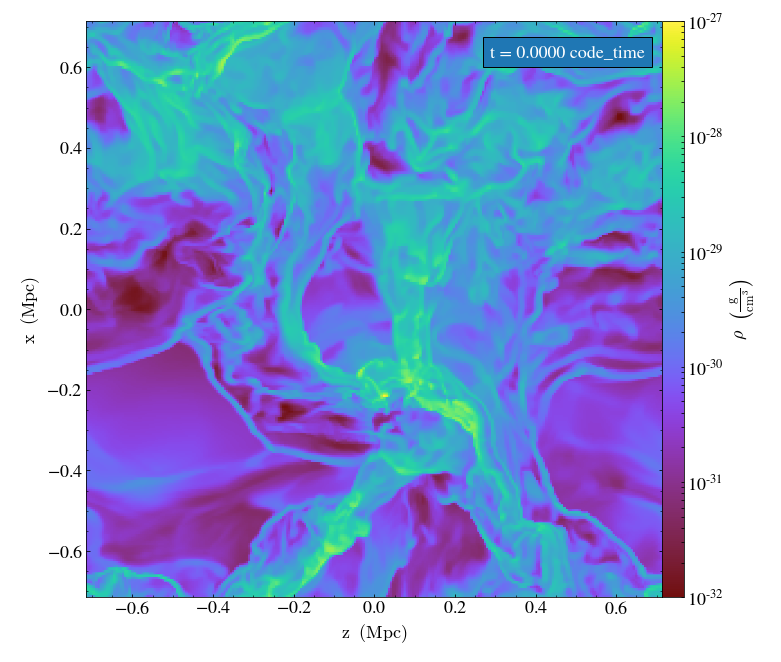

yt : [INFO     ] 2019-04-16 11:30:18,379 Saving plot Data_000031_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:19,195 Parameters: current_time              = 1.0000075824755033e-05
yt : [INFO     ] 2019-04-16 11:30:19,196 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:19,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:19,198 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:19,199 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:19,200 Parameters: current_redshift          = 99998.24175819902
yt : [INFO     ] 2019-04-16 11:30:19,200 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:19,201 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:19,202 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:22,006 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


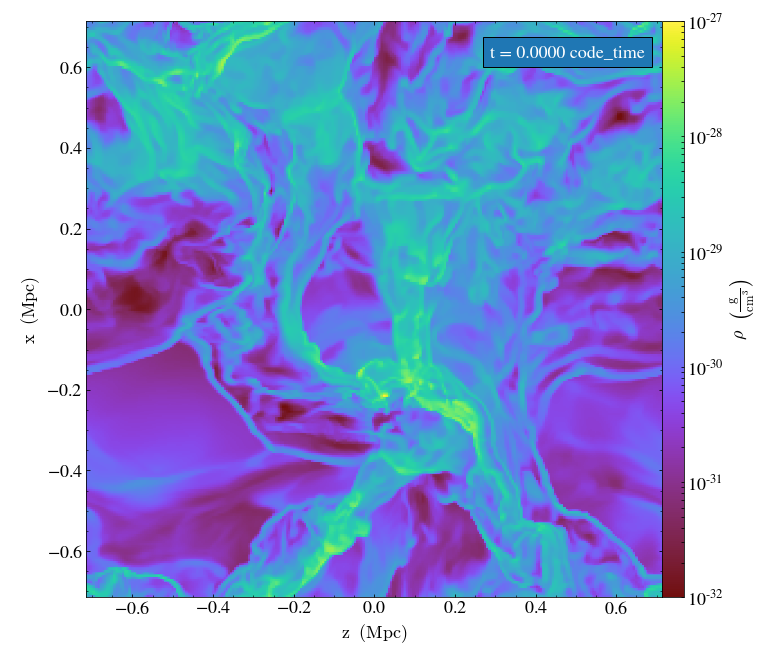

yt : [INFO     ] 2019-04-16 11:30:22,969 Saving plot Data_000032_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:23,727 Parameters: current_time              = 1.0000078278083824e-05
yt : [INFO     ] 2019-04-16 11:30:23,728 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:23,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:23,730 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:23,731 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:23,732 Parameters: current_redshift          = 99998.21722528916
yt : [INFO     ] 2019-04-16 11:30:23,732 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:23,733 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:23,734 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:26,554 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


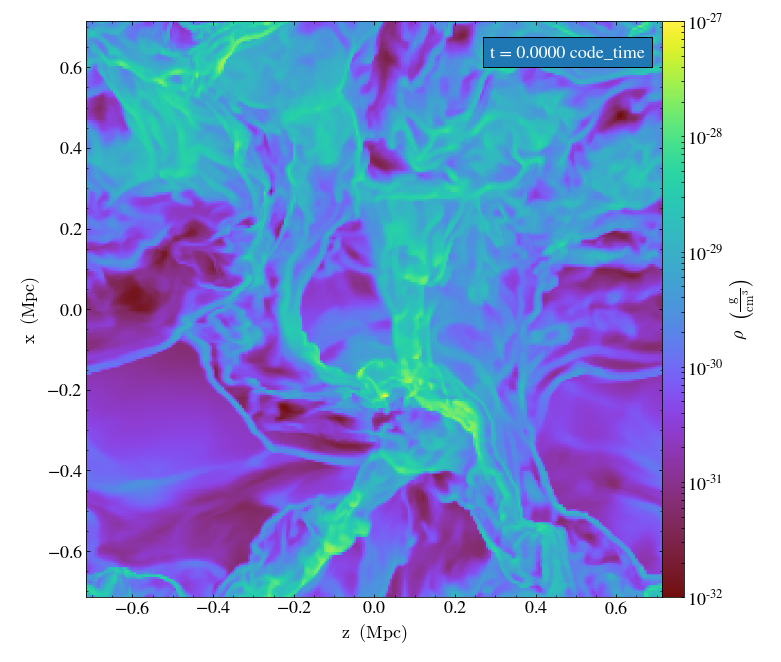

yt : [INFO     ] 2019-04-16 11:30:27,497 Saving plot Data_000033_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:28,323 Parameters: current_time              = 1.0000080905439758e-05
yt : [INFO     ] 2019-04-16 11:30:28,323 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:28,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:28,326 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:28,326 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:28,327 Parameters: current_redshift          = 99998.19095214806
yt : [INFO     ] 2019-04-16 11:30:28,328 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:28,329 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:28,330 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:31,051 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


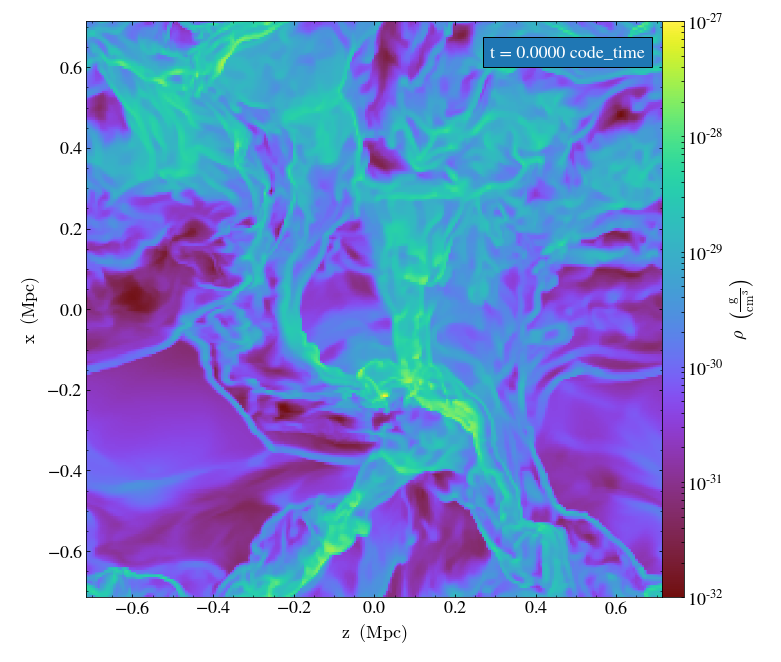

yt : [INFO     ] 2019-04-16 11:30:31,999 Saving plot Data_000034_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:32,898 Parameters: current_time              = 1.0000083372281348e-05
yt : [INFO     ] 2019-04-16 11:30:32,899 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:32,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:32,901 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:32,903 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:32,903 Parameters: current_redshift          = 99998.1662841374
yt : [INFO     ] 2019-04-16 11:30:32,904 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:32,905 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:32,906 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:35,555 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


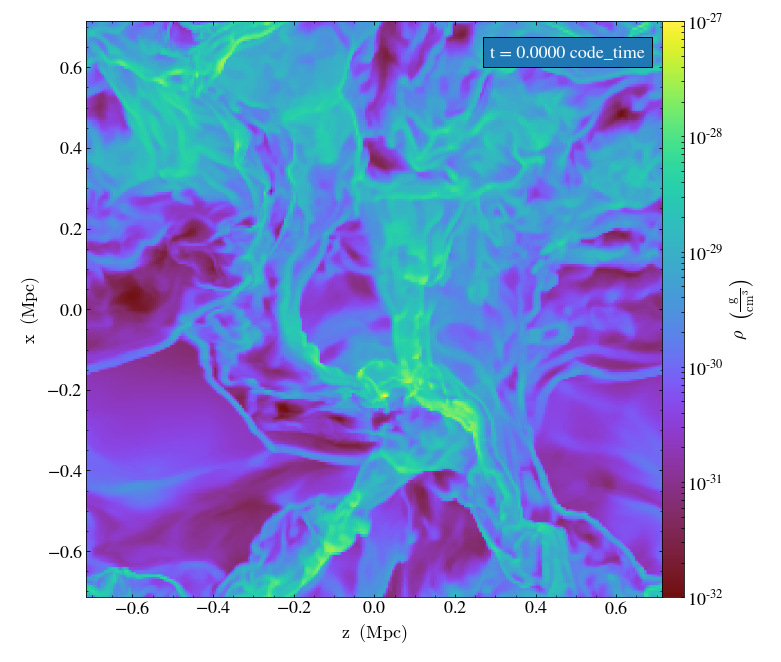

yt : [INFO     ] 2019-04-16 11:30:36,558 Saving plot Data_000035_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:37,461 Parameters: current_time              = 1.000008640774803e-05
yt : [INFO     ] 2019-04-16 11:30:37,462 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:37,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:37,464 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:37,465 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:37,466 Parameters: current_redshift          = 99998.13592998593
yt : [INFO     ] 2019-04-16 11:30:37,466 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:37,467 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:37,468 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:39,962 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


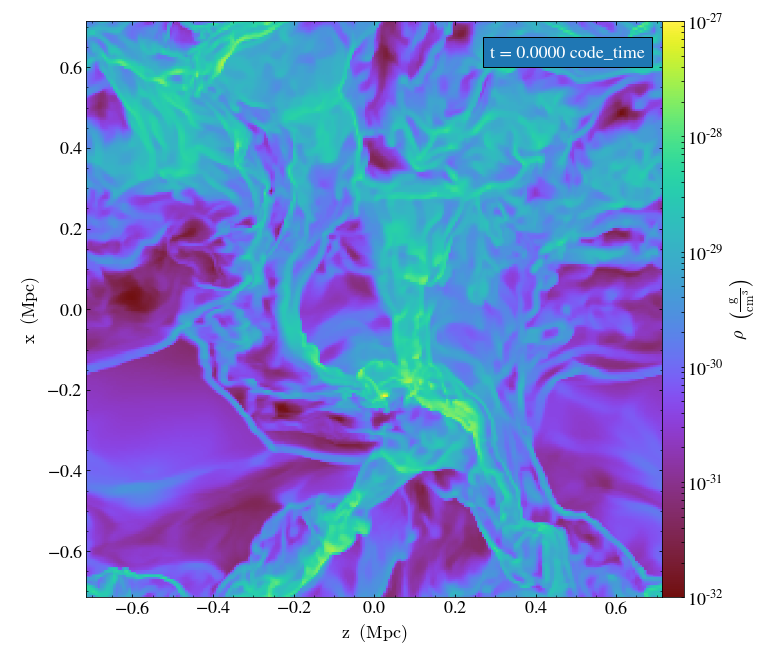

yt : [INFO     ] 2019-04-16 11:30:40,942 Saving plot Data_000036_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:41,839 Parameters: current_time              = 1.0000089097449407e-05
yt : [INFO     ] 2019-04-16 11:30:41,840 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:41,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:41,842 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:41,843 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:41,844 Parameters: current_redshift          = 99998.10903344421
yt : [INFO     ] 2019-04-16 11:30:41,845 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:41,845 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:41,846 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:44,522 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


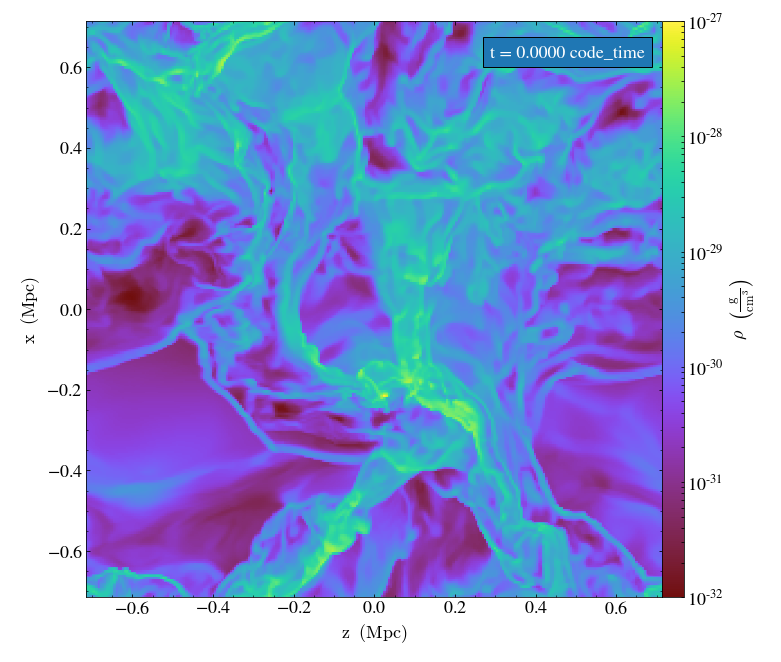

yt : [INFO     ] 2019-04-16 11:30:45,474 Saving plot Data_000037_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:46,414 Parameters: current_time              = 1.000009210180005e-05
yt : [INFO     ] 2019-04-16 11:30:46,415 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:46,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:46,417 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:46,418 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:46,419 Parameters: current_redshift          = 99998.07899048216
yt : [INFO     ] 2019-04-16 11:30:46,420 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:46,420 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:46,421 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:49,077 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


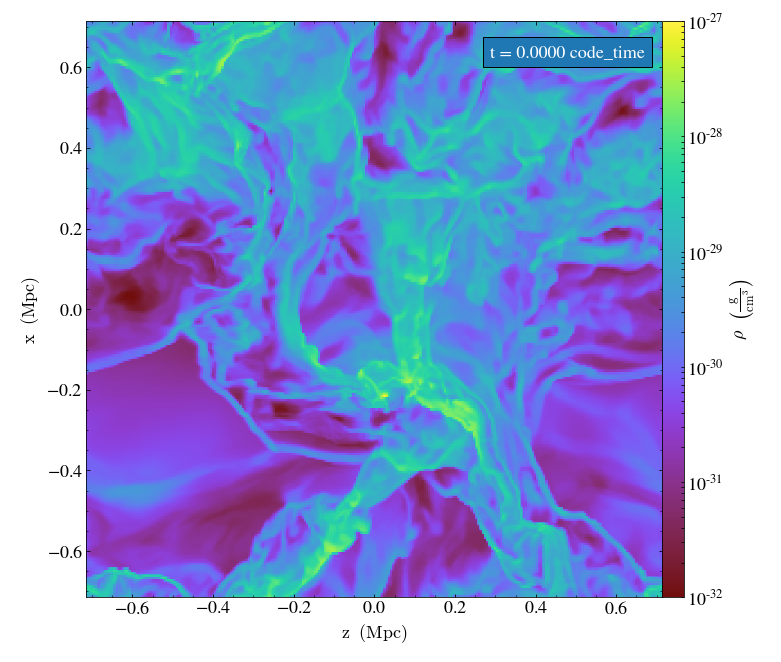

yt : [INFO     ] 2019-04-16 11:30:50,059 Saving plot Data_000038_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:50,947 Parameters: current_time              = 1.0000095522063918e-05
yt : [INFO     ] 2019-04-16 11:30:50,948 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:50,949 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:50,949 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:50,950 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:50,951 Parameters: current_redshift          = 99998.0447884852
yt : [INFO     ] 2019-04-16 11:30:50,952 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:50,952 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:50,953 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:53,839 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


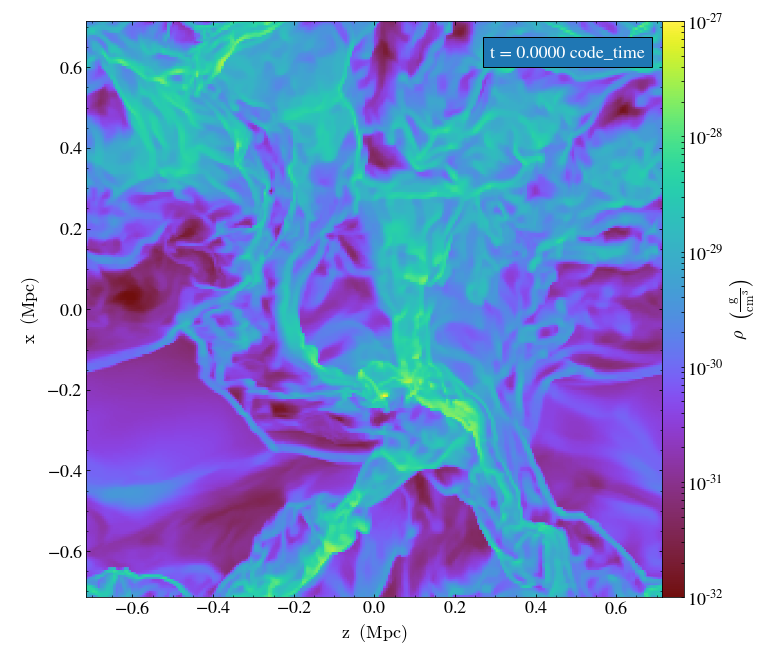

yt : [INFO     ] 2019-04-16 11:30:54,845 Saving plot Data_000039_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:30:55,701 Parameters: current_time              = 1.000009865224779e-05
yt : [INFO     ] 2019-04-16 11:30:55,702 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:30:55,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:30:55,704 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:30:55,704 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:30:55,705 Parameters: current_redshift          = 99998.01348725428
yt : [INFO     ] 2019-04-16 11:30:55,706 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:30:55,707 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:30:55,707 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:30:58,452 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


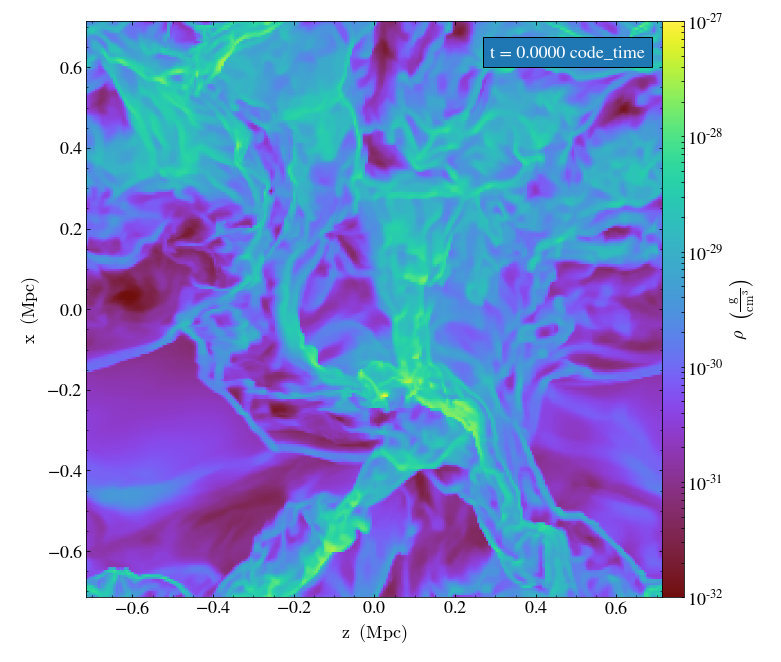

yt : [INFO     ] 2019-04-16 11:30:59,436 Saving plot Data_000040_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:00,346 Parameters: current_time              = 1.000010229626696e-05
yt : [INFO     ] 2019-04-16 11:31:00,347 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:00,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:00,349 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:00,350 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:00,350 Parameters: current_redshift          = 99997.97704779482
yt : [INFO     ] 2019-04-16 11:31:00,351 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:00,352 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:00,353 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:02,944 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


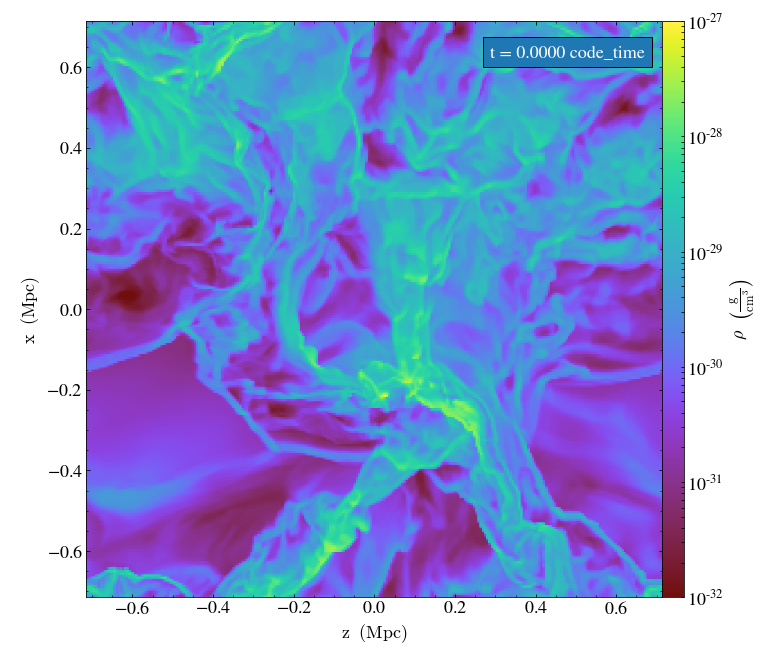

yt : [INFO     ] 2019-04-16 11:31:03,901 Saving plot Data_000041_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:04,750 Parameters: current_time              = 1.0000107044259798e-05
yt : [INFO     ] 2019-04-16 11:31:04,751 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:04,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:04,753 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:04,754 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:04,755 Parameters: current_redshift          = 99997.92956886037
yt : [INFO     ] 2019-04-16 11:31:04,755 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:04,756 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:04,757 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:07,347 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


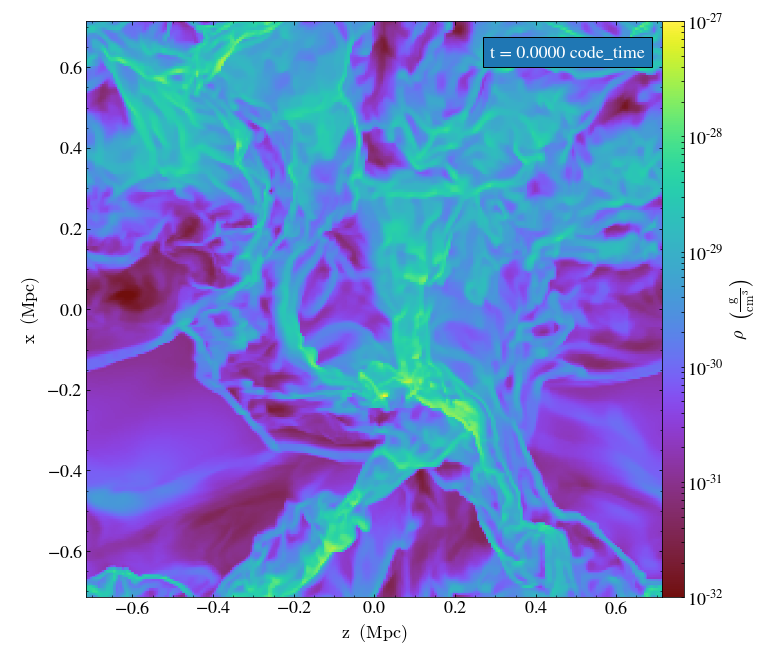

yt : [INFO     ] 2019-04-16 11:31:08,356 Saving plot Data_000042_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:09,176 Parameters: current_time              = 1.00001121414353e-05
yt : [INFO     ] 2019-04-16 11:31:09,178 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:09,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:09,180 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:09,181 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:09,182 Parameters: current_redshift          = 99997.87859822255
yt : [INFO     ] 2019-04-16 11:31:09,183 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:09,184 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:09,185 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:11,663 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 1


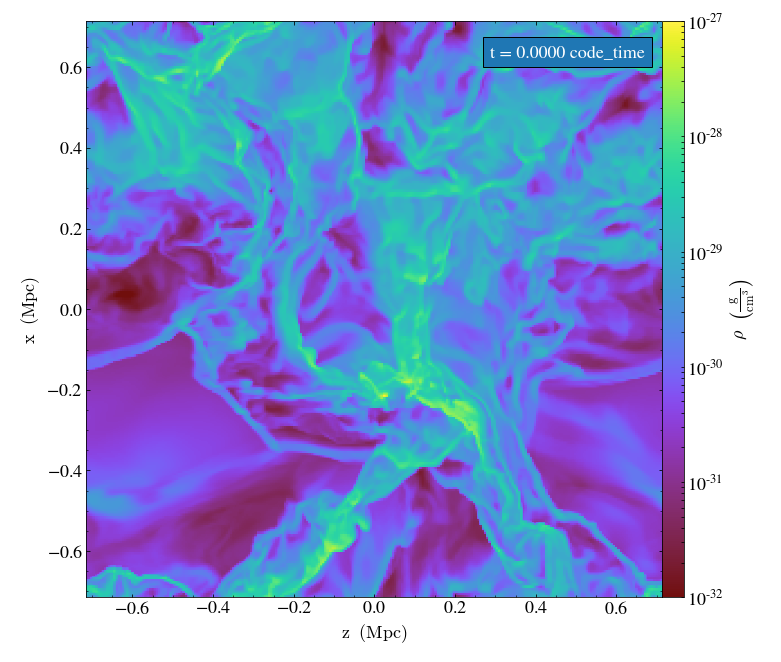

yt : [INFO     ] 2019-04-16 11:31:12,630 Saving plot Data_000043_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:13,440 Parameters: current_time              = 1.0000117436541644e-05
yt : [INFO     ] 2019-04-16 11:31:13,441 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:13,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:13,443 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:13,444 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:13,444 Parameters: current_redshift          = 99997.82564837474
yt : [INFO     ] 2019-04-16 11:31:13,445 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:13,446 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:13,447 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:16,087 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


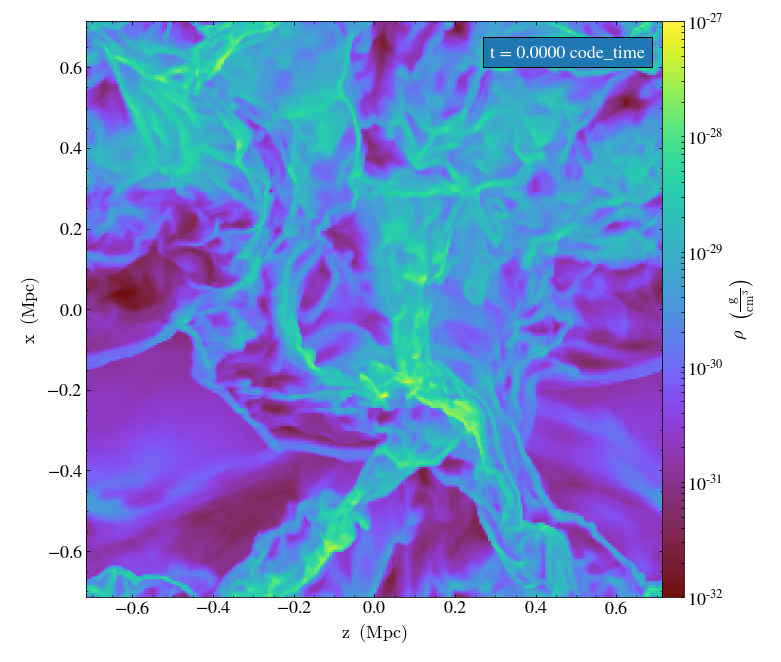

yt : [INFO     ] 2019-04-16 11:31:17,409 Saving plot Data_000044_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:18,251 Parameters: current_time              = 1.0000122348206049e-05
yt : [INFO     ] 2019-04-16 11:31:18,252 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:18,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:18,254 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:18,255 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:18,256 Parameters: current_redshift          = 99997.7765329084
yt : [INFO     ] 2019-04-16 11:31:18,256 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:18,257 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:18,258 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:20,757 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


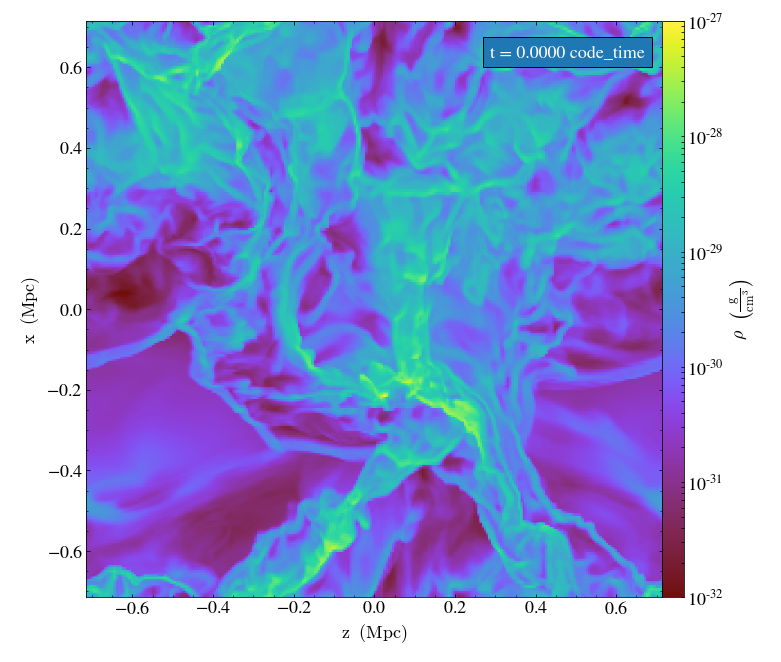

yt : [INFO     ] 2019-04-16 11:31:21,761 Saving plot Data_000045_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:22,635 Parameters: current_time              = 1.0000128105914324e-05
yt : [INFO     ] 2019-04-16 11:31:22,636 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:22,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:22,638 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:22,639 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:22,640 Parameters: current_redshift          = 99997.71895726767
yt : [INFO     ] 2019-04-16 11:31:22,640 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:22,641 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:22,642 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:25,291 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


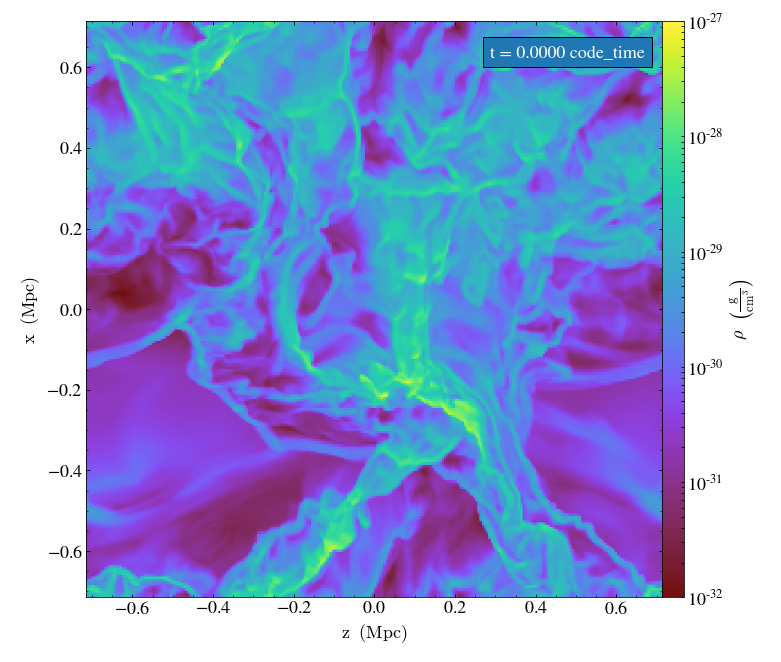

yt : [INFO     ] 2019-04-16 11:31:26,250 Saving plot Data_000046_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:27,023 Parameters: current_time              = 1.0000133807383797e-05
yt : [INFO     ] 2019-04-16 11:31:27,024 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:27,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:27,025 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:27,026 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:27,027 Parameters: current_redshift          = 99997.6619440662
yt : [INFO     ] 2019-04-16 11:31:27,028 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:27,029 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:27,029 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:29,651 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


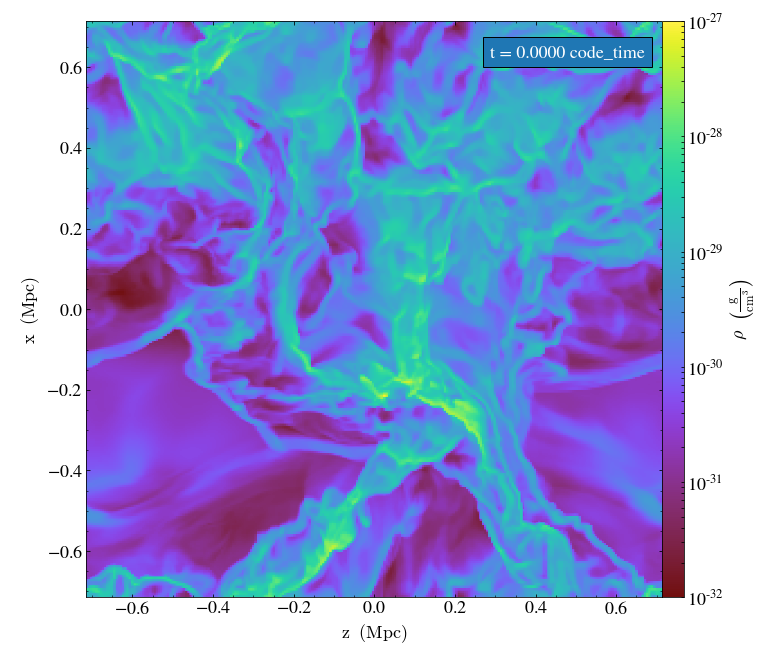

yt : [INFO     ] 2019-04-16 11:31:30,609 Saving plot Data_000047_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:31,517 Parameters: current_time              = 1.0000138808037902e-05
yt : [INFO     ] 2019-04-16 11:31:31,519 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:31,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:31,521 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:31,522 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:31,522 Parameters: current_redshift          = 99997.61193888838
yt : [INFO     ] 2019-04-16 11:31:31,523 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:31,524 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:31,525 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:34,015 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


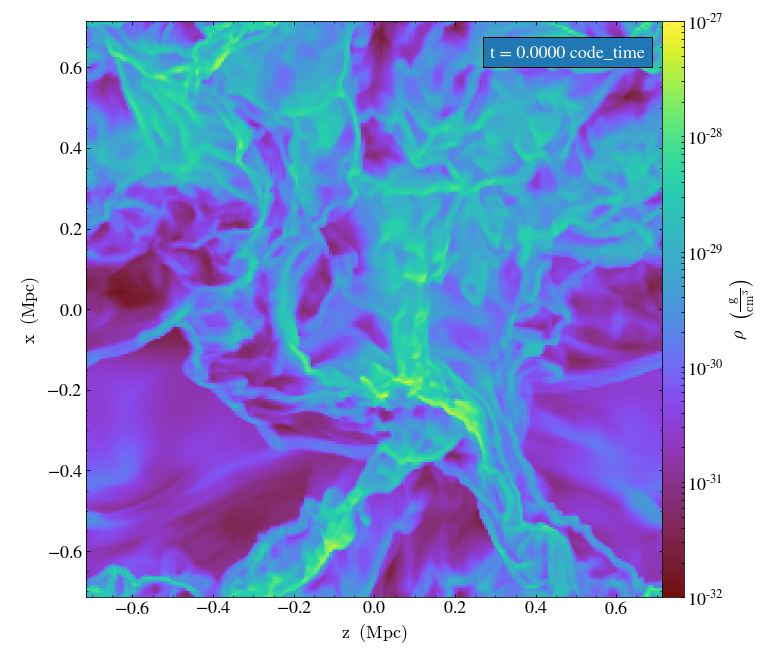

yt : [INFO     ] 2019-04-16 11:31:34,981 Saving plot Data_000048_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:35,852 Parameters: current_time              = 1.0000144258103253e-05
yt : [INFO     ] 2019-04-16 11:31:35,853 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:35,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:35,855 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:35,856 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:35,857 Parameters: current_redshift          = 99997.55743977758
yt : [INFO     ] 2019-04-16 11:31:35,858 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:35,858 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:35,859 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:38,846 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


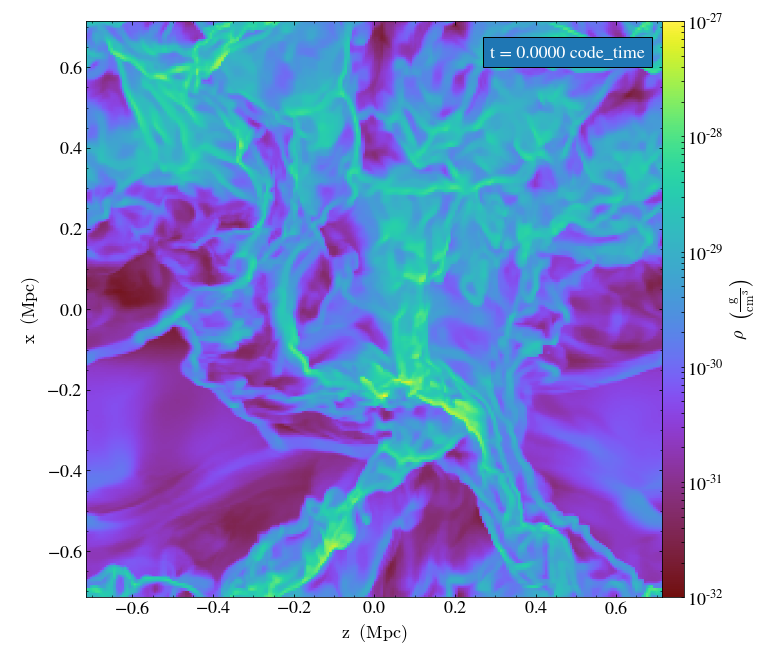

yt : [INFO     ] 2019-04-16 11:31:39,826 Saving plot Data_000049_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:40,688 Parameters: current_time              = 1.0000149767940558e-05
yt : [INFO     ] 2019-04-16 11:31:40,689 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:40,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:40,691 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:40,692 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:40,693 Parameters: current_redshift          = 99997.50234302452
yt : [INFO     ] 2019-04-16 11:31:40,694 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:40,694 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:40,695 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:43,451 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


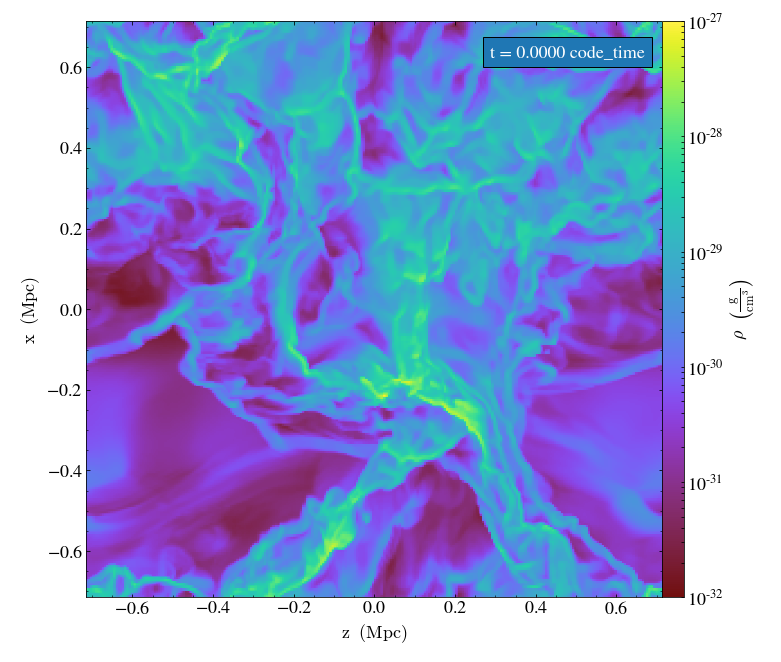

yt : [INFO     ] 2019-04-16 11:31:44,449 Saving plot Data_000050_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:45,321 Parameters: current_time              = 1.0000155139598693e-05
yt : [INFO     ] 2019-04-16 11:31:45,322 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:45,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:45,324 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:45,325 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:45,325 Parameters: current_redshift          = 99997.448628081
yt : [INFO     ] 2019-04-16 11:31:45,326 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:45,327 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:45,327 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:48,087 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 1


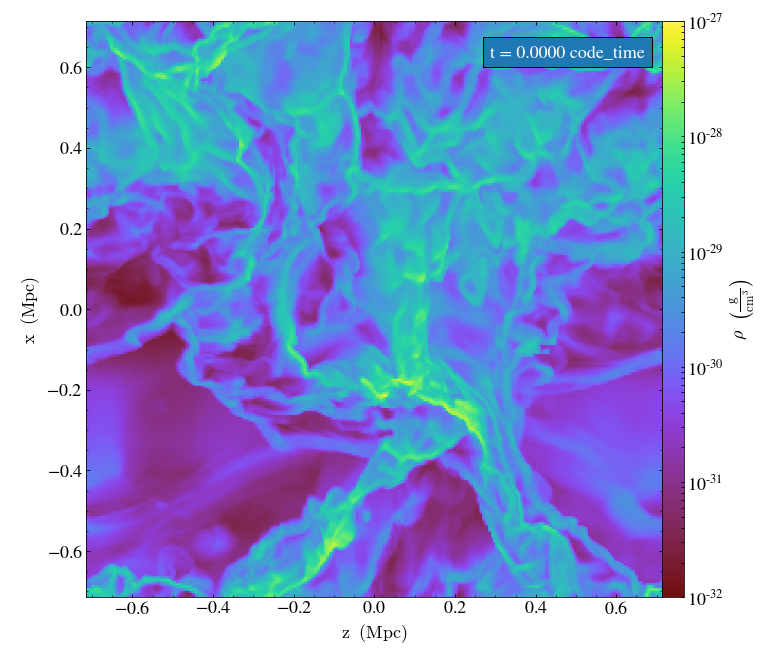

yt : [INFO     ] 2019-04-16 11:31:49,058 Saving plot Data_000051_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:49,934 Parameters: current_time              = 1.0000161627828293e-05
yt : [INFO     ] 2019-04-16 11:31:49,935 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:49,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:49,937 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:49,938 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:49,939 Parameters: current_redshift          = 99997.38374784021
yt : [INFO     ] 2019-04-16 11:31:49,939 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:49,940 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:49,941 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:52,591 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


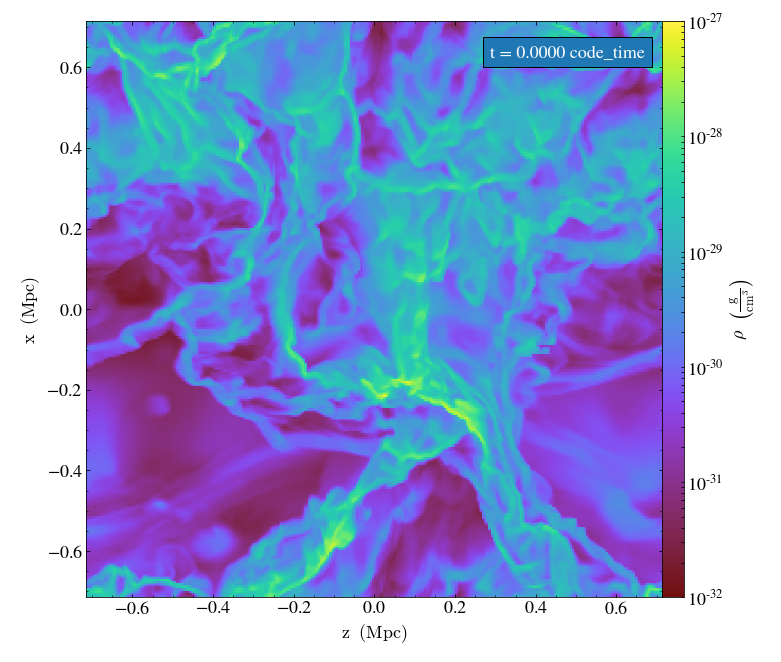

yt : [INFO     ] 2019-04-16 11:31:53,586 Saving plot Data_000052_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:54,544 Parameters: current_time              = 1.0000166085409298e-05
yt : [INFO     ] 2019-04-16 11:31:54,545 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:54,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:54,547 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:54,548 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:54,549 Parameters: current_redshift          = 99997.33917349092
yt : [INFO     ] 2019-04-16 11:31:54,550 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:54,551 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:54,552 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:31:57,179 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


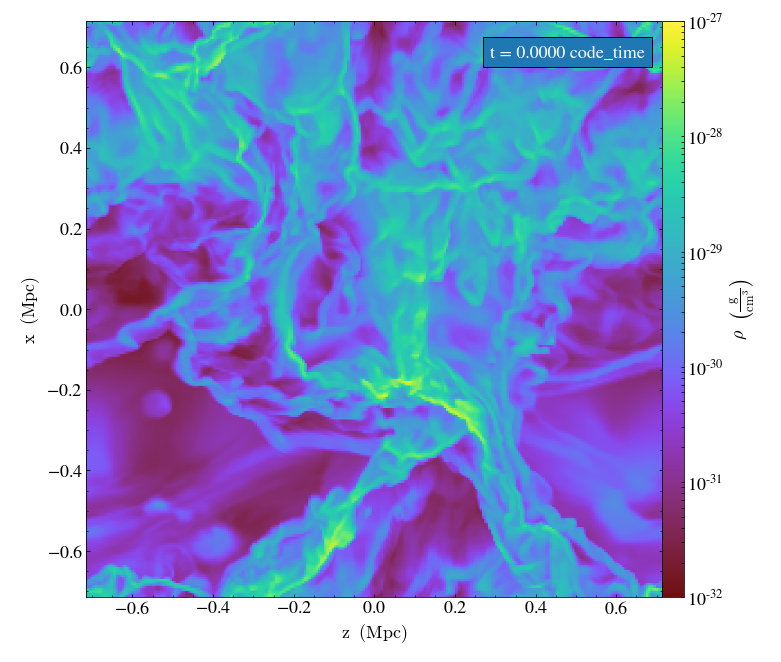

yt : [INFO     ] 2019-04-16 11:31:58,193 Saving plot Data_000053_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:31:58,975 Parameters: current_time              = 1.0000171883164795e-05
yt : [INFO     ] 2019-04-16 11:31:58,976 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:31:58,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:31:58,978 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:31:58,979 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:31:58,980 Parameters: current_redshift          = 99997.28119789537
yt : [INFO     ] 2019-04-16 11:31:58,981 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:31:58,981 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:31:58,982 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:01,645 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


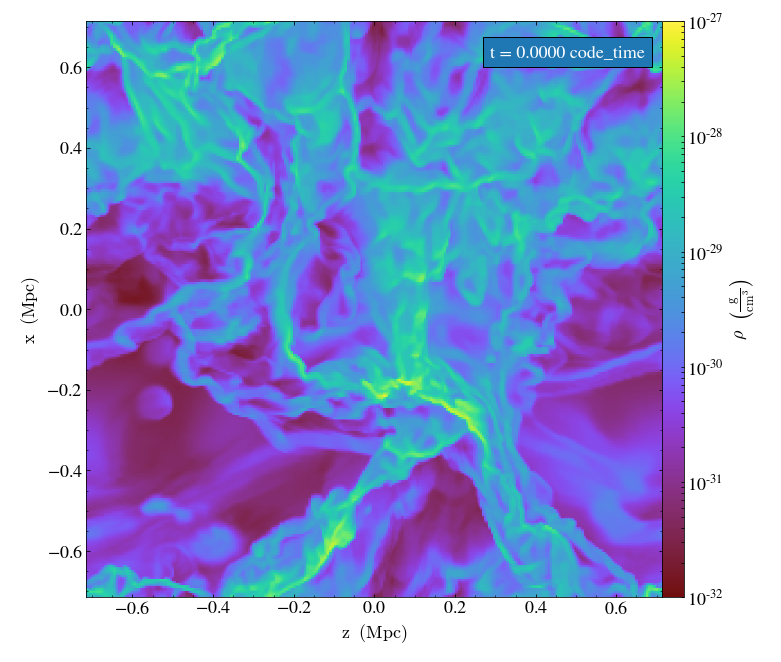

yt : [INFO     ] 2019-04-16 11:32:02,595 Saving plot Data_000054_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:03,389 Parameters: current_time              = 1.0000178060272186e-05
yt : [INFO     ] 2019-04-16 11:32:03,390 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:03,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:03,392 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:03,393 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:03,394 Parameters: current_redshift          = 99997.21942898304
yt : [INFO     ] 2019-04-16 11:32:03,395 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:03,395 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:03,396 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:06,174 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


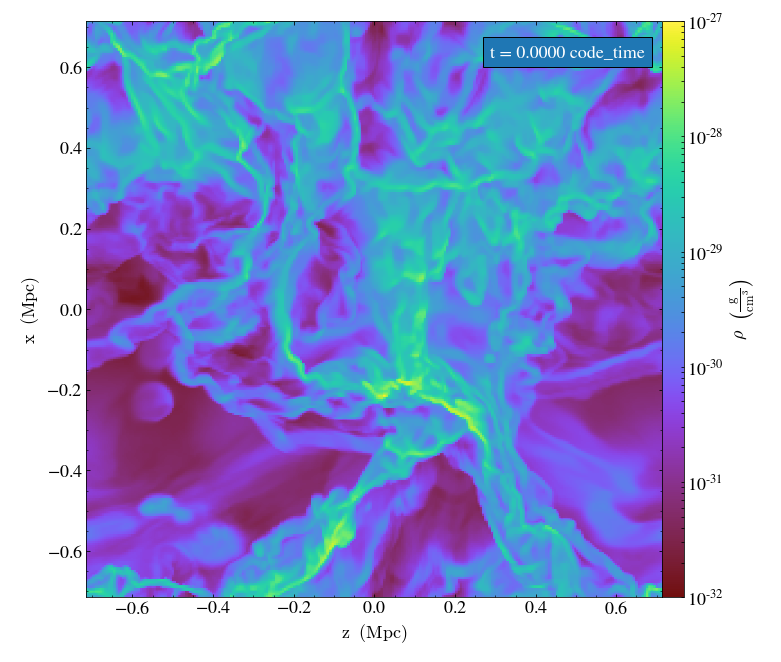

yt : [INFO     ] 2019-04-16 11:32:07,154 Saving plot Data_000055_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:08,067 Parameters: current_time              = 1.0000184989972196e-05
yt : [INFO     ] 2019-04-16 11:32:08,068 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:08,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:08,070 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:08,071 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:08,072 Parameters: current_redshift          = 99997.1501344987
yt : [INFO     ] 2019-04-16 11:32:08,073 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:08,073 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:08,074 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:10,633 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


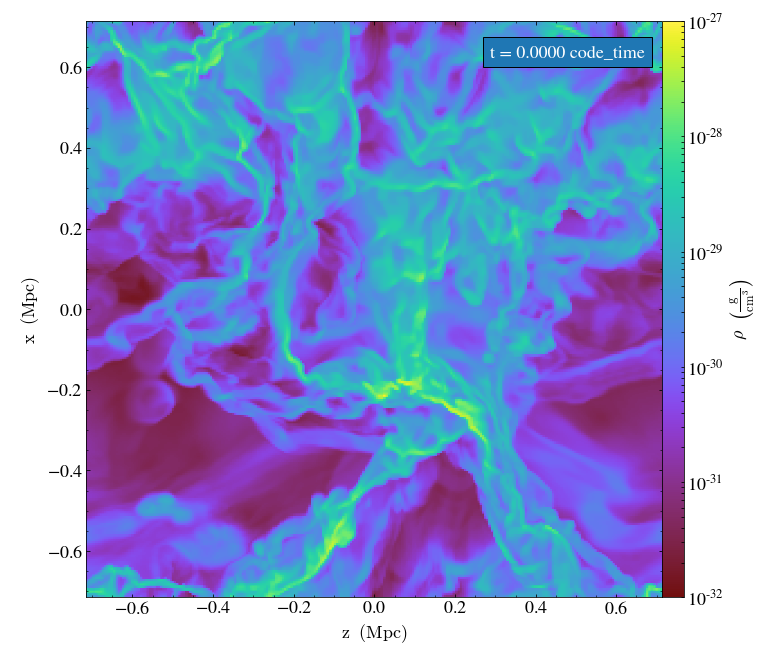

yt : [INFO     ] 2019-04-16 11:32:11,644 Saving plot Data_000056_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:12,515 Parameters: current_time              = 1.0000190989043038e-05
yt : [INFO     ] 2019-04-16 11:32:12,516 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:12,517 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:12,518 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:12,519 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:12,519 Parameters: current_redshift          = 99997.09014604574
yt : [INFO     ] 2019-04-16 11:32:12,520 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:12,521 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:12,522 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:15,245 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


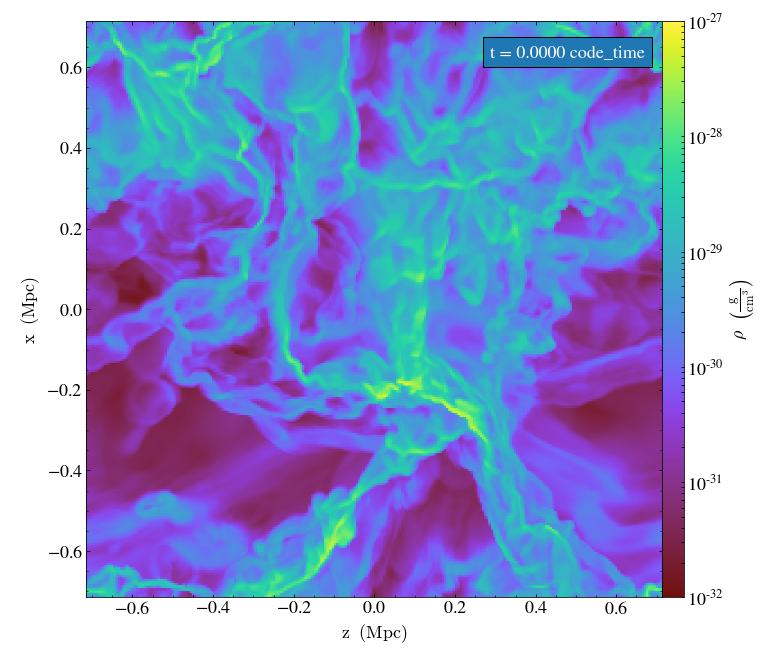

yt : [INFO     ] 2019-04-16 11:32:16,233 Saving plot Data_000057_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:17,088 Parameters: current_time              = 1.0000196159358394e-05
yt : [INFO     ] 2019-04-16 11:32:17,089 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:17,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:17,091 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:17,092 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:17,093 Parameters: current_redshift          = 99997.0384448938
yt : [INFO     ] 2019-04-16 11:32:17,094 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:17,094 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:17,095 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:19,708 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


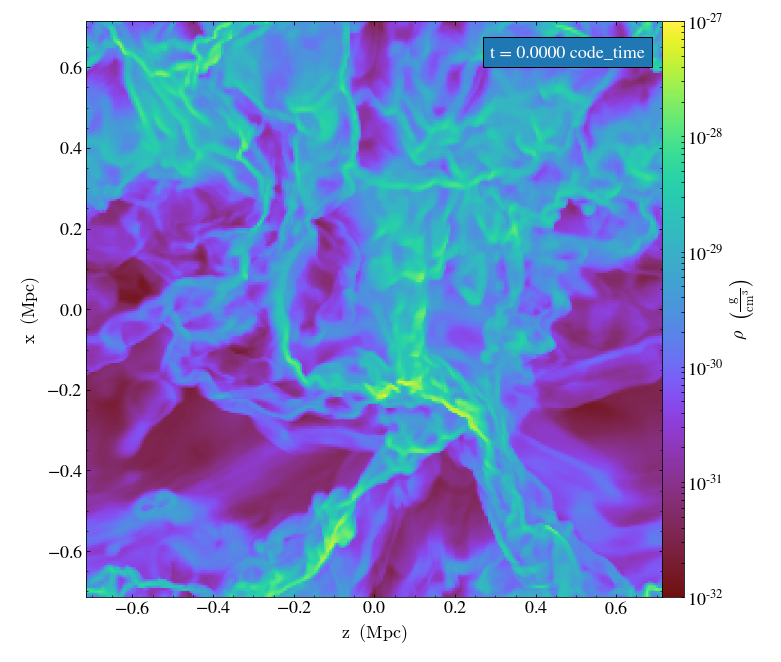

yt : [INFO     ] 2019-04-16 11:32:20,716 Saving plot Data_000058_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:21,635 Parameters: current_time              = 1.0000203050055276e-05
yt : [INFO     ] 2019-04-16 11:32:21,636 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:21,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:21,639 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:21,639 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:21,640 Parameters: current_redshift          = 99996.96954067572
yt : [INFO     ] 2019-04-16 11:32:21,641 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:21,642 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:21,643 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:24,452 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


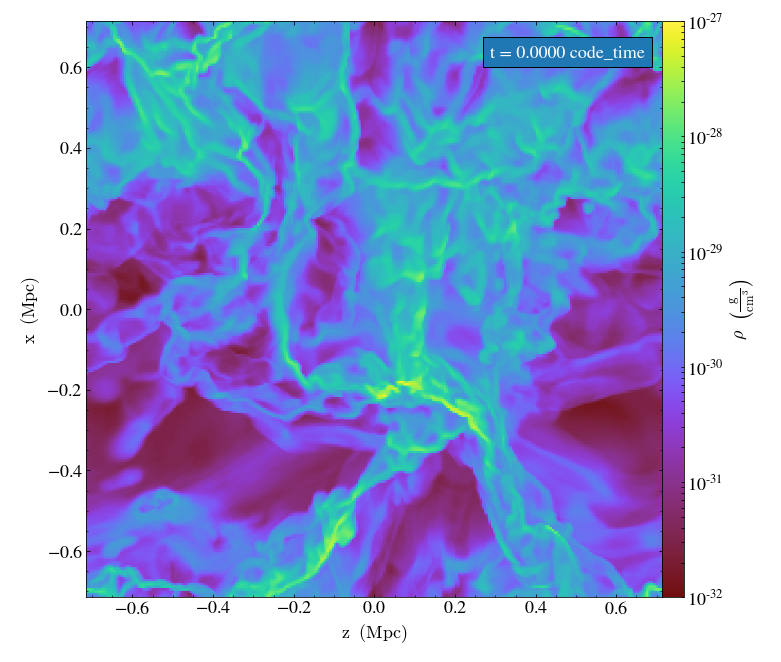

yt : [INFO     ] 2019-04-16 11:32:25,486 Saving plot Data_000059_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:26,410 Parameters: current_time              = 1.0000210014384354e-05
yt : [INFO     ] 2019-04-16 11:32:26,411 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:26,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:26,413 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:26,414 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:26,415 Parameters: current_redshift          = 99996.89990026157
yt : [INFO     ] 2019-04-16 11:32:26,416 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:26,416 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:26,417 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:28,839 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


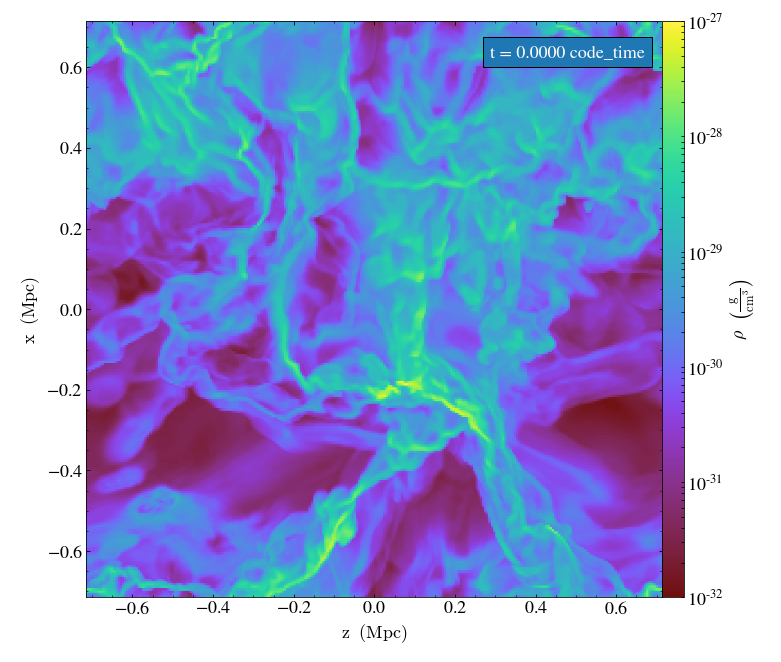

yt : [INFO     ] 2019-04-16 11:32:29,829 Saving plot Data_000060_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:30,698 Parameters: current_time              = 1.0000217522851991e-05
yt : [INFO     ] 2019-04-16 11:32:30,699 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:30,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:30,701 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:30,702 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:30,703 Parameters: current_redshift          = 99996.82481879526
yt : [INFO     ] 2019-04-16 11:32:30,704 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:30,705 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:30,706 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:33,457 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


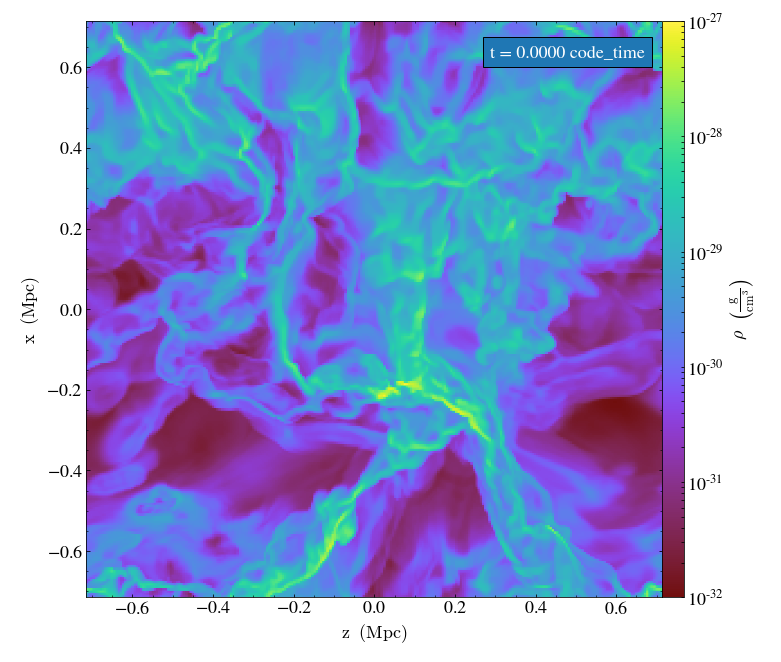

yt : [INFO     ] 2019-04-16 11:32:34,410 Saving plot Data_000061_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:35,305 Parameters: current_time              = 1.0000225065623892e-05
yt : [INFO     ] 2019-04-16 11:32:35,307 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:35,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:35,309 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:35,310 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:35,311 Parameters: current_redshift          = 99996.74939441447
yt : [INFO     ] 2019-04-16 11:32:35,311 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:35,312 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:35,313 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:38,337 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


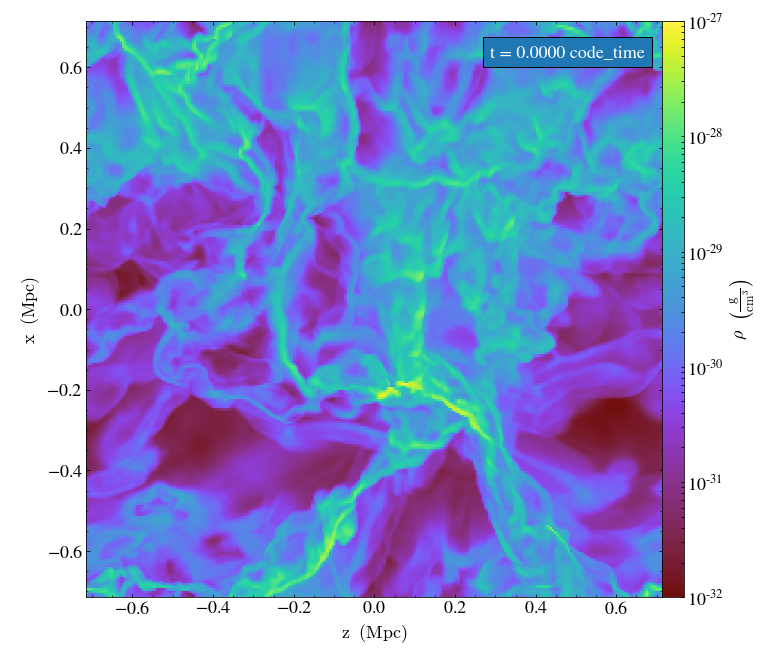

yt : [INFO     ] 2019-04-16 11:32:39,341 Saving plot Data_000062_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:40,201 Parameters: current_time              = 1.0000232872765937e-05
yt : [INFO     ] 2019-04-16 11:32:40,202 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:40,203 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:40,204 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:40,205 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:40,206 Parameters: current_redshift          = 99996.67132656909
yt : [INFO     ] 2019-04-16 11:32:40,207 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:40,207 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:40,208 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:42,765 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


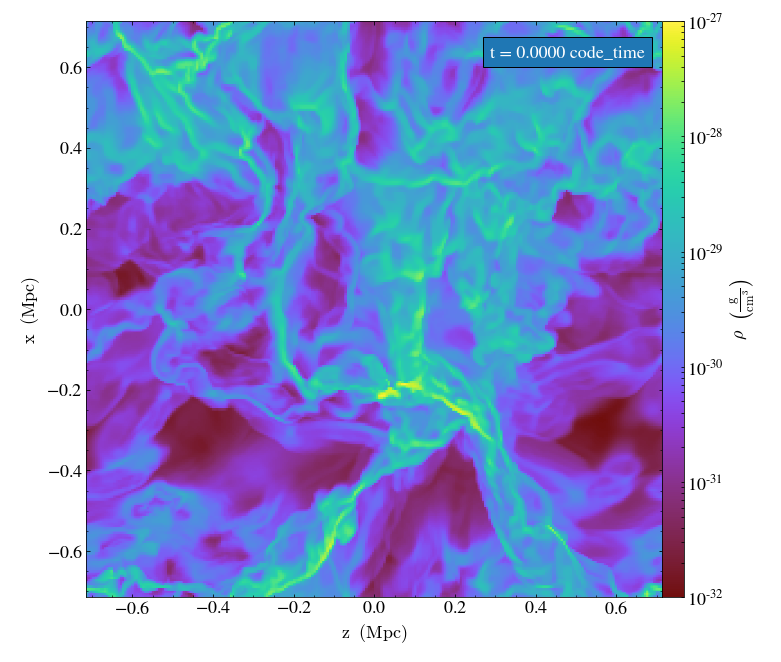

yt : [INFO     ] 2019-04-16 11:32:43,775 Saving plot Data_000063_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:44,609 Parameters: current_time              = 1.0000239763069806e-05
yt : [INFO     ] 2019-04-16 11:32:44,610 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:44,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:44,613 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:44,614 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:44,614 Parameters: current_redshift          = 99996.60242678689
yt : [INFO     ] 2019-04-16 11:32:44,615 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:44,616 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:44,617 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:47,208 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


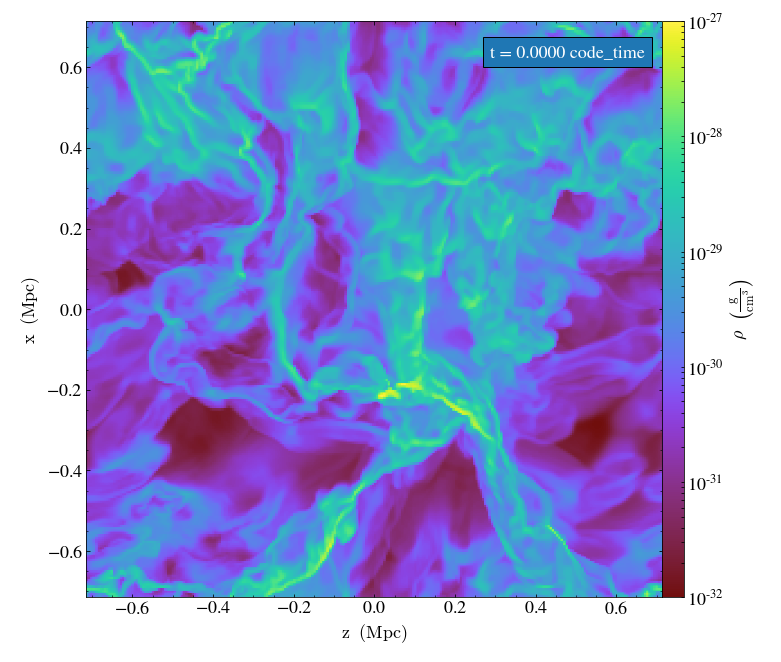

yt : [INFO     ] 2019-04-16 11:32:48,174 Saving plot Data_000064_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:48,973 Parameters: current_time              = 1.0000244267284428e-05
yt : [INFO     ] 2019-04-16 11:32:48,974 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:48,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:48,975 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:48,976 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:48,977 Parameters: current_redshift          = 99996.55738682077
yt : [INFO     ] 2019-04-16 11:32:48,978 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:48,979 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:48,979 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:51,438 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


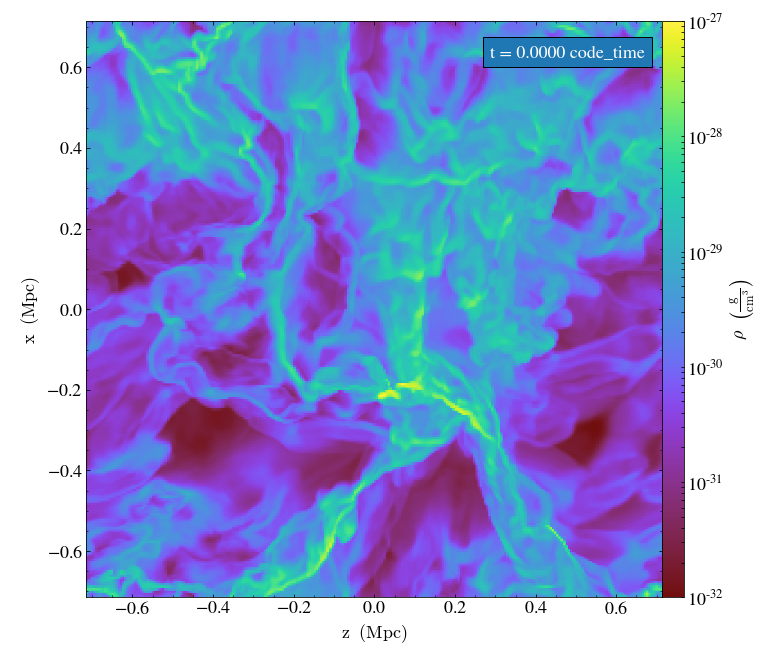

yt : [INFO     ] 2019-04-16 11:32:52,427 Saving plot Data_000065_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:53,306 Parameters: current_time              = 1.0000248112629462e-05
yt : [INFO     ] 2019-04-16 11:32:53,307 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:53,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:53,308 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:53,309 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:53,310 Parameters: current_redshift          = 99996.51893526372
yt : [INFO     ] 2019-04-16 11:32:53,311 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:53,311 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:53,312 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:32:55,849 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


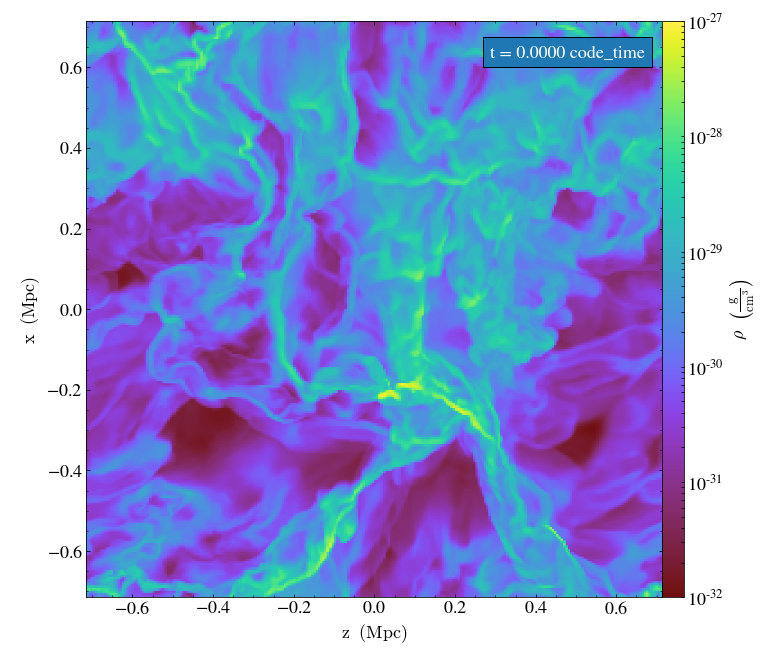

yt : [INFO     ] 2019-04-16 11:32:56,855 Saving plot Data_000066_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:32:57,721 Parameters: current_time              = 1.000025489094338e-05
yt : [INFO     ] 2019-04-16 11:32:57,722 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:32:57,723 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:32:57,724 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:32:57,725 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:32:57,726 Parameters: current_redshift          = 99996.45115553394
yt : [INFO     ] 2019-04-16 11:32:57,727 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:32:57,728 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:32:57,728 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:00,250 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


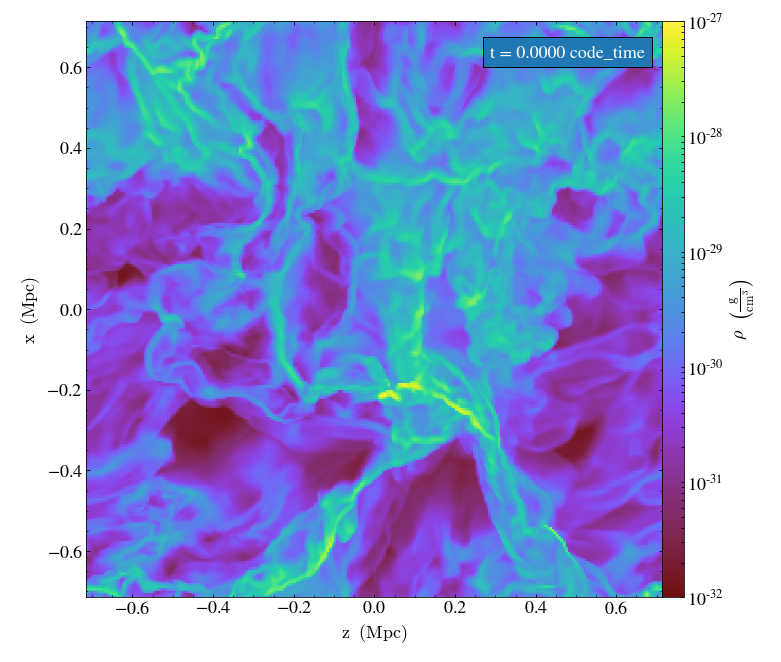

yt : [INFO     ] 2019-04-16 11:33:01,221 Saving plot Data_000067_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:02,098 Parameters: current_time              = 1.0000263072288364e-05
yt : [INFO     ] 2019-04-16 11:33:02,099 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:02,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:02,101 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:02,102 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:02,103 Parameters: current_redshift          = 99996.36934632157
yt : [INFO     ] 2019-04-16 11:33:02,103 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:02,104 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:02,105 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:04,792 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


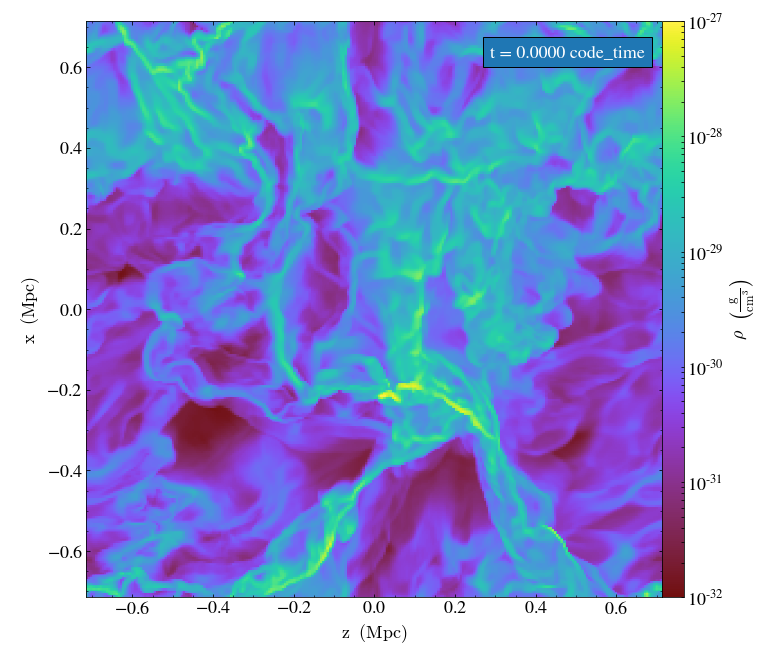

yt : [INFO     ] 2019-04-16 11:33:05,789 Saving plot Data_000068_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:06,625 Parameters: current_time              = 1.0000271865444972e-05
yt : [INFO     ] 2019-04-16 11:33:06,626 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:06,627 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:06,628 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:06,629 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:06,630 Parameters: current_redshift          = 99996.28141945909
yt : [INFO     ] 2019-04-16 11:33:06,630 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:06,631 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:06,632 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:09,318 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


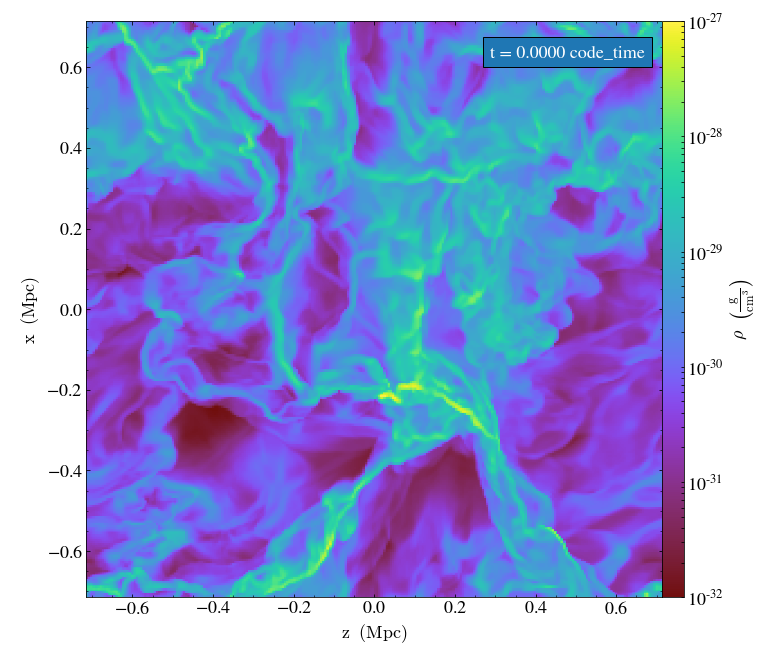

yt : [INFO     ] 2019-04-16 11:33:10,330 Saving plot Data_000069_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:11,223 Parameters: current_time              = 1.0000280988363356e-05
yt : [INFO     ] 2019-04-16 11:33:11,224 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:11,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:11,226 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:11,227 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:11,228 Parameters: current_redshift          = 99996.19019531869
yt : [INFO     ] 2019-04-16 11:33:11,228 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:11,229 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:11,230 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:13,762 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


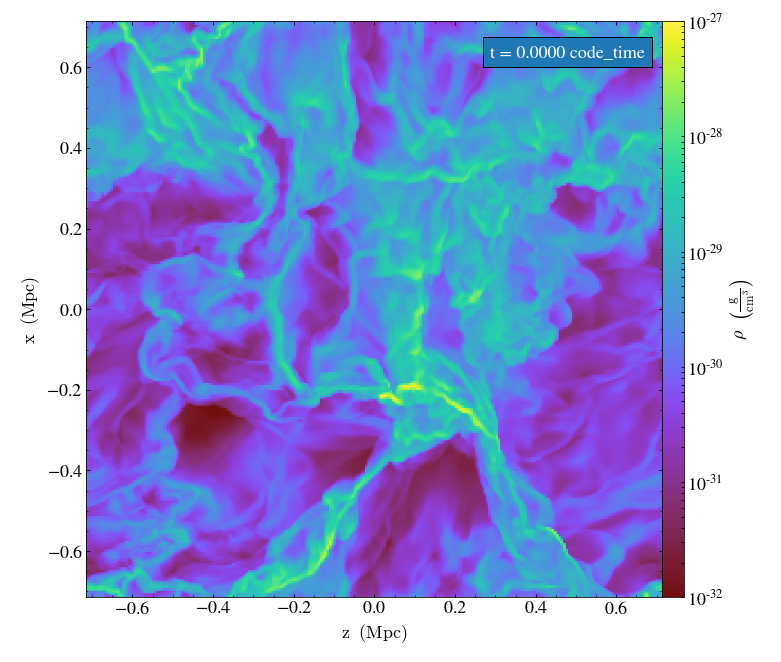

yt : [INFO     ] 2019-04-16 11:33:14,752 Saving plot Data_000070_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:15,656 Parameters: current_time              = 1.000029153043619e-05
yt : [INFO     ] 2019-04-16 11:33:15,657 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:15,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:15,658 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:15,659 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:15,660 Parameters: current_redshift          = 99996.0847806256
yt : [INFO     ] 2019-04-16 11:33:15,661 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:15,662 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:15,663 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:18,329 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 1


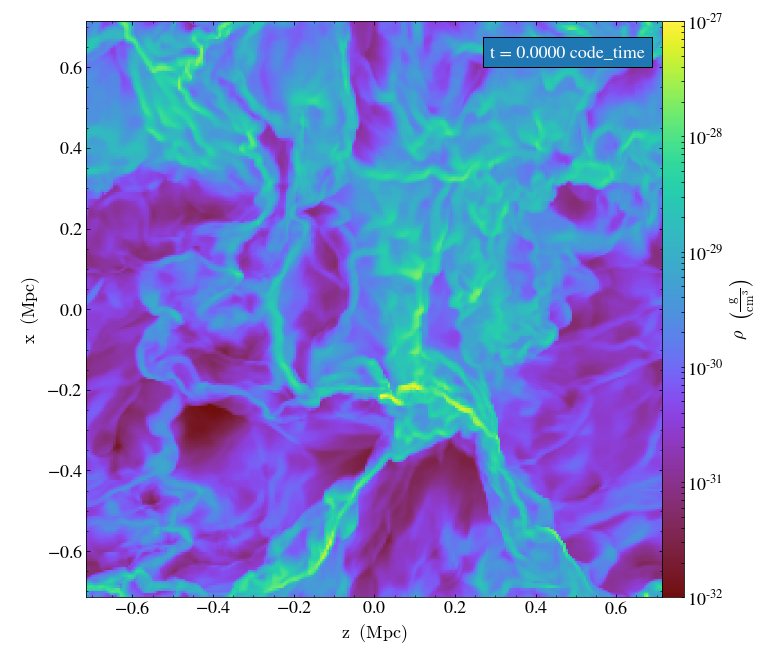

yt : [INFO     ] 2019-04-16 11:33:19,298 Saving plot Data_000071_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:20,182 Parameters: current_time              = 1.0000301022903521e-05
yt : [INFO     ] 2019-04-16 11:33:20,183 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:20,184 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:20,185 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:20,186 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:20,187 Parameters: current_redshift          = 99995.98986157685
yt : [INFO     ] 2019-04-16 11:33:20,188 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:20,188 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:20,189 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:22,773 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


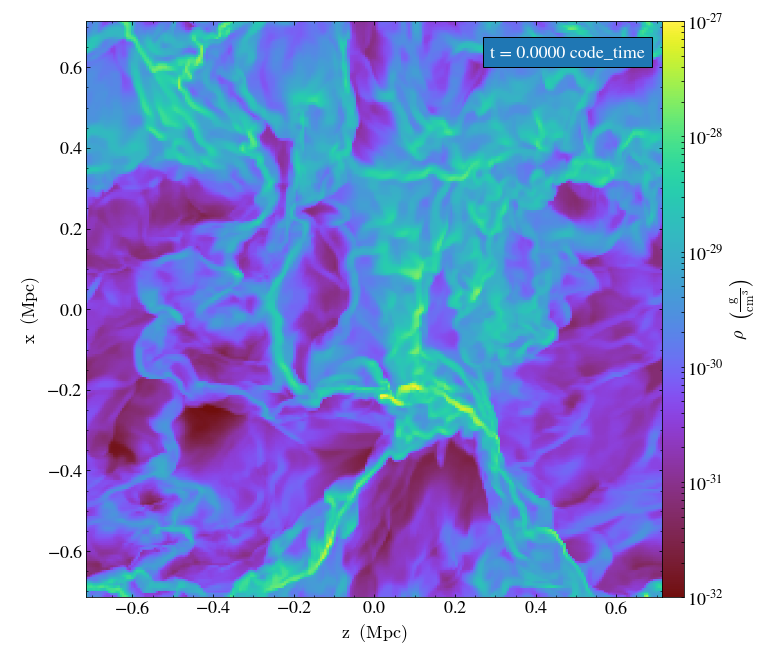

yt : [INFO     ] 2019-04-16 11:33:23,791 Saving plot Data_000072_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:24,675 Parameters: current_time              = 1.0000310288119006e-05
yt : [INFO     ] 2019-04-16 11:33:24,676 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:24,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:24,678 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:24,679 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:24,680 Parameters: current_redshift          = 99995.89721508567
yt : [INFO     ] 2019-04-16 11:33:24,681 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:24,682 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:24,683 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:27,363 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


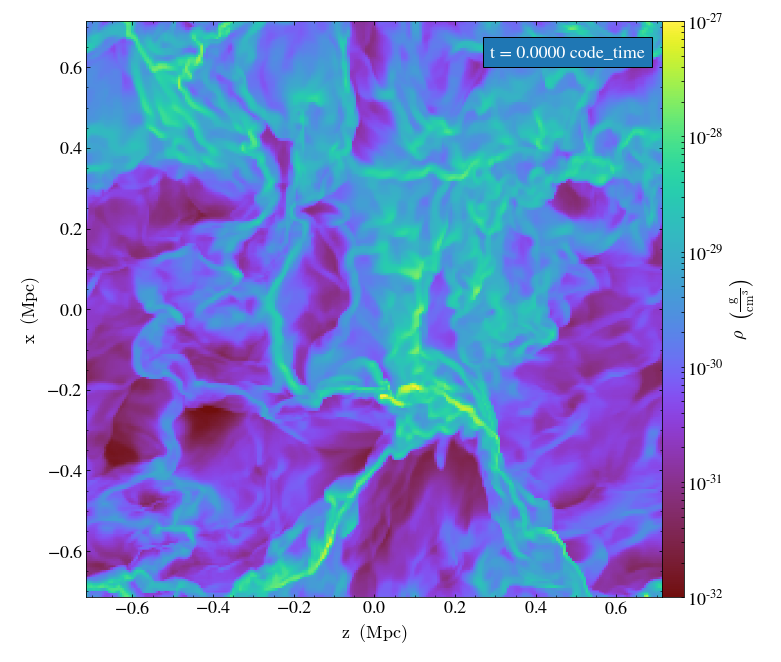

yt : [INFO     ] 2019-04-16 11:33:28,341 Saving plot Data_000073_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:29,126 Parameters: current_time              = 1.0000319132958067e-05
yt : [INFO     ] 2019-04-16 11:33:29,127 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:29,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:29,129 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:29,130 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:29,131 Parameters: current_redshift          = 99995.80877226192
yt : [INFO     ] 2019-04-16 11:33:29,132 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:29,133 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:29,133 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:31,712 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


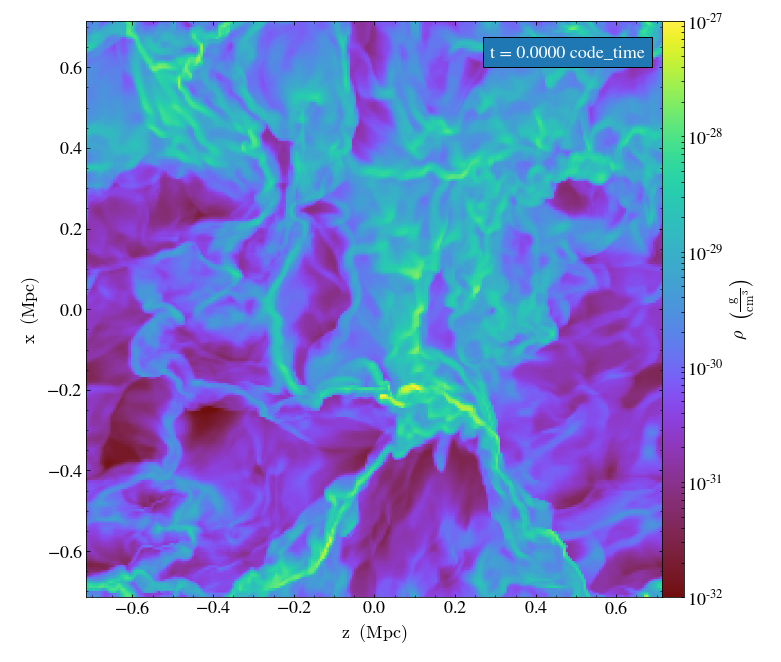

yt : [INFO     ] 2019-04-16 11:33:32,708 Saving plot Data_000074_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:33,518 Parameters: current_time              = 1.0000329231796242e-05
yt : [INFO     ] 2019-04-16 11:33:33,519 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:33,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:33,520 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:33,521 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:33,522 Parameters: current_redshift          = 99995.7077904276
yt : [INFO     ] 2019-04-16 11:33:33,523 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:33,524 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:33,524 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:36,084 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


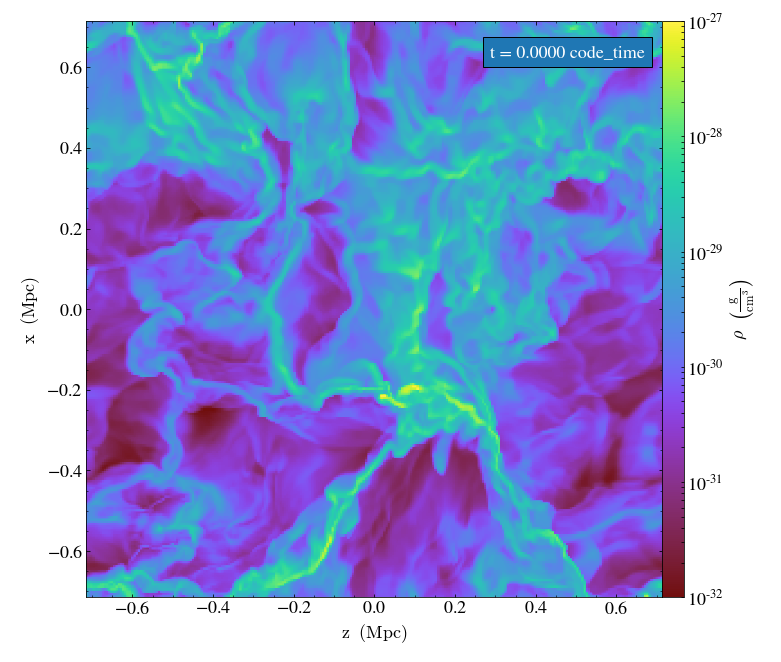

yt : [INFO     ] 2019-04-16 11:33:37,050 Saving plot Data_000075_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:37,896 Parameters: current_time              = 1.0000337163360867e-05
yt : [INFO     ] 2019-04-16 11:33:37,897 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:37,898 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:37,899 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:37,900 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:37,901 Parameters: current_redshift          = 99995.62848006662
yt : [INFO     ] 2019-04-16 11:33:37,902 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:37,902 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:37,903 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:40,500 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


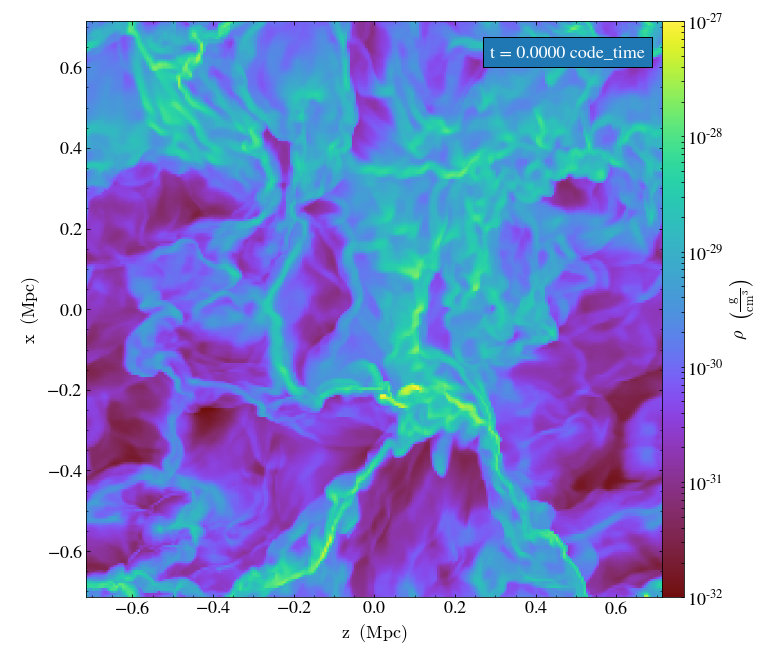

yt : [INFO     ] 2019-04-16 11:33:41,815 Saving plot Data_000076_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:42,717 Parameters: current_time              = 1.0000346976251078e-05
yt : [INFO     ] 2019-04-16 11:33:42,718 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:42,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:42,720 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:42,721 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:42,722 Parameters: current_redshift          = 99995.53035787756
yt : [INFO     ] 2019-04-16 11:33:42,722 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:42,723 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:42,724 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:45,415 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


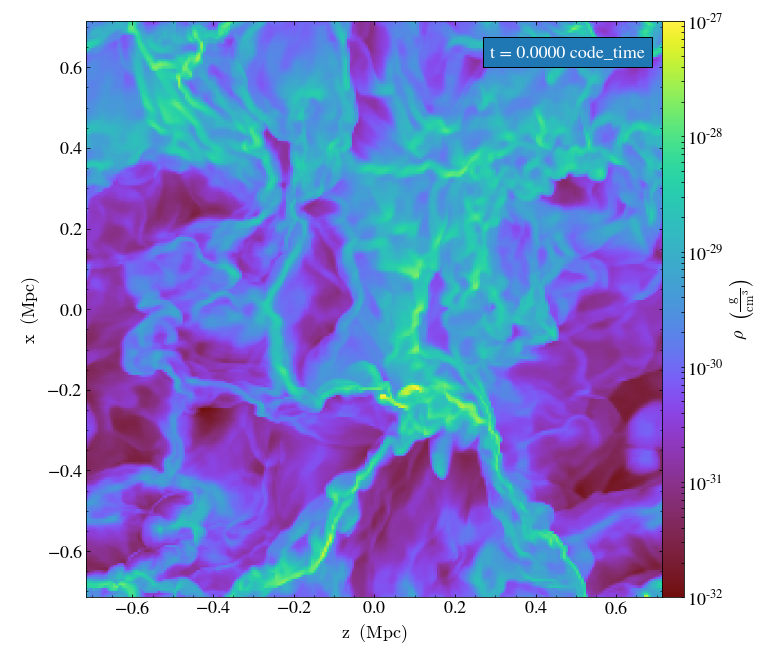

yt : [INFO     ] 2019-04-16 11:33:46,434 Saving plot Data_000077_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:47,365 Parameters: current_time              = 1.0000356070937476e-05
yt : [INFO     ] 2019-04-16 11:33:47,366 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:47,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:47,368 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:47,369 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:47,370 Parameters: current_redshift          = 99995.43941740724
yt : [INFO     ] 2019-04-16 11:33:47,370 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:47,371 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:47,372 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:50,009 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


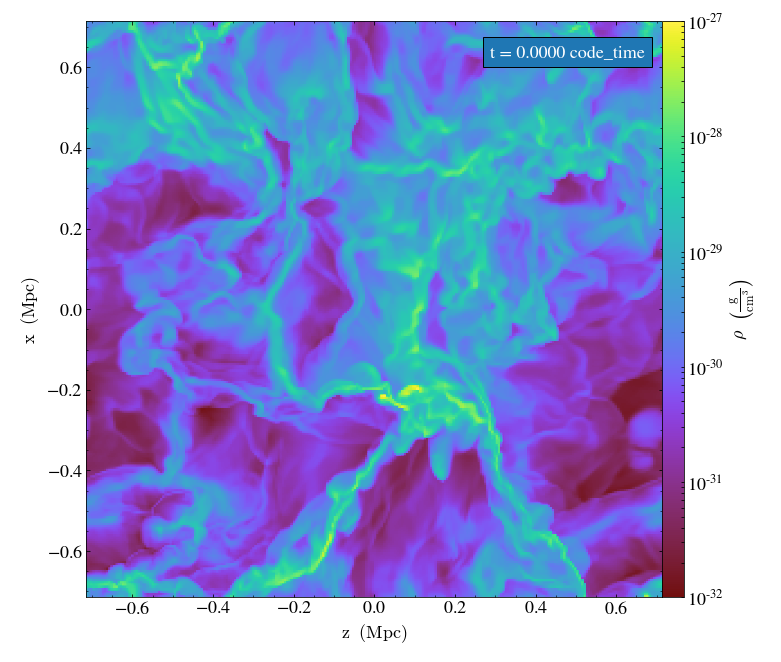

yt : [INFO     ] 2019-04-16 11:33:51,062 Saving plot Data_000078_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:51,964 Parameters: current_time              = 1.0000358503421506e-05
yt : [INFO     ] 2019-04-16 11:33:51,965 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:51,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:51,967 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:51,968 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:51,969 Parameters: current_redshift          = 99995.41509430503
yt : [INFO     ] 2019-04-16 11:33:51,970 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:51,970 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:51,971 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:54,695 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


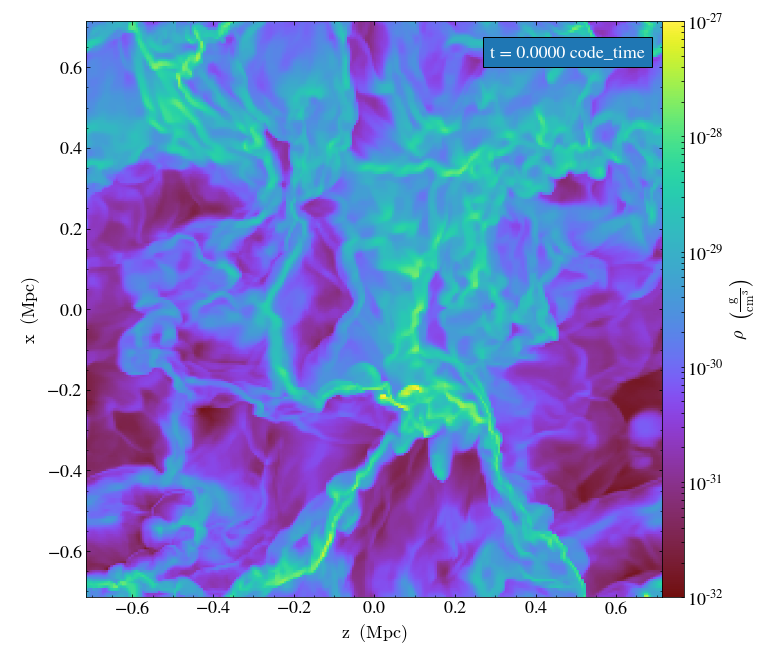

yt : [INFO     ] 2019-04-16 11:33:55,698 Saving plot Data_000079_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:33:56,603 Parameters: current_time              = 1.000036128500937e-05
yt : [INFO     ] 2019-04-16 11:33:56,604 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:33:56,605 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:33:56,606 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:33:56,607 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:33:56,607 Parameters: current_redshift          = 99995.38728042845
yt : [INFO     ] 2019-04-16 11:33:56,608 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:33:56,609 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:33:56,609 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:33:59,334 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


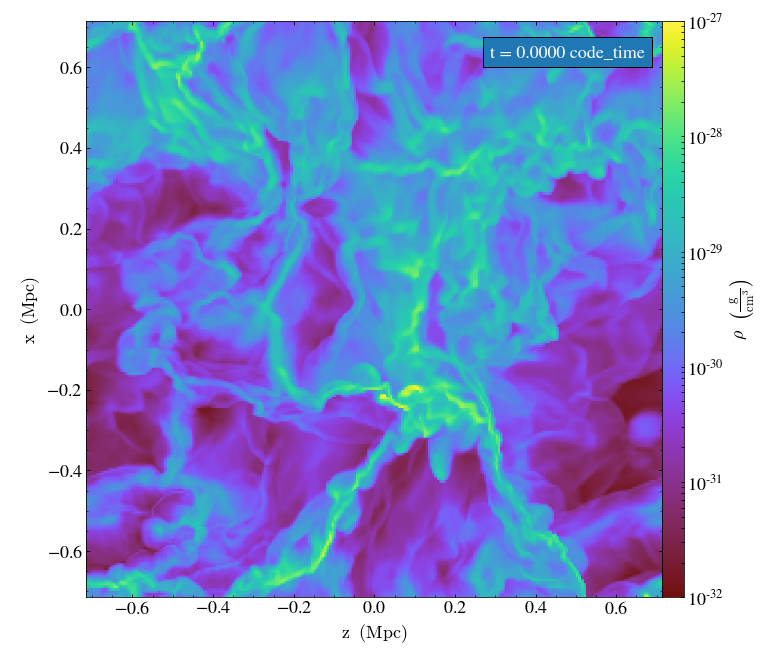

yt : [INFO     ] 2019-04-16 11:34:00,333 Saving plot Data_000080_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:01,252 Parameters: current_time              = 1.0000364868999754e-05
yt : [INFO     ] 2019-04-16 11:34:01,253 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:01,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:01,255 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:01,256 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:01,257 Parameters: current_redshift          = 99995.35144312699
yt : [INFO     ] 2019-04-16 11:34:01,258 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:01,259 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:01,259 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:03,907 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


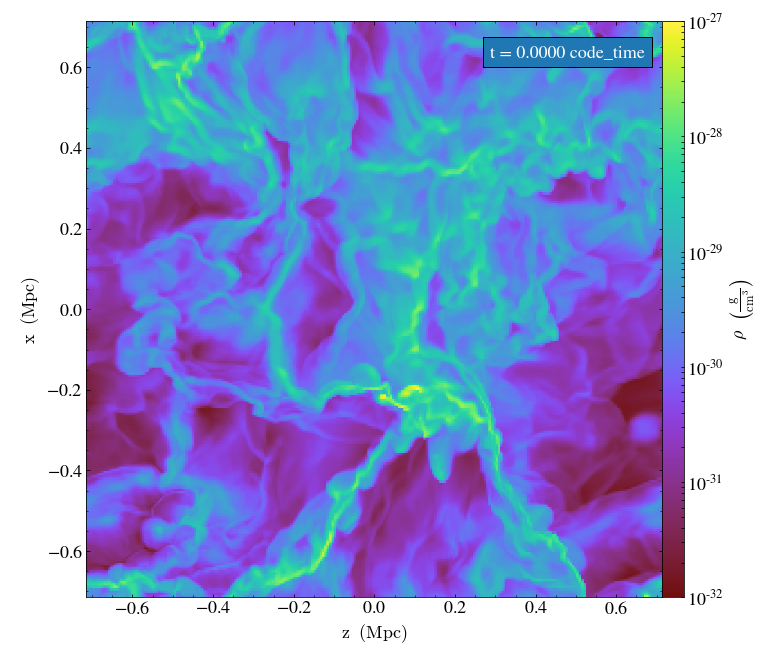

yt : [INFO     ] 2019-04-16 11:34:05,106 Saving plot Data_000081_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:06,007 Parameters: current_time              = 1.0000369195588846e-05
yt : [INFO     ] 2019-04-16 11:34:06,008 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:06,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:06,010 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:06,011 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:06,012 Parameters: current_redshift          = 99995.3081804119
yt : [INFO     ] 2019-04-16 11:34:06,012 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:06,013 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:06,014 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:08,659 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


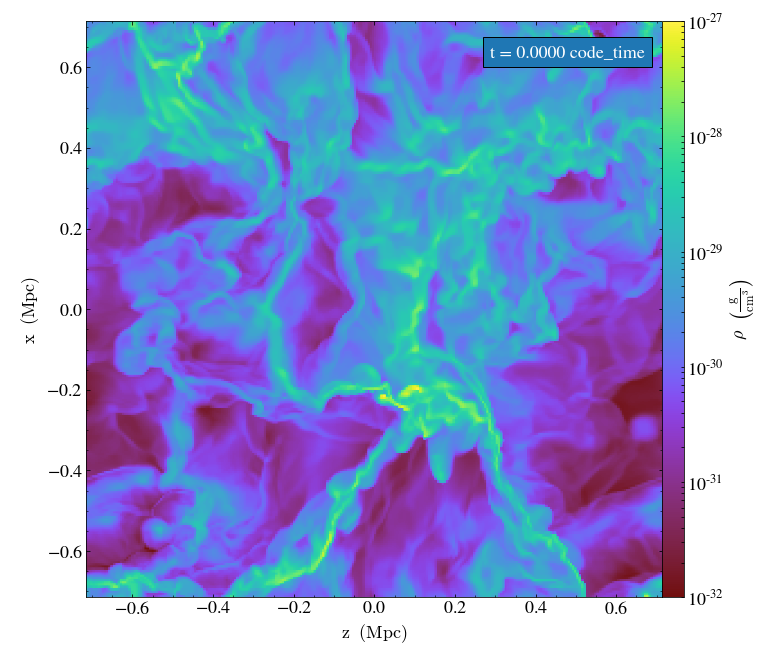

yt : [INFO     ] 2019-04-16 11:34:09,644 Saving plot Data_000082_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:10,405 Parameters: current_time              = 1.0000373878587777e-05
yt : [INFO     ] 2019-04-16 11:34:10,406 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:10,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:10,408 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:10,409 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:10,410 Parameters: current_redshift          = 99995.2613539022
yt : [INFO     ] 2019-04-16 11:34:10,410 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:10,411 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:10,412 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:13,195 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


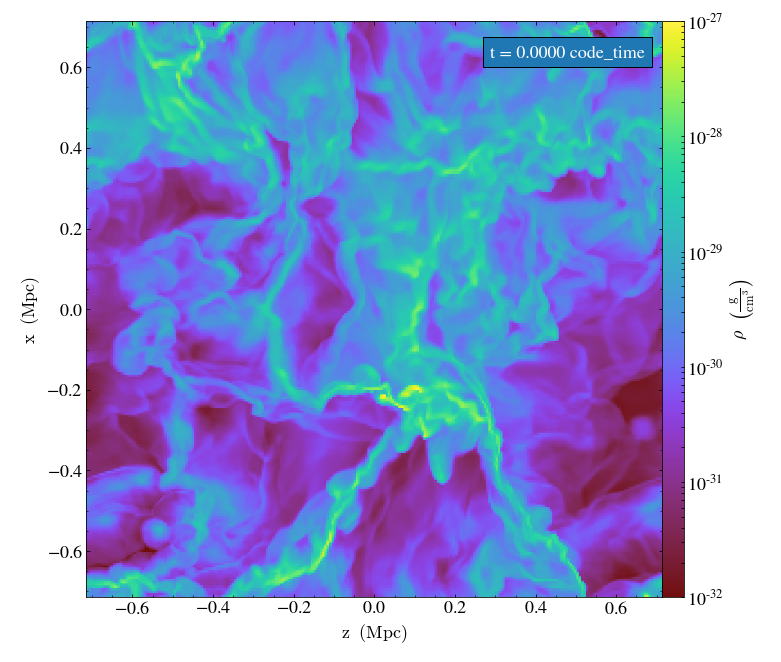

yt : [INFO     ] 2019-04-16 11:34:14,193 Saving plot Data_000083_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:15,117 Parameters: current_time              = 1.0000379298690681e-05
yt : [INFO     ] 2019-04-16 11:34:15,118 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:15,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:15,120 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:15,121 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:15,122 Parameters: current_redshift          = 99995.20715695524
yt : [INFO     ] 2019-04-16 11:34:15,122 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:15,123 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:15,124 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:17,658 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


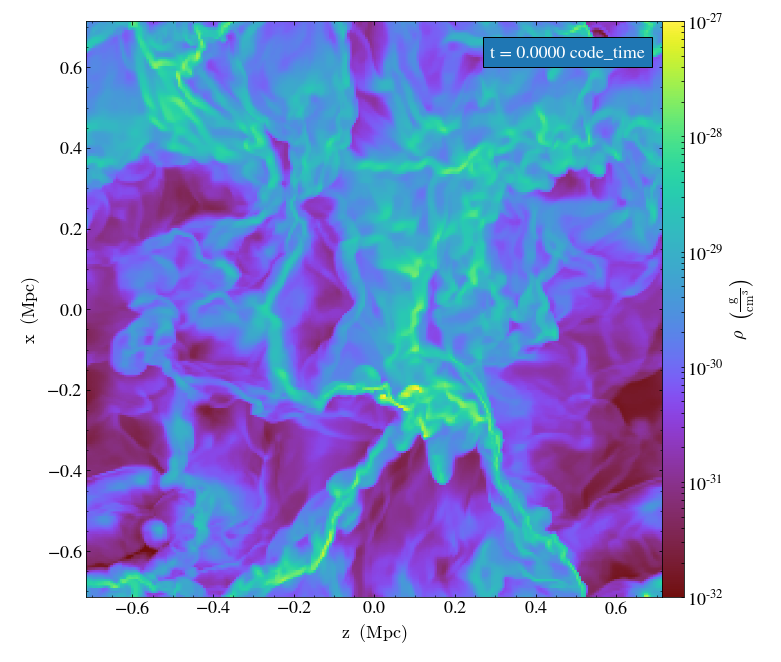

yt : [INFO     ] 2019-04-16 11:34:18,663 Saving plot Data_000084_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:19,600 Parameters: current_time              = 1.0000385679845387e-05
yt : [INFO     ] 2019-04-16 11:34:19,601 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:19,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:19,603 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:19,604 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:19,605 Parameters: current_redshift          = 99995.14335028933
yt : [INFO     ] 2019-04-16 11:34:19,605 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:19,606 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:19,607 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:22,346 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


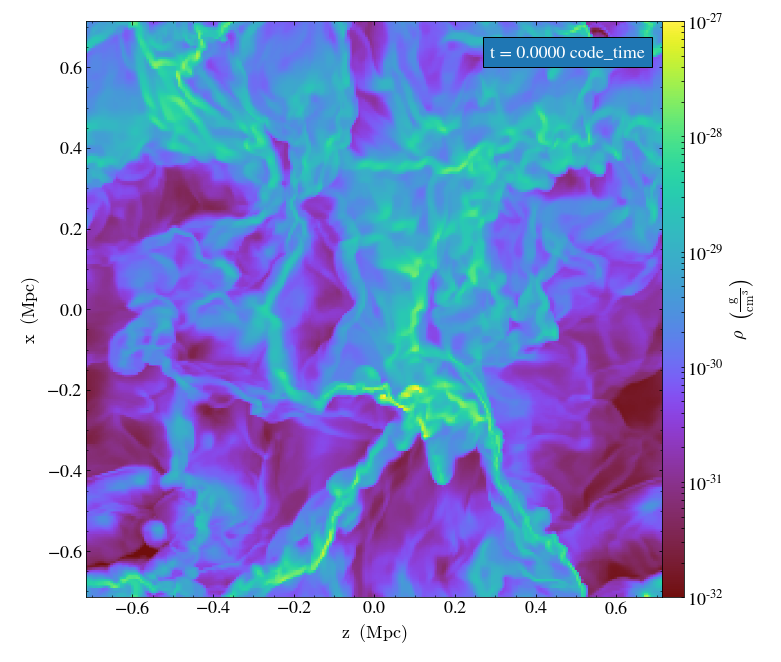

yt : [INFO     ] 2019-04-16 11:34:23,340 Saving plot Data_000085_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:24,090 Parameters: current_time              = 1.000039345026842e-05
yt : [INFO     ] 2019-04-16 11:34:24,091 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:24,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:24,093 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:24,094 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:24,094 Parameters: current_redshift          = 99995.06565211283
yt : [INFO     ] 2019-04-16 11:34:24,095 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:24,096 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:24,097 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:26,768 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


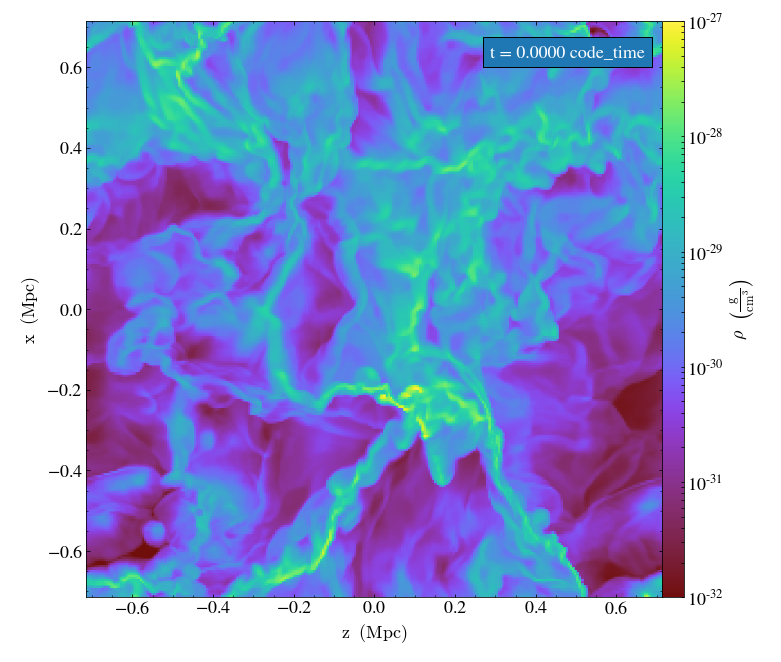

yt : [INFO     ] 2019-04-16 11:34:27,766 Saving plot Data_000086_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:28,632 Parameters: current_time              = 1.0000402504362076e-05
yt : [INFO     ] 2019-04-16 11:34:28,633 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:28,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:28,635 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:28,636 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:28,637 Parameters: current_redshift          = 99994.97511838248
yt : [INFO     ] 2019-04-16 11:34:28,638 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:28,639 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:28,640 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:31,220 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


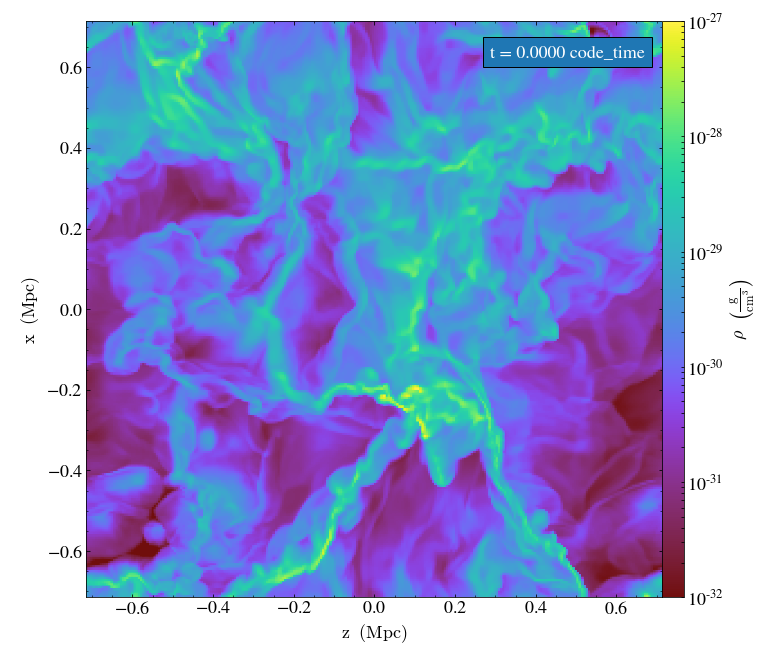

yt : [INFO     ] 2019-04-16 11:34:32,205 Saving plot Data_000087_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:33,100 Parameters: current_time              = 1.0000413497315197e-05
yt : [INFO     ] 2019-04-16 11:34:33,101 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:33,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:33,103 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:33,104 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:33,104 Parameters: current_redshift          = 99994.86519782098
yt : [INFO     ] 2019-04-16 11:34:33,105 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:33,106 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:33,107 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:35,790 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


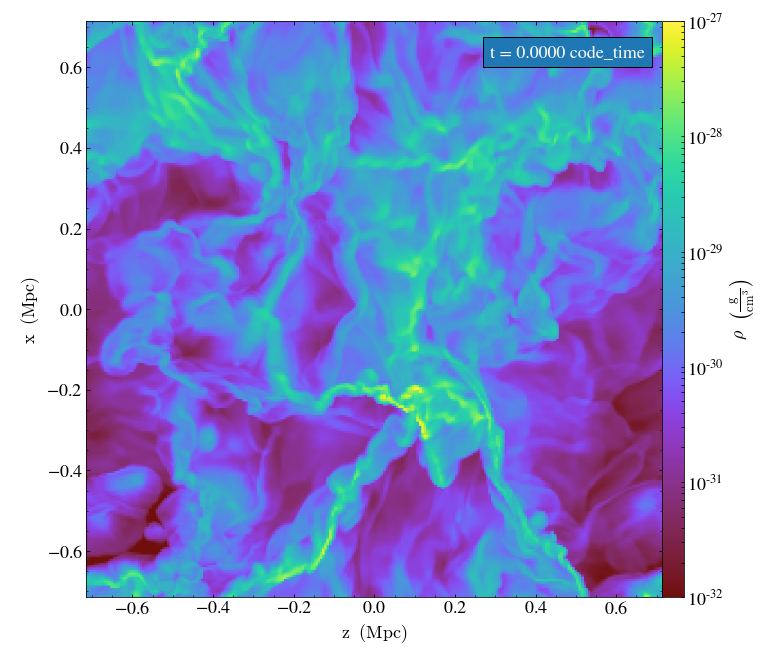

yt : [INFO     ] 2019-04-16 11:34:36,769 Saving plot Data_000088_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:37,695 Parameters: current_time              = 1.0000426642924192e-05
yt : [INFO     ] 2019-04-16 11:34:37,696 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:37,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:37,698 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:37,698 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:37,699 Parameters: current_redshift          = 99994.7337527745
yt : [INFO     ] 2019-04-16 11:34:37,700 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:37,701 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:37,702 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:40,343 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


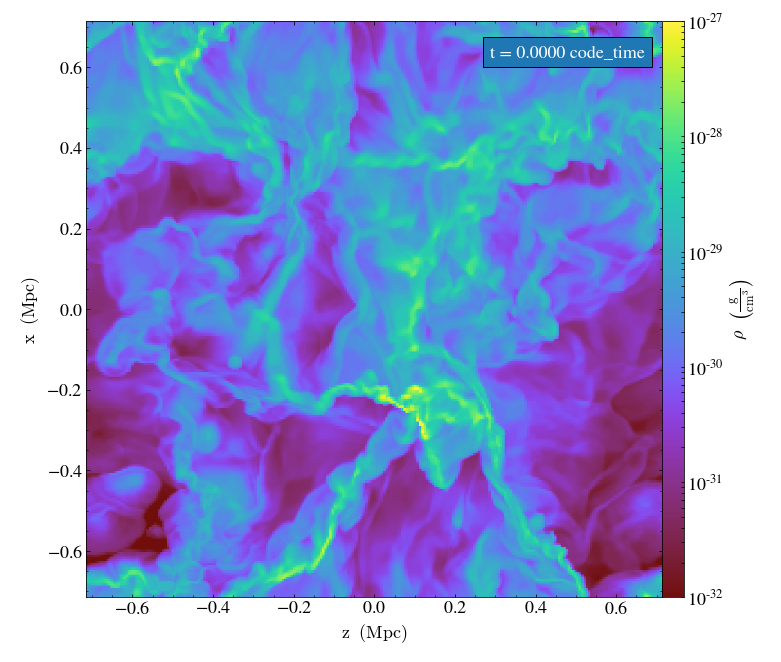

yt : [INFO     ] 2019-04-16 11:34:41,556 Saving plot Data_000089_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:42,464 Parameters: current_time              = 1.0000439234583894e-05
yt : [INFO     ] 2019-04-16 11:34:42,465 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:42,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:42,467 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:42,468 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:42,468 Parameters: current_redshift          = 99994.6078470796
yt : [INFO     ] 2019-04-16 11:34:42,469 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:42,470 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:42,471 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:45,037 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


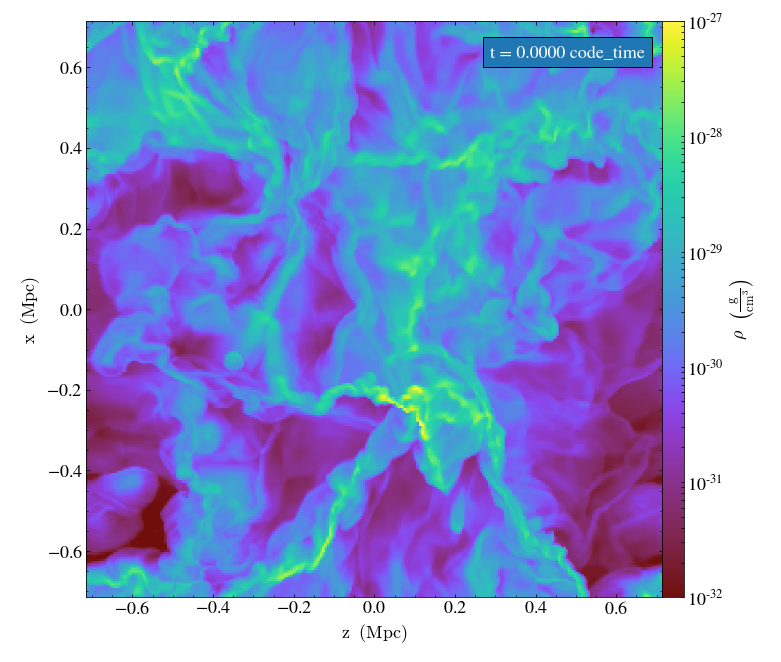

yt : [INFO     ] 2019-04-16 11:34:45,989 Saving plot Data_000090_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:46,815 Parameters: current_time              = 1.0000452410556855e-05
yt : [INFO     ] 2019-04-16 11:34:46,816 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:46,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:46,818 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:46,819 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:46,820 Parameters: current_redshift          = 99994.4760990975
yt : [INFO     ] 2019-04-16 11:34:46,820 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:46,821 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:46,822 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:49,321 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


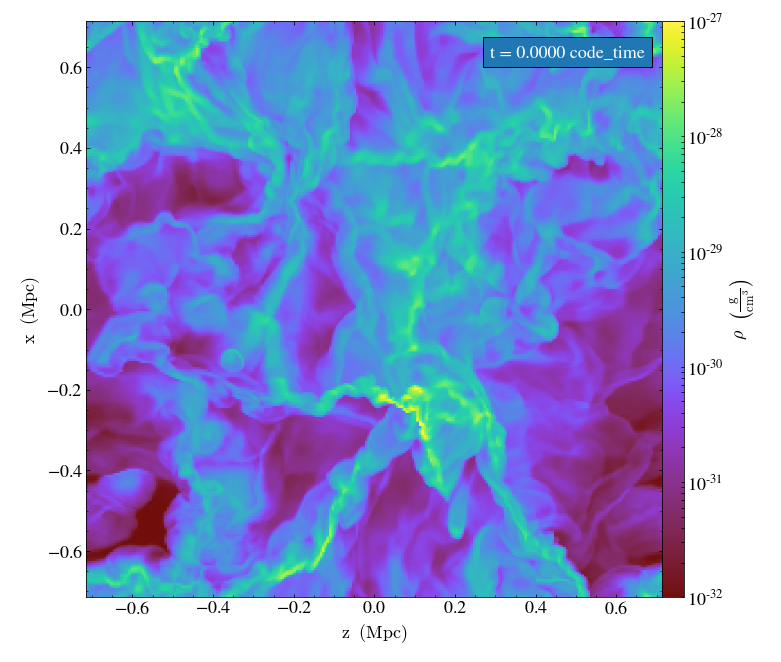

yt : [INFO     ] 2019-04-16 11:34:50,292 Saving plot Data_000091_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:51,172 Parameters: current_time              = 1.0000465169116407e-05
yt : [INFO     ] 2019-04-16 11:34:51,173 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:51,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:51,175 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:51,176 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:51,176 Parameters: current_redshift          = 99994.34852520817
yt : [INFO     ] 2019-04-16 11:34:51,177 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:51,178 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:51,179 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:53,785 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


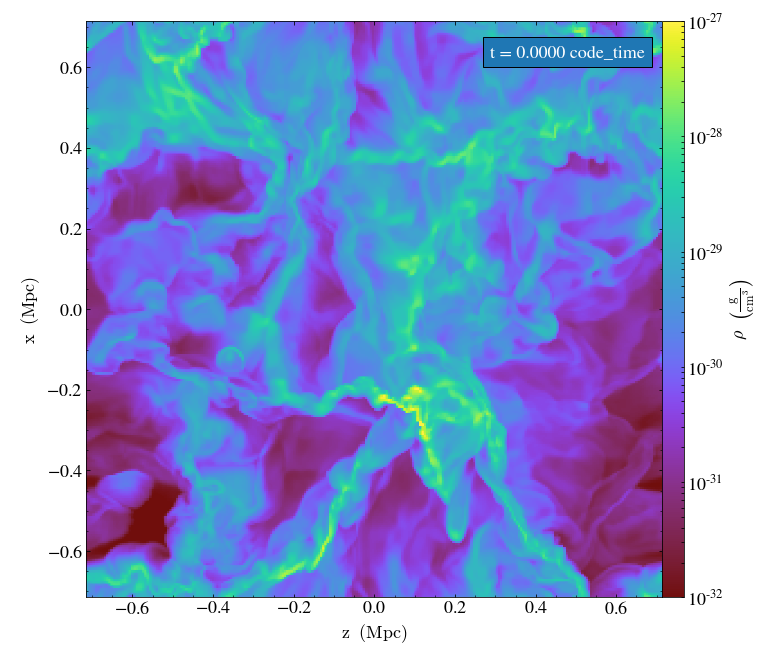

yt : [INFO     ] 2019-04-16 11:34:54,759 Saving plot Data_000092_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:34:55,689 Parameters: current_time              = 1.0000479610336474e-05
yt : [INFO     ] 2019-04-16 11:34:55,690 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:34:55,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:34:55,691 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:34:55,692 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:34:55,693 Parameters: current_redshift          = 99994.20412665031
yt : [INFO     ] 2019-04-16 11:34:55,694 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:34:55,694 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:34:55,695 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:34:58,468 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


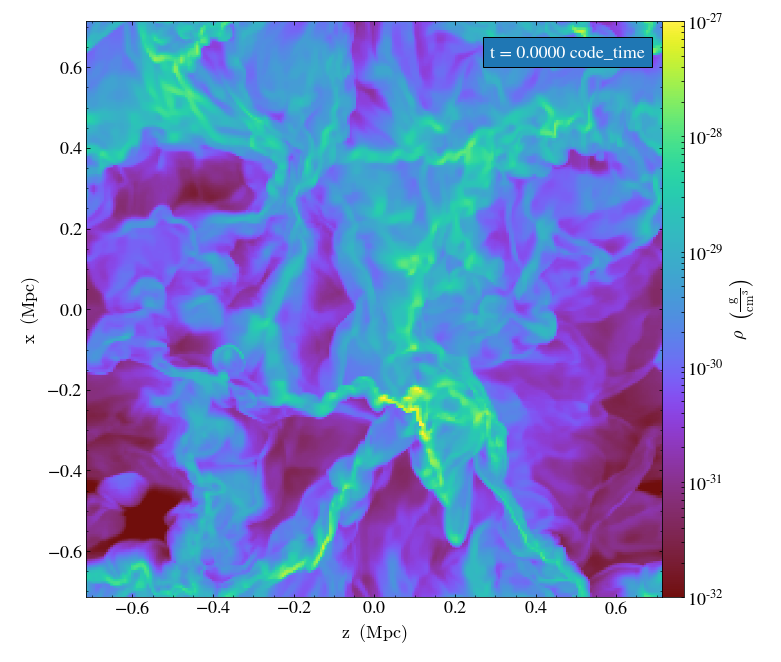

yt : [INFO     ] 2019-04-16 11:34:59,476 Saving plot Data_000093_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:35:00,325 Parameters: current_time              = 1.000049536000009e-05
yt : [INFO     ] 2019-04-16 11:35:00,326 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:35:00,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:35:00,327 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:35:00,328 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:35:00,329 Parameters: current_redshift          = 99994.04664536848
yt : [INFO     ] 2019-04-16 11:35:00,330 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:35:00,330 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:35:00,331 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:35:03,020 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


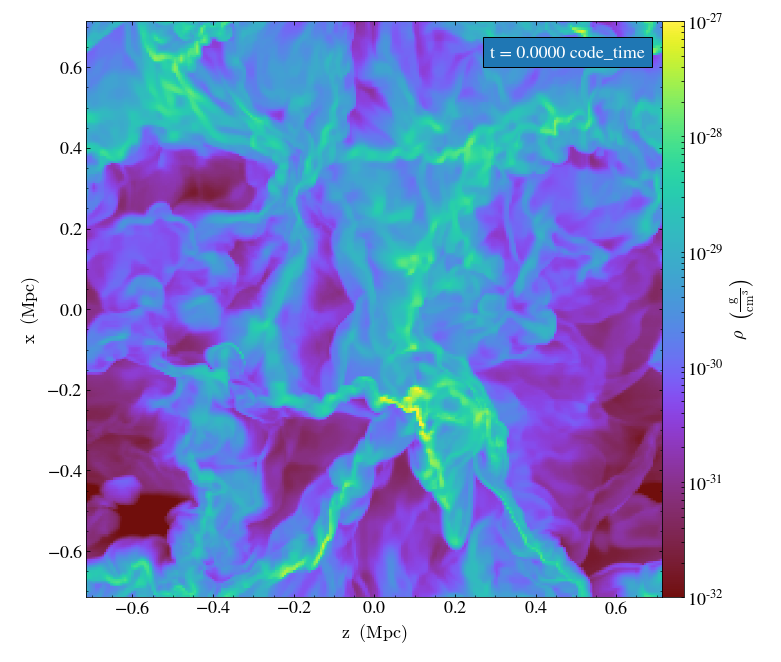

yt : [INFO     ] 2019-04-16 11:35:04,053 Saving plot Data_000094_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:35:05,005 Parameters: current_time              = 1.0000510933475527e-05
yt : [INFO     ] 2019-04-16 11:35:05,006 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:35:05,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:35:05,008 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:35:05,009 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:35:05,010 Parameters: current_redshift          = 99993.89092628441
yt : [INFO     ] 2019-04-16 11:35:05,010 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:35:05,011 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:35:05,012 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:35:07,746 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


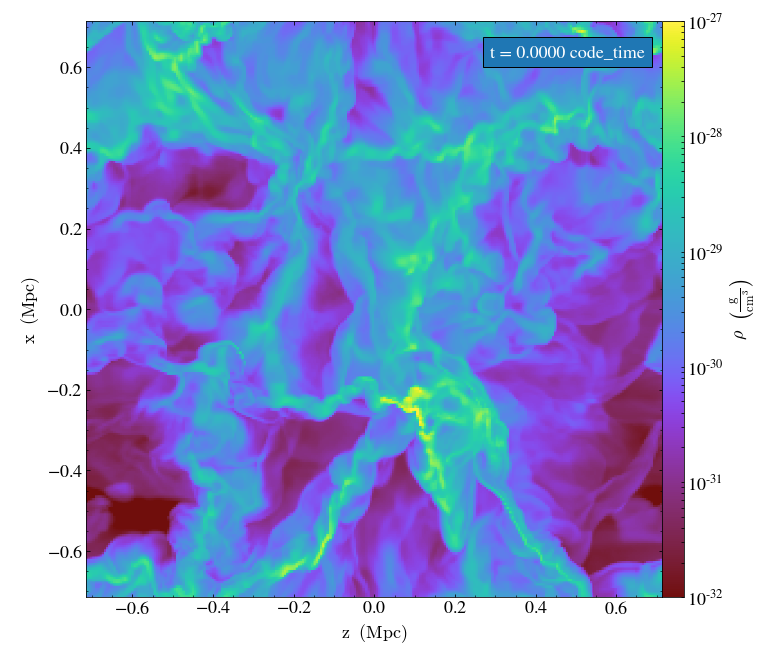

yt : [INFO     ] 2019-04-16 11:35:08,756 Saving plot Data_000095_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:35:09,663 Parameters: current_time              = 1.000052807784253e-05
yt : [INFO     ] 2019-04-16 11:35:09,664 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:35:09,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:35:09,666 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:35:09,666 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:35:09,667 Parameters: current_redshift          = 99993.71950042619
yt : [INFO     ] 2019-04-16 11:35:09,668 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:35:09,668 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:35:09,669 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:35:12,464 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


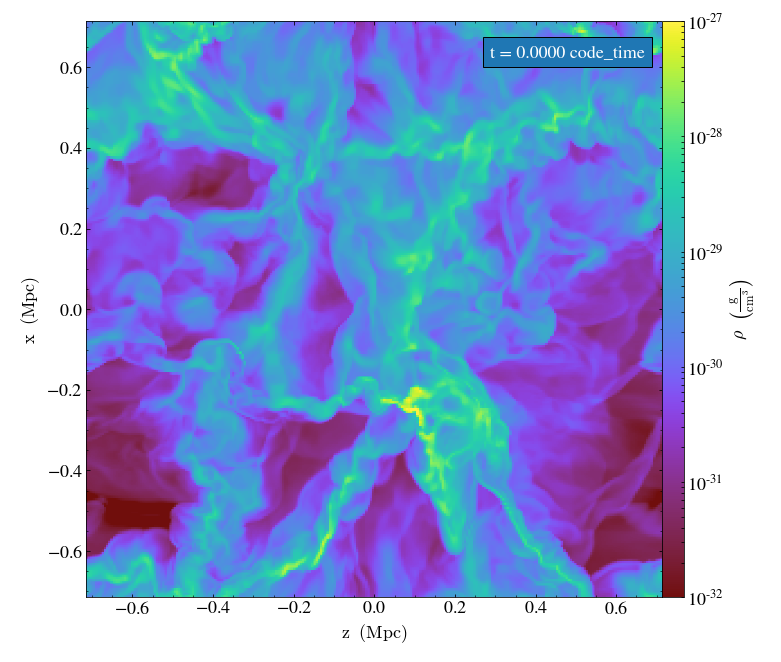

yt : [INFO     ] 2019-04-16 11:35:13,458 Saving plot Data_000096_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:35:14,263 Parameters: current_time              = 1.0000546832377772e-05
yt : [INFO     ] 2019-04-16 11:35:14,264 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:35:14,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:35:14,266 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:35:14,267 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:35:14,268 Parameters: current_redshift          = 99993.53197523157
yt : [INFO     ] 2019-04-16 11:35:14,268 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:35:14,269 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:35:14,270 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:35:17,197 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


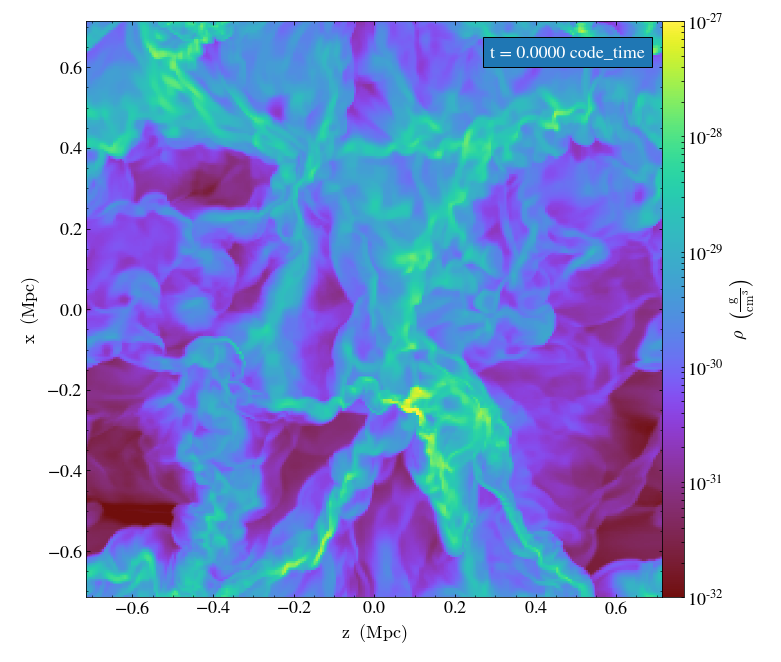

yt : [INFO     ] 2019-04-16 11:35:18,200 Saving plot Data_000097_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:35:19,018 Parameters: current_time              = 1.0000565601672842e-05
yt : [INFO     ] 2019-04-16 11:35:19,019 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:35:19,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:35:19,021 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:35:19,022 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:35:19,023 Parameters: current_redshift          = 99993.34430315874
yt : [INFO     ] 2019-04-16 11:35:19,024 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:35:19,025 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:35:19,025 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:35:21,713 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


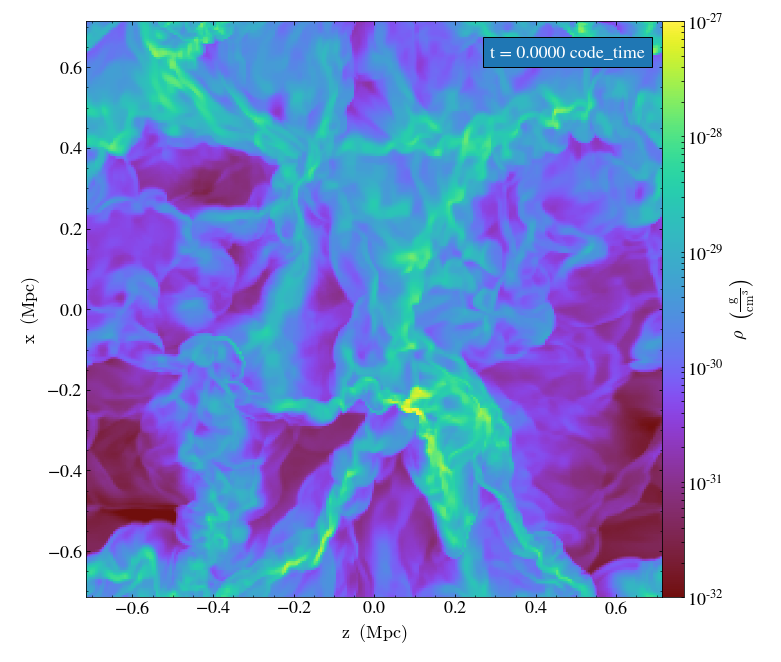

yt : [INFO     ] 2019-04-16 11:35:22,674 Saving plot Data_000098_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:35:23,461 Parameters: current_time              = 1.0000584947856234e-05
yt : [INFO     ] 2019-04-16 11:35:23,462 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:35:23,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:35:23,464 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:35:23,465 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:35:23,466 Parameters: current_redshift          = 99993.15086358164
yt : [INFO     ] 2019-04-16 11:35:23,466 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:35:23,467 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:35:23,468 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:35:25,973 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


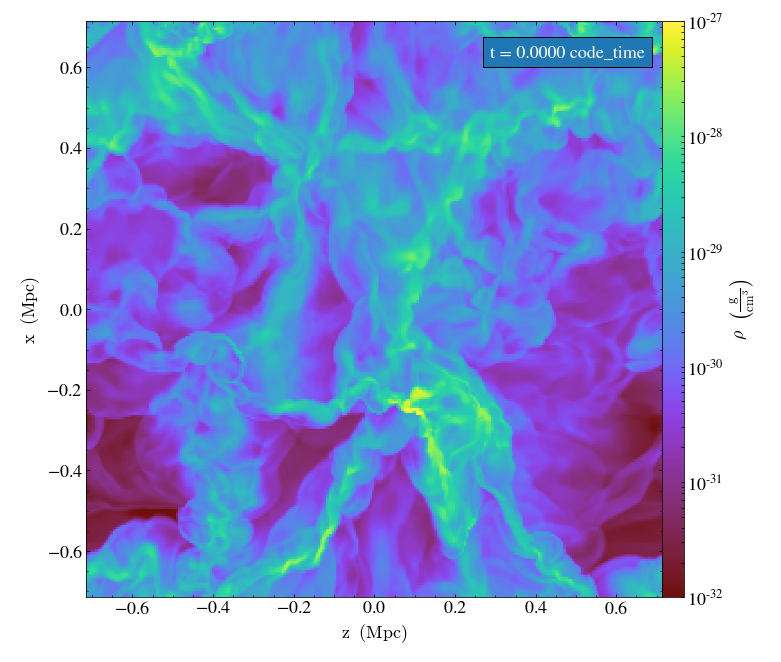

yt : [INFO     ] 2019-04-16 11:35:26,942 Saving plot Data_000099_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:35:27,800 Parameters: current_time              = 1.0000603481176985e-05
yt : [INFO     ] 2019-04-16 11:35:27,801 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:35:27,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:35:27,803 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:35:27,804 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:35:27,805 Parameters: current_redshift          = 99992.96555239771
yt : [INFO     ] 2019-04-16 11:35:27,805 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:35:27,806 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:35:27,807 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:35:30,435 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16


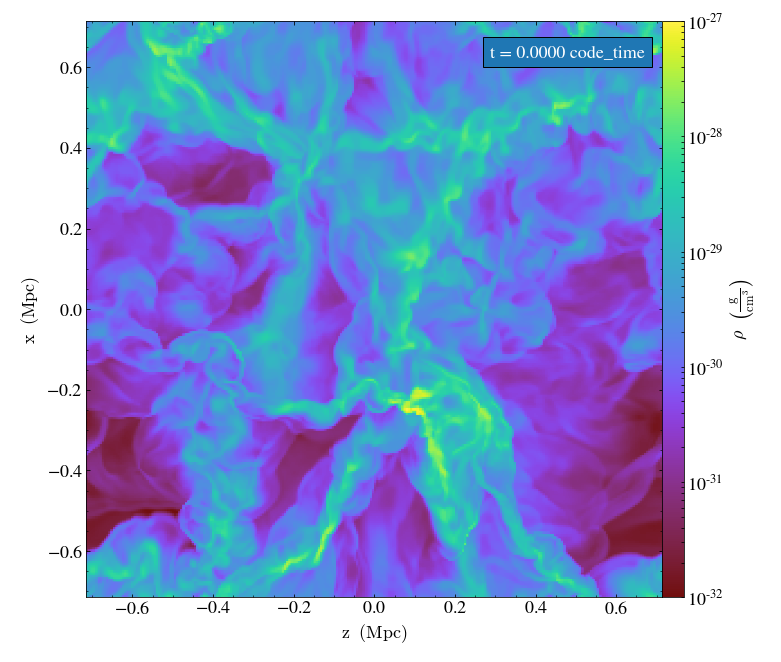

yt : [INFO     ] 2019-04-16 11:35:31,425 Saving plot Data_000100_SlicePlot_Density.png
yt : [INFO     ] 2019-04-16 11:35:32,310 Parameters: current_time              = 1.000062350289863e-05
yt : [INFO     ] 2019-04-16 11:35:32,310 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:35:32,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:35:32,312 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:35:32,313 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:35:32,314 Parameters: current_redshift          = 99992.76535974533
yt : [INFO     ] 2019-04-16 11:35:32,315 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:35:32,315 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:35:32,316 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:35:34,919 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 


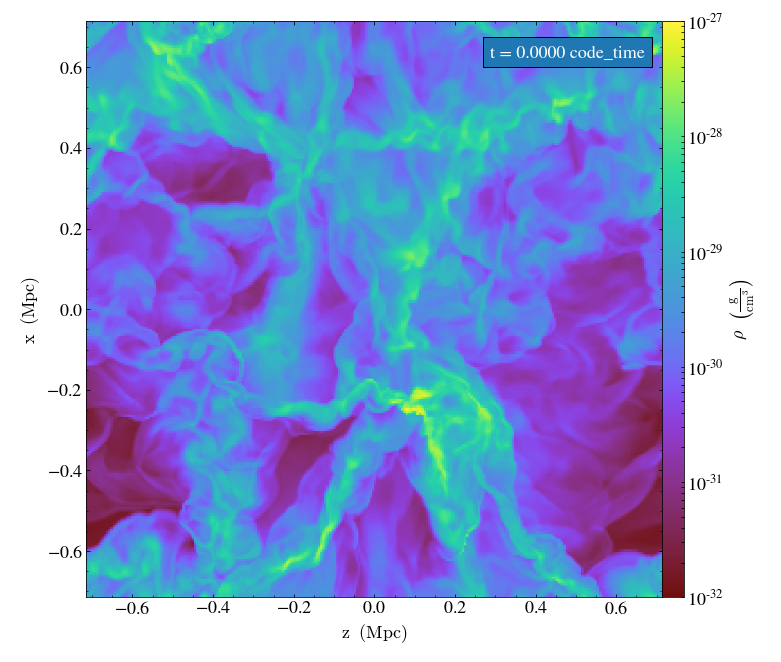

yt : [INFO     ] 2019-04-16 11:35:35,912 Saving plot Data_000101_SlicePlot_Density.png


In [7]:
for ds in ts.piter():
    
    sz = yt.SlicePlot(ds,'y','density')
    sz.set_zlim(field,1e-32,1e-27)
    sz.set_log(field,True)
    sz.set_cmap(field,colormap)
#     sz.set_unit(field,'g/cm**3')
#     sz.set_axes_unit('kpc')
    sz.annotate_timestamp(time_unit='code_time',corner='upper_right',
                         time_format='t = {time:.4f} {units}')
#     sz.annotate_grids(periodic=False)
    sz.show()
    sz.save(name=str(ds)+'_SlicePlot_Density.png')

yt : [WARNING  ] 2018-11-27 10:31:34,298 Cannot determine code units ==> Use units_override to specify the units
yt : [WARNING  ] 2018-11-27 10:31:34,299 Assuming length unit = 1.0 cm
yt : [WARNING  ] 2018-11-27 10:31:34,300 Assuming time unit = 1.0 s
yt : [WARNING  ] 2018-11-27 10:31:34,300 Assuming mass unit = 1.0 g
yt : [INFO     ] 2018-11-27 10:31:34,315 Parameters: current_time              = 0.0
yt : [INFO     ] 2018-11-27 10:31:34,316 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2018-11-27 10:31:34,316 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2018-11-27 10:31:34,317 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2018-11-27 10:31:34,318 Parameters: cosmological_simulation   = 0



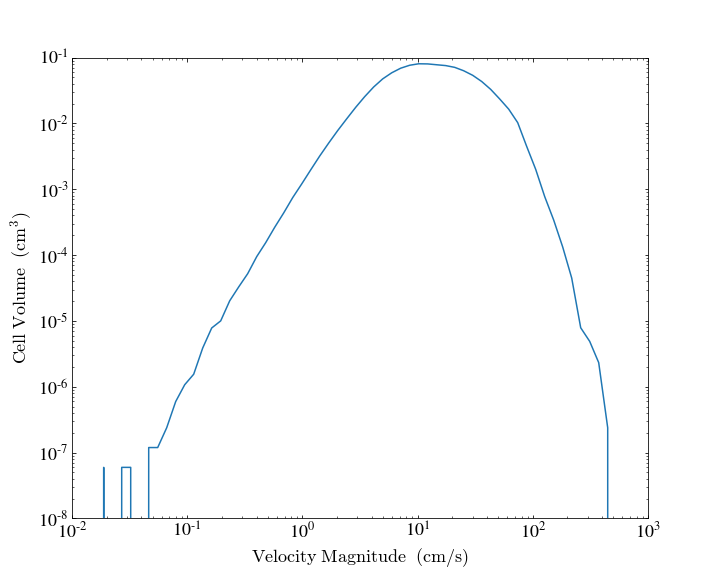

yt : [INFO     ] 2018-11-27 10:31:46,485 Saving Data_000000_PhasePlot.png
yt : [INFO     ] 2018-11-27 10:31:46,486 Saving plot Data_000000_PhasePlot.png
yt : [WARNING  ] 2018-11-27 10:31:46,998 Cannot determine code units ==> Use units_override to specify the units
yt : [WARNING  ] 2018-11-27 10:31:46,999 Assuming length unit = 1.0 cm
yt : [WARNING  ] 2018-11-27 10:31:47,000 Assuming time unit = 1.0 s
yt : [WARNING  ] 2018-11-27 10:31:47,000 Assuming mass unit = 1.0 g
yt : [INFO     ] 2018-11-27 10:31:47,010 Parameters: current_time              = 0.00014100351381785003
yt : [INFO     ] 2018-11-27 10:31:47,011 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2018-11-27 10:31:47,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2018-11-27 10:31:47,013 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2018-11-27 10:31:47,014 Parameters: cosmological_simulation   = 0



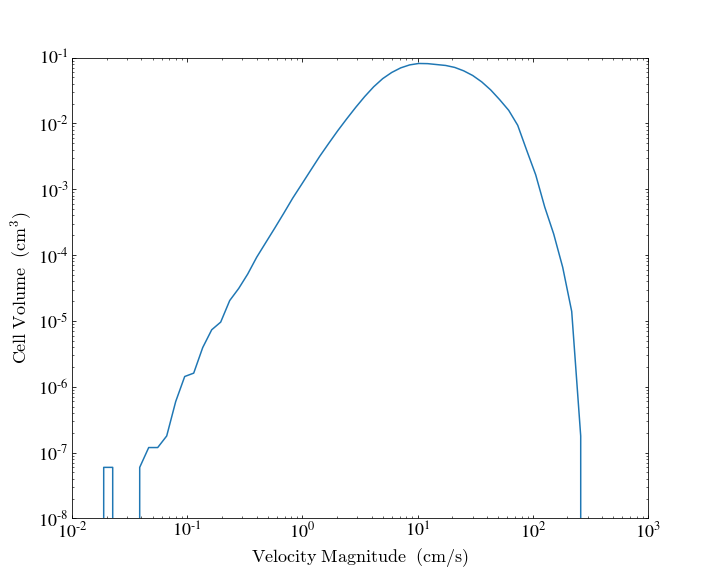

yt : [INFO     ] 2018-11-27 10:31:59,941 Saving Data_000001_PhasePlot.png
yt : [INFO     ] 2018-11-27 10:31:59,942 Saving plot Data_000001_PhasePlot.png
yt : [WARNING  ] 2018-11-27 10:32:00,490 Cannot determine code units ==> Use units_override to specify the units
yt : [WARNING  ] 2018-11-27 10:32:00,491 Assuming length unit = 1.0 cm
yt : [WARNING  ] 2018-11-27 10:32:00,492 Assuming time unit = 1.0 s
yt : [WARNING  ] 2018-11-27 10:32:00,492 Assuming mass unit = 1.0 g
yt : [INFO     ] 2018-11-27 10:32:00,501 Parameters: current_time              = 0.0003082022649323335
yt : [INFO     ] 2018-11-27 10:32:00,502 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2018-11-27 10:32:00,502 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2018-11-27 10:32:00,503 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2018-11-27 10:32:00,503 Parameters: cosmological_simulation   = 0



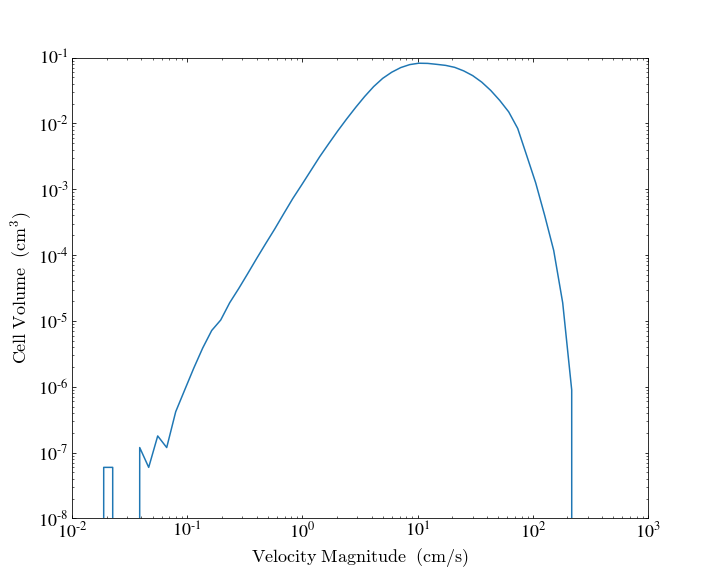

yt : [INFO     ] 2018-11-27 10:32:12,620 Saving Data_000002_PhasePlot.png
yt : [INFO     ] 2018-11-27 10:32:12,621 Saving plot Data_000002_PhasePlot.png
yt : [WARNING  ] 2018-11-27 10:32:13,056 Cannot determine code units ==> Use units_override to specify the units
yt : [WARNING  ] 2018-11-27 10:32:13,057 Assuming length unit = 1.0 cm
yt : [WARNING  ] 2018-11-27 10:32:13,058 Assuming time unit = 1.0 s
yt : [WARNING  ] 2018-11-27 10:32:13,058 Assuming mass unit = 1.0 g
yt : [INFO     ] 2018-11-27 10:32:13,073 Parameters: current_time              = 0.00045354423650678655
yt : [INFO     ] 2018-11-27 10:32:13,073 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2018-11-27 10:32:13,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2018-11-27 10:32:13,074 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2018-11-27 10:32:13,075 Parameters: cosmological_simulation   = 0



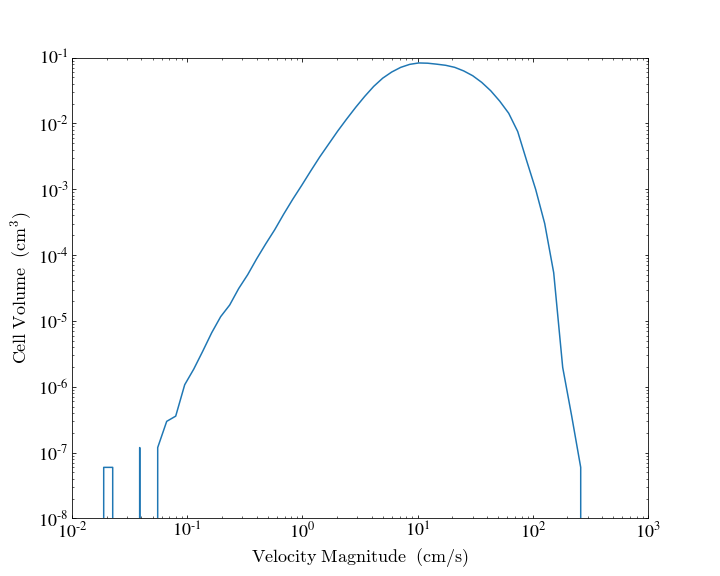

yt : [INFO     ] 2018-11-27 10:32:24,983 Saving Data_000003_PhasePlot.png
yt : [INFO     ] 2018-11-27 10:32:24,984 Saving plot Data_000003_PhasePlot.png
yt : [WARNING  ] 2018-11-27 10:32:25,483 Cannot determine code units ==> Use units_override to specify the units
yt : [WARNING  ] 2018-11-27 10:32:25,484 Assuming length unit = 1.0 cm
yt : [WARNING  ] 2018-11-27 10:32:25,485 Assuming time unit = 1.0 s
yt : [WARNING  ] 2018-11-27 10:32:25,486 Assuming mass unit = 1.0 g
yt : [INFO     ] 2018-11-27 10:32:25,499 Parameters: current_time              = 0.0005783348924524034
yt : [INFO     ] 2018-11-27 10:32:25,499 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2018-11-27 10:32:25,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2018-11-27 10:32:25,501 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2018-11-27 10:32:25,501 Parameters: cosmological_simulation   = 0



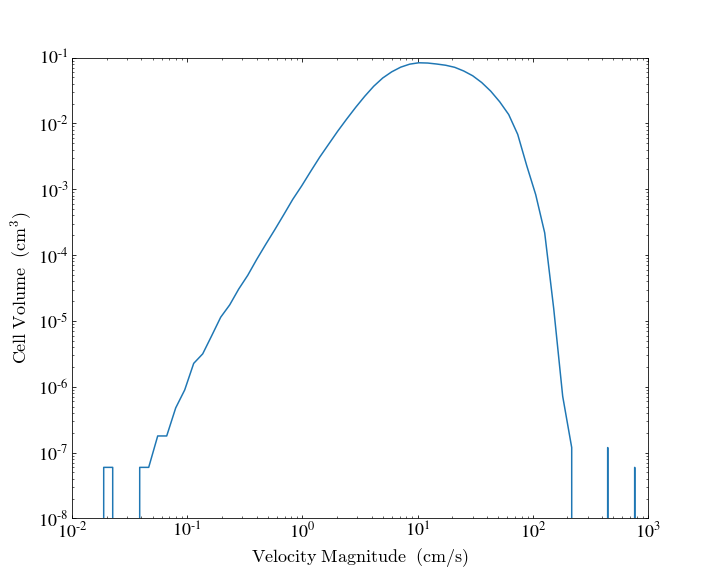

yt : [INFO     ] 2018-11-27 10:32:37,156 Saving Data_000004_PhasePlot.png
yt : [INFO     ] 2018-11-27 10:32:37,156 Saving plot Data_000004_PhasePlot.png
yt : [WARNING  ] 2018-11-27 10:32:37,637 Cannot determine code units ==> Use units_override to specify the units
yt : [WARNING  ] 2018-11-27 10:32:37,638 Assuming length unit = 1.0 cm
yt : [WARNING  ] 2018-11-27 10:32:37,639 Assuming time unit = 1.0 s
yt : [WARNING  ] 2018-11-27 10:32:37,640 Assuming mass unit = 1.0 g
yt : [INFO     ] 2018-11-27 10:32:37,651 Parameters: current_time              = 0.0007243608071348717
yt : [INFO     ] 2018-11-27 10:32:37,652 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2018-11-27 10:32:37,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2018-11-27 10:32:37,653 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2018-11-27 10:32:37,654 Parameters: cosmological_simulation   = 0



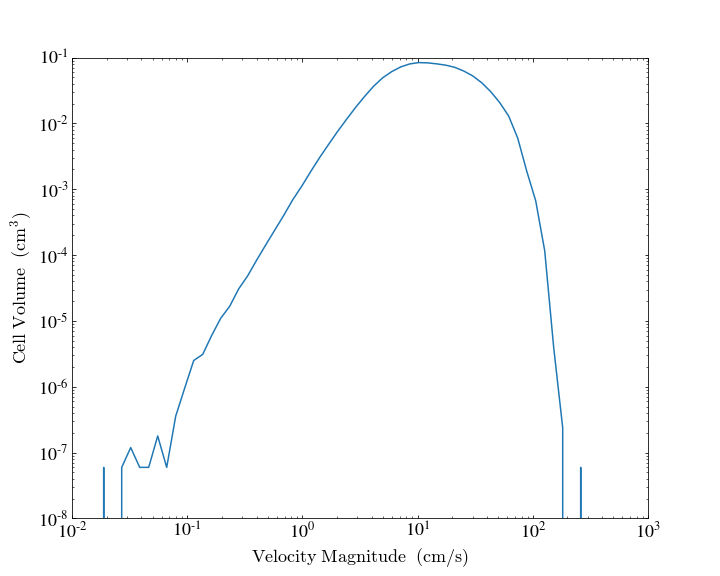

yt : [INFO     ] 2018-11-27 10:32:49,208 Saving Data_000005_PhasePlot.png
yt : [INFO     ] 2018-11-27 10:32:49,209 Saving plot Data_000005_PhasePlot.png
yt : [WARNING  ] 2018-11-27 10:32:49,640 Cannot determine code units ==> Use units_override to specify the units
yt : [WARNING  ] 2018-11-27 10:32:49,640 Assuming length unit = 1.0 cm
yt : [WARNING  ] 2018-11-27 10:32:49,641 Assuming time unit = 1.0 s
yt : [WARNING  ] 2018-11-27 10:32:49,642 Assuming mass unit = 1.0 g
yt : [INFO     ] 2018-11-27 10:32:49,651 Parameters: current_time              = 0.0009046984006545244
yt : [INFO     ] 2018-11-27 10:32:49,652 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2018-11-27 10:32:49,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2018-11-27 10:32:49,653 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2018-11-27 10:32:49,654 Parameters: cosmological_simulation   = 0



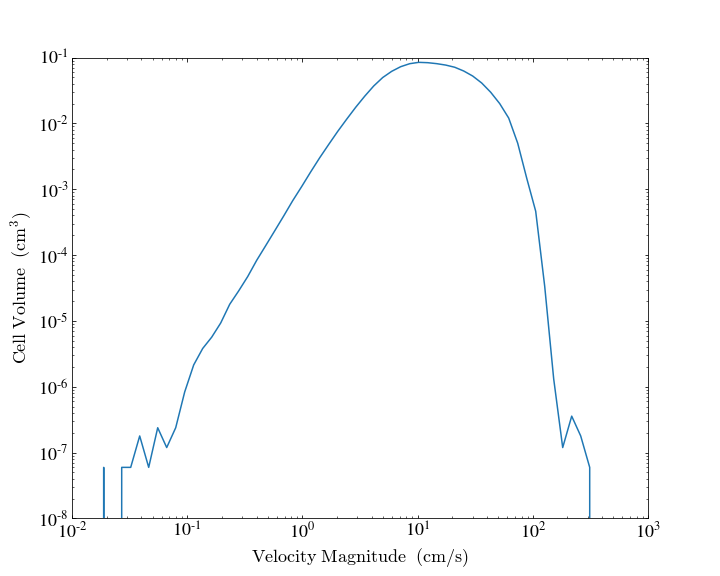

yt : [INFO     ] 2018-11-27 10:33:01,480 Saving Data_000006_PhasePlot.png
yt : [INFO     ] 2018-11-27 10:33:01,480 Saving plot Data_000006_PhasePlot.png


In [13]:
for ds in ts.piter():
    
    sz = ds.r[:].profile("velocity_magnitude", "cell_volume", weight_field=None).plot()
    sz.set_xlim(1e-2,1e3)
    sz.set_ylim('cell_volume',1e-8,1e-1)
    sz.show()
    sz.save(name=str(ds)+'_PhasePlot.png')

yt : [INFO     ] 2019-01-12 14:38:33,827 Parameters: current_time              = 1e-05
yt : [INFO     ] 2019-01-12 14:38:33,828 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-01-12 14:38:33,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-01-12 14:38:33,829 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-01-12 14:38:33,830 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-01-12 14:38:33,831 Parameters: current_redshift          = 99998.99999999999
yt : [INFO     ] 2019-01-12 14:38:33,831 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-01-12 14:38:33,832 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-01-12 14:38:33,832 Parameters: hubble_constant           = 0.7



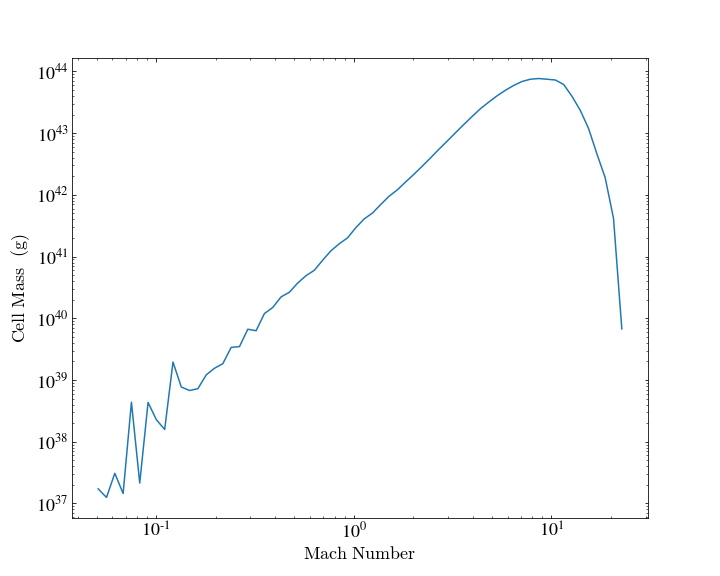

yt : [INFO     ] 2019-01-12 14:38:42,975 Parameters: current_time              = 1.0000000154400782e-05
yt : [INFO     ] 2019-01-12 14:38:42,975 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-01-12 14:38:42,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-01-12 14:38:42,977 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-01-12 14:38:42,978 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-01-12 14:38:42,978 Parameters: current_redshift          = 99998.9984559922
yt : [INFO     ] 2019-01-12 14:38:42,979 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-01-12 14:38:42,979 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-01-12 14:38:42,980 Parameters: hubble_constant           = 0.7
/home/cass/.local/lib/python3.7/site-packages/yt/units/yt_array.py:1373: RuntimeWarning: invalid value encountered in sqrt
  out_arr = func(np.asarray(inp), out=out, **kwargs)
/home


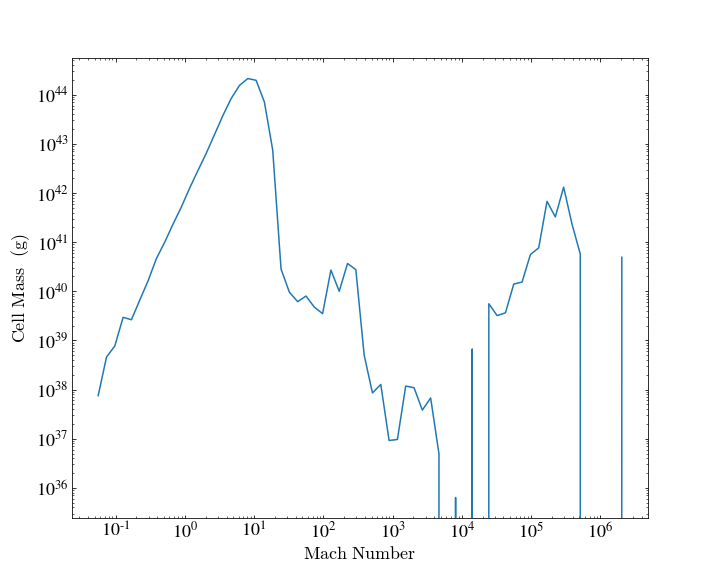

yt : [INFO     ] 2019-01-12 14:38:52,414 Parameters: current_time              = 1.0000000154401107e-05
yt : [INFO     ] 2019-01-12 14:38:52,415 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-01-12 14:38:52,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-01-12 14:38:52,416 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-01-12 14:38:52,417 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-01-12 14:38:52,417 Parameters: current_redshift          = 99998.99845598896
yt : [INFO     ] 2019-01-12 14:38:52,418 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-01-12 14:38:52,418 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-01-12 14:38:52,419 Parameters: hubble_constant           = 0.7
/home/cass/.local/lib/python3.7/site-packages/yt/units/yt_array.py:1373: RuntimeWarning: invalid value encountered in sqrt
  out_arr = func(np.asarray(inp), out=out, **kwargs)
/hom


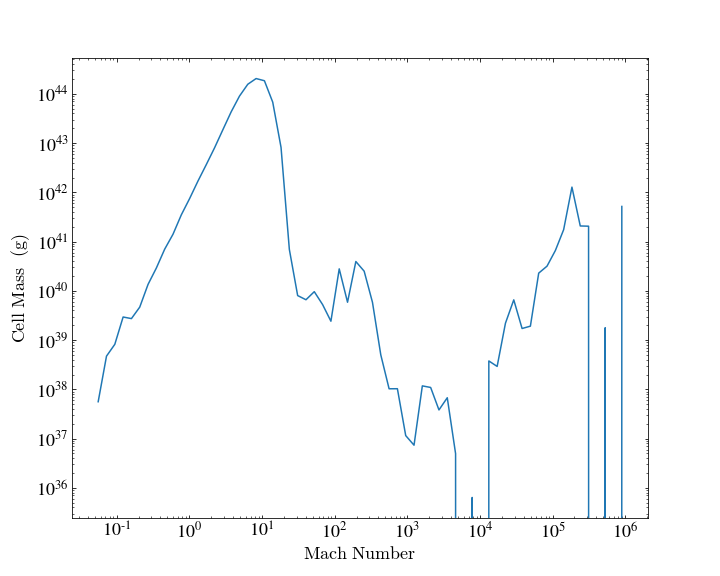

yt : [INFO     ] 2019-01-12 14:39:02,239 Parameters: current_time              = 1.0000000154401432e-05
yt : [INFO     ] 2019-01-12 14:39:02,240 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-01-12 14:39:02,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-01-12 14:39:02,241 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-01-12 14:39:02,242 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-01-12 14:39:02,243 Parameters: current_redshift          = 99998.9984559857
yt : [INFO     ] 2019-01-12 14:39:02,243 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-01-12 14:39:02,244 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-01-12 14:39:02,244 Parameters: hubble_constant           = 0.7
/home/cass/.local/lib/python3.7/site-packages/yt/units/yt_array.py:1373: RuntimeWarning: invalid value encountered in sqrt
  out_arr = func(np.asarray(inp), out=out, **kwargs)
/home


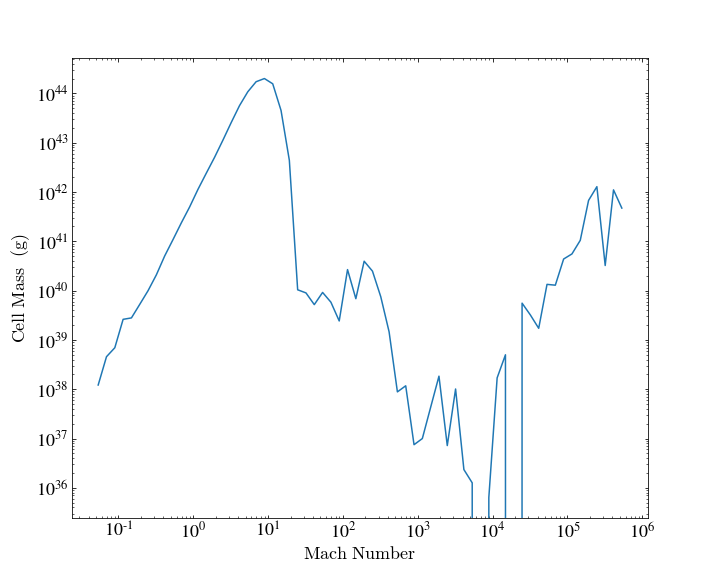

yt : [INFO     ] 2019-01-12 14:39:12,042 Parameters: current_time              = 1.0000000154401757e-05
yt : [INFO     ] 2019-01-12 14:39:12,043 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-01-12 14:39:12,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-01-12 14:39:12,045 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-01-12 14:39:12,046 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-01-12 14:39:12,047 Parameters: current_redshift          = 99998.99845598245
yt : [INFO     ] 2019-01-12 14:39:12,048 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-01-12 14:39:12,048 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-01-12 14:39:12,049 Parameters: hubble_constant           = 0.7
/home/cass/.local/lib/python3.7/site-packages/yt/units/yt_array.py:1373: RuntimeWarning: invalid value encountered in sqrt
  out_arr = func(np.asarray(inp), out=out, **kwargs)
/hom


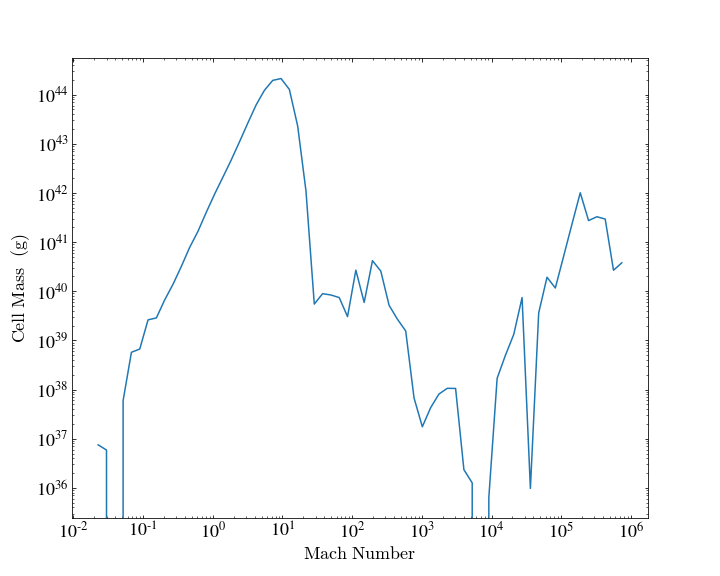

yt : [INFO     ] 2019-01-12 14:39:21,163 Parameters: current_time              = 1.0000000154402083e-05
yt : [INFO     ] 2019-01-12 14:39:21,164 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-01-12 14:39:21,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-01-12 14:39:21,165 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-01-12 14:39:21,166 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-01-12 14:39:21,167 Parameters: current_redshift          = 99998.99845597919
yt : [INFO     ] 2019-01-12 14:39:21,168 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-01-12 14:39:21,169 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-01-12 14:39:21,169 Parameters: hubble_constant           = 0.7
/home/cass/.local/lib/python3.7/site-packages/yt/units/yt_array.py:1373: RuntimeWarning: invalid value encountered in sqrt
  out_arr = func(np.asarray(inp), out=out, **kwargs)
/hom


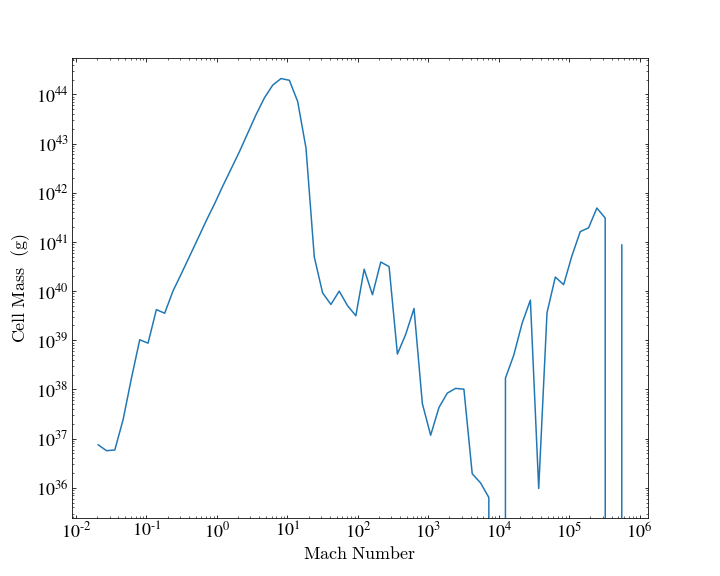

In [38]:
for ds in ts.piter():
    
    sz = ds.r[:].profile("mach_number", "cell_mass", weight_field=None).plot()
#     sz.set_xlim(1e-2,1e2)
#     sz.set_ylim('cell_mass',1e-9,1)
    sz.show()
#     sz.save(name=str(ds)+'_MassDist_Mach.png')

In [ ]:
for ds in ts.piter():
    
    sz = ds.r[:].profile("mach_number", "cell_mass", weight_field=None).plot()
    sz.set_xlim(1e-2,1e2)
#     sz.set_ylim('cell_mass',1e-9,1)
    sz.show()
#     sz.save(name=str(ds)+'_MassDist_Mach.png')

yt : [INFO     ] 2019-04-16 11:26:35,289 Parameters: current_time              = 1.0000001841031177e-05
yt : [INFO     ] 2019-04-16 11:26:35,290 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:26:35,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:26:35,292 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:26:35,293 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:26:35,294 Parameters: current_redshift          = 99998.98158969163
yt : [INFO     ] 2019-04-16 11:26:35,295 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:26:35,296 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:26:35,297 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-04-16 11:26:43,445 Projection completed
yt : [INFO     ] 2019-04-16 11:26:43,449 xlim = 0.000000 1.000000
yt : [INFO     ] 2019-04-16 11:26:43,450 ylim = 0.00


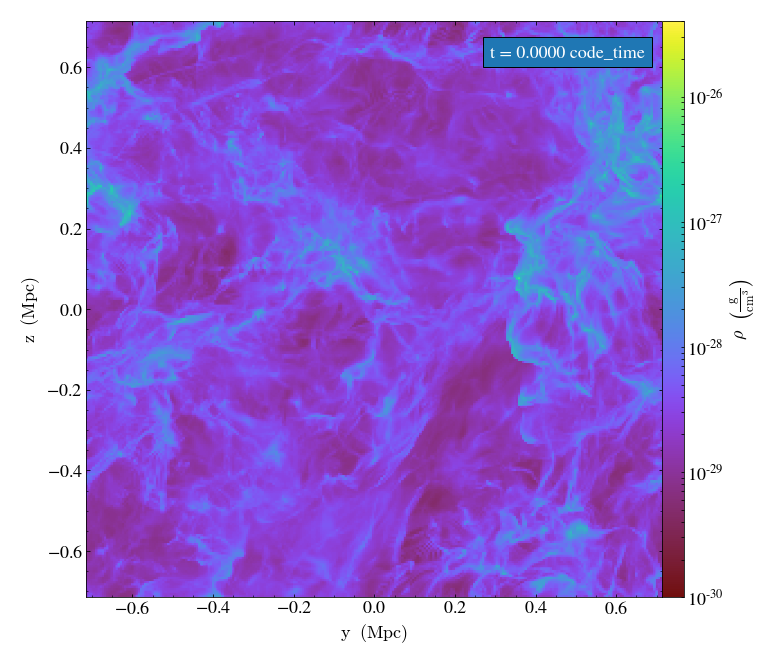

yt : [INFO     ] 2019-04-16 11:26:44,690 Parameters: current_time              = 1.0000004458924037e-05
yt : [INFO     ] 2019-04-16 11:26:44,691 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-04-16 11:26:44,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-04-16 11:26:44,693 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-04-16 11:26:44,695 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-04-16 11:26:44,696 Parameters: current_redshift          = 99998.95541077951
yt : [INFO     ] 2019-04-16 11:26:44,697 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-04-16 11:26:44,697 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-04-16 11:26:44,698 Parameters: hubble_constant           = 0.7


KeyboardInterrupt: 

In [5]:
for ds in ts.piter():
    
    sz = yt.ProjectionPlot(ds,'x','density',weight_field='density')
    sz.set_zlim(field,1e-30,4e-26)
    sz.set_log(field,True)
    sz.set_cmap(field,colormap)
#     sz.set_unit(field,'g/cm**3')
#     sz.set_axes_unit('kpc')
    sz.annotate_timestamp(time_unit='code_time',corner='upper_right',
                         time_format='t = {time:.4f} {units}')
#     sz.annotate_grids(periodic=False)
    sz.show()
#     sz.save(name='ProjectionPlot_Density_' + str(ds) + '.png')

yt : [INFO     ] 2019-02-26 14:03:52,728 Parameters: current_time              = 1e-05
yt : [INFO     ] 2019-02-26 14:03:52,729 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-02-26 14:03:52,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-02-26 14:03:52,731 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-02-26 14:03:52,732 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-02-26 14:03:52,732 Parameters: current_redshift          = 99998.99999999999
yt : [INFO     ] 2019-02-26 14:03:52,733 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-02-26 14:03:52,733 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-02-26 14:03:52,733 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-02-26 14:03:53,479 Setting default field to ('gas', 'density')
yt : [INFO     ] 2019-02-26 14:03:53,493 Rendering scene (Can take a while).
yt : [INFO     ] 2019-02-26 14:03:5

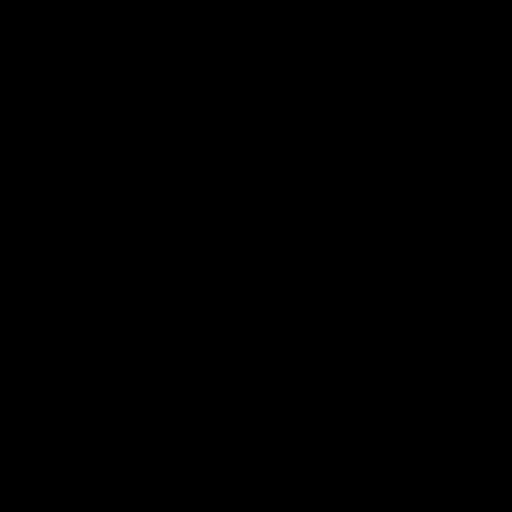

OSError: Unable to open file (unable to open file: name = 'Data_000001', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [12]:
for ds in ts.piter():
    ds.periodicity = (True,True,True)

    sc = yt.create_scene(ds, lens_type='perspective')

    sc.camera.set_width(ds.quan(100,'kpc'))
    source = sc[0]

    # source.tfh.set_bounds((1e-31, 5e-26))
    # source.tfh.set_log(True)
    # source.tfh.grey_opacity = False

    source.set_field('density')
    source.set_log(True)
    # source.set_use_ghost_zones(True)

    bounds = (3.5e-3, 1e2)

    # Since this rendering is done in log space, the transfer function needs
    # to be specified in log space.
    tf = yt.ColorTransferFunction(np.log10(bounds))

    tf.add_layers(5, colormap='viridis_r')

    source.tfh.tf = tf
    source.tfh.bounds = bounds

    # sc.camera.zoom(5)
    sc.show(sigma_clip=4.0)
#     sc.save(fname=str(ds) + '_vol_render.png',sigma_clip=6.0)

In [14]:
fields = ['density','velocity_magnitude','velocity_x','velocity_y',
          'velocity_z']

In [ ]:
for i in fields:
    for j in ['x','y','z']:
        for ds in ts.piter():
            s = yt.SlicePlot(ds,j,i)
#             s.show()
            s.save(name='mar6_run/images/' + str(ds)+ '_' + str(i)+ '_' + str(j) + '_slice.png')

In [44]:
for ds in ts:
    print(ts.outputs.index("mar6_run/"+str(ds)))

yt : [INFO     ] 2019-03-11 22:44:04,398 Parameters: current_time              = 1e-05
yt : [INFO     ] 2019-03-11 22:44:04,399 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:04,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:04,401 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:04,402 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:04,403 Parameters: current_redshift          = 99998.99999999999
yt : [INFO     ] 2019-03-11 22:44:04,404 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:04,405 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:04,406 Parameters: hubble_constant           = 0.7


0


yt : [INFO     ] 2019-03-11 22:44:04,796 Parameters: current_time              = 1.0000001841031177e-05
yt : [INFO     ] 2019-03-11 22:44:04,796 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:04,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:04,798 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:04,799 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:04,800 Parameters: current_redshift          = 99998.98158969163
yt : [INFO     ] 2019-03-11 22:44:04,800 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:04,801 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:04,802 Parameters: hubble_constant           = 0.7


1


yt : [INFO     ] 2019-03-11 22:44:05,109 Parameters: current_time              = 1.0000004458924037e-05
yt : [INFO     ] 2019-03-11 22:44:05,110 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:05,111 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:05,112 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:05,113 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:05,113 Parameters: current_redshift          = 99998.95541077951
yt : [INFO     ] 2019-03-11 22:44:05,114 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:05,115 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:05,115 Parameters: hubble_constant           = 0.7


2


yt : [INFO     ] 2019-03-11 22:44:05,504 Parameters: current_time              = 1.0000007152275187e-05
yt : [INFO     ] 2019-03-11 22:44:05,505 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:05,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:05,507 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:05,508 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:05,508 Parameters: current_redshift          = 99998.92847729928
yt : [INFO     ] 2019-03-11 22:44:05,509 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:05,510 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:05,510 Parameters: hubble_constant           = 0.7


3


yt : [INFO     ] 2019-03-11 22:44:05,823 Parameters: current_time              = 1.0000009746218316e-05
yt : [INFO     ] 2019-03-11 22:44:05,824 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:05,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:05,826 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:05,827 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:05,828 Parameters: current_redshift          = 99998.90253791184
yt : [INFO     ] 2019-03-11 22:44:05,829 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:05,829 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:05,830 Parameters: hubble_constant           = 0.7


4


yt : [INFO     ] 2019-03-11 22:44:06,220 Parameters: current_time              = 1.0000012293896476e-05
yt : [INFO     ] 2019-03-11 22:44:06,221 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:06,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:06,223 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:06,224 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:06,225 Parameters: current_redshift          = 99998.87706118639
yt : [INFO     ] 2019-03-11 22:44:06,226 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:06,226 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:06,227 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-03-11 22:44:06,536 Parameters: current_time              = 1.0000014342343237e-05


5


yt : [INFO     ] 2019-03-11 22:44:06,537 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:06,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:06,539 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:06,540 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:06,541 Parameters: current_redshift          = 99998.85657677334
yt : [INFO     ] 2019-03-11 22:44:06,541 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:06,542 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:06,543 Parameters: hubble_constant           = 0.7


6


yt : [INFO     ] 2019-03-11 22:44:06,931 Parameters: current_time              = 1.0000016614904162e-05
yt : [INFO     ] 2019-03-11 22:44:06,932 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:06,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:06,934 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:06,934 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:06,935 Parameters: current_redshift          = 99998.83385123443
yt : [INFO     ] 2019-03-11 22:44:06,936 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:06,936 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:06,937 Parameters: hubble_constant           = 0.7


7


yt : [INFO     ] 2019-03-11 22:44:07,246 Parameters: current_time              = 1.0000018288579861e-05
yt : [INFO     ] 2019-03-11 22:44:07,247 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:07,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:07,249 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:07,250 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:07,251 Parameters: current_redshift          = 99998.81711453586
yt : [INFO     ] 2019-03-11 22:44:07,251 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:07,252 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:07,253 Parameters: hubble_constant           = 0.7


8


yt : [INFO     ] 2019-03-11 22:44:07,641 Parameters: current_time              = 1.000002099137004e-05
yt : [INFO     ] 2019-03-11 22:44:07,642 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:07,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:07,643 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:07,644 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:07,645 Parameters: current_redshift          = 99998.79008674023
yt : [INFO     ] 2019-03-11 22:44:07,645 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:07,646 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:07,647 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-03-11 22:44:07,957 Parameters: current_time              = 1.0000022906338907e-05
yt : [INFO     ] 2019-03-11 22:44:07,957 Parameters: domain_dimensions       

9


yt : [INFO     ] 2019-03-11 22:44:07,962 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:07,963 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-03-11 22:44:08,351 Parameters: current_time              = 1.000002569217582e-05
yt : [INFO     ] 2019-03-11 22:44:08,352 Parameters: domain_dimensions         = [256 256 256]


10


yt : [INFO     ] 2019-03-11 22:44:08,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:08,354 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:08,356 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:08,356 Parameters: current_redshift          = 99998.74307890188
yt : [INFO     ] 2019-03-11 22:44:08,357 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:08,358 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:08,359 Parameters: hubble_constant           = 0.7


11


yt : [INFO     ] 2019-03-11 22:44:08,736 Parameters: current_time              = 1.0000028609136235e-05
yt : [INFO     ] 2019-03-11 22:44:08,737 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:08,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:08,739 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:08,740 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:08,741 Parameters: current_redshift          = 99998.71390945613
yt : [INFO     ] 2019-03-11 22:44:08,741 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:08,742 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:08,743 Parameters: hubble_constant           = 0.7


12


yt : [INFO     ] 2019-03-11 22:44:09,141 Parameters: current_time              = 1.000003137187395e-05
yt : [INFO     ] 2019-03-11 22:44:09,141 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:09,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:09,143 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:09,144 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:09,145 Parameters: current_redshift          = 99998.6862822447
yt : [INFO     ] 2019-03-11 22:44:09,146 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:09,147 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:09,147 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-03-11 22:44:09,527 Parameters: current_time              = 1.0000034186532752e-05


13


yt : [INFO     ] 2019-03-11 22:44:09,527 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:09,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:09,530 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:09,531 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:09,531 Parameters: current_redshift          = 99998.6581358412
yt : [INFO     ] 2019-03-11 22:44:09,532 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:09,533 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:09,533 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-03-11 22:44:09,931 Parameters: current_time              = 1.000003701333829e-05


14


yt : [INFO     ] 2019-03-11 22:44:09,932 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:09,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-11 22:44:09,934 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-11 22:44:09,935 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:09,936 Parameters: current_redshift          = 99998.6298679871
yt : [INFO     ] 2019-03-11 22:44:09,937 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:09,937 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:09,938 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-03-11 22:44:10,253 Parameters: current_time              = 1.0000037753940052e-05
yt : [INFO     ] 2019-03-11 22:44:10,254 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-11 22:44:10,255 Parameters: domain_left_edge          = [0. 0

15


yt : [INFO     ] 2019-03-11 22:44:10,257 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-11 22:44:10,258 Parameters: current_redshift          = 99998.62246202482
yt : [INFO     ] 2019-03-11 22:44:10,259 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-11 22:44:10,259 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-11 22:44:10,260 Parameters: hubble_constant           = 0.7


16


KeyboardInterrupt: 

In [7]:
M_s = np.full(len(ts),np.nan)
rho = np.full(len(ts),np.nan)
t = np.full(len(ts),np.nan)
ct = np.full(len(ts),np.nan)
cfl = np.full(len(ts),np.nan)
temp = np.full(len(ts),np.nan)

for ds in ts:

    i = ts.outputs.index("mar6_run/"+str(ds))

    cg = ds.covering_grid(0, left_edge = [0.0,0.0,0.0], dims=[256,256,256])
    cg.get_data(["mach_number","density","temperature","courant_time_step","velocity_x","velocity_y",
                 "velocity_z","dx","dy","dz"])
    
    CFL = ( cg["velocity_x"] * (cg["courant_time_step"]) / cg["dx"] + 
            cg["velocity_y"] * (cg["courant_time_step"]) / cg["dy"] + 
            cg["velocity_z"] * (cg["courant_time_step"]) / cg["dz"] )

    
    M_s[i] = (cg["mach_number"].mean().in_cgs())
    rho[i] = (cg["density"].mean().in_cgs())
    t[i] = (ds.current_time)
    ct[i] = (cg["courant_time_step"].mean())
    cfl[i] = CFL.mean().in_cgs()
    temp[i] = cg["temperature"].mean().in_cgs()
    
# plt.scatter(t, (np.array(M_s)).mean(),c='k')
# plt.xlim(1e-5,1.000001e-5)
# plt.show()

# plt.scatter(t, (np.array(rho)).mean(),c='k')
# plt.xlim(1e-5,1.000001e-5)
# plt.show()


yt : [INFO     ] 2019-03-18 12:26:58,839 Parameters: current_time              = 1e-05
yt : [INFO     ] 2019-03-18 12:26:58,840 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2019-03-18 12:26:58,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2019-03-18 12:26:58,842 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2019-03-18 12:26:58,843 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2019-03-18 12:26:58,844 Parameters: current_redshift          = 99998.99999999999
yt : [INFO     ] 2019-03-18 12:26:58,844 Parameters: omega_lambda              = 0.0
yt : [INFO     ] 2019-03-18 12:26:58,845 Parameters: omega_matter              = 1.0
yt : [INFO     ] 2019-03-18 12:26:58,846 Parameters: hubble_constant           = 0.7
yt : [INFO     ] 2019-03-18 12:27:14,599 Parameters: current_time              = 1.0000001841031177e-05
yt : [INFO     ] 2019-03-18 12:27:14,601 Parameters: domain_dimensions         = [256 256 256

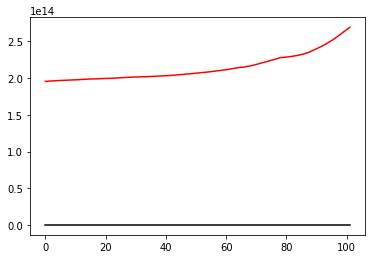

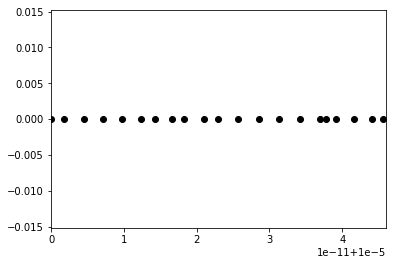

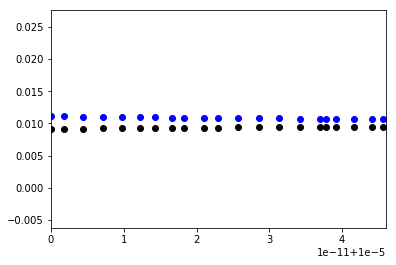

In [10]:


plt.plot(t,c='k')
plt.plot(ct,c='r')
# plt.xlim(1e-5,1.0000046e-5)
plt.show()

plt.scatter(t, rho,c='k')
plt.xlim(1e-5,1.0000046e-5)
plt.show()

plt.scatter(t, cfl/cfl.sum(),c='k')
plt.scatter(t, M_s/M_s.sum(),c='b')
plt.xlim(1e-5,1.0000046e-5)
plt.show()

In [ ]:
plt.plot(times,M_s_mean,label="Mean Mach number")
# plt.plot(times,M_s_max,label="Max Mach number")
# plt.plot(times,M_s_min,label="Min Mach number")
plt.ylabel("Mach number",fontsize=30)
plt.xlabel("Time",fontsize=30)
# plt.xlim(0.0026,0.0027)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

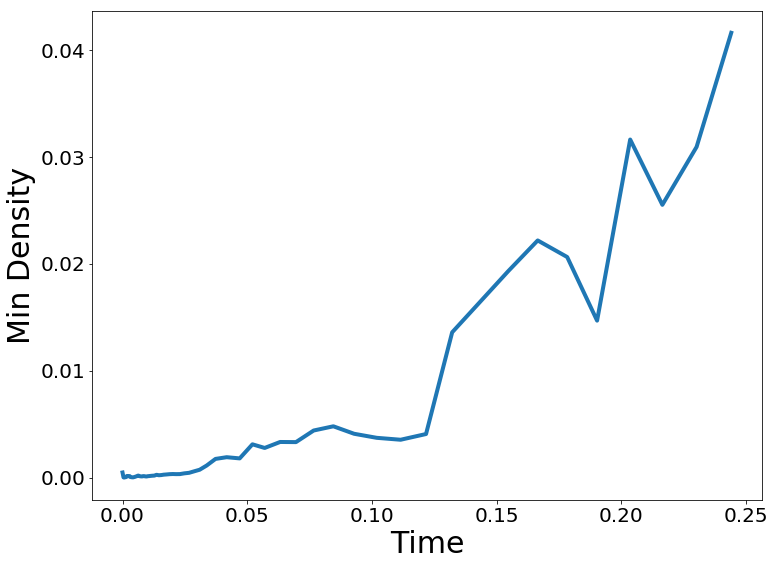

In [22]:
plt.plot(times, density_min,lw=4)
plt.ylabel("Min Density",fontsize=30)
plt.xlabel("Time",fontsize=30)
# pylab.xlim(0, 0.2)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show()

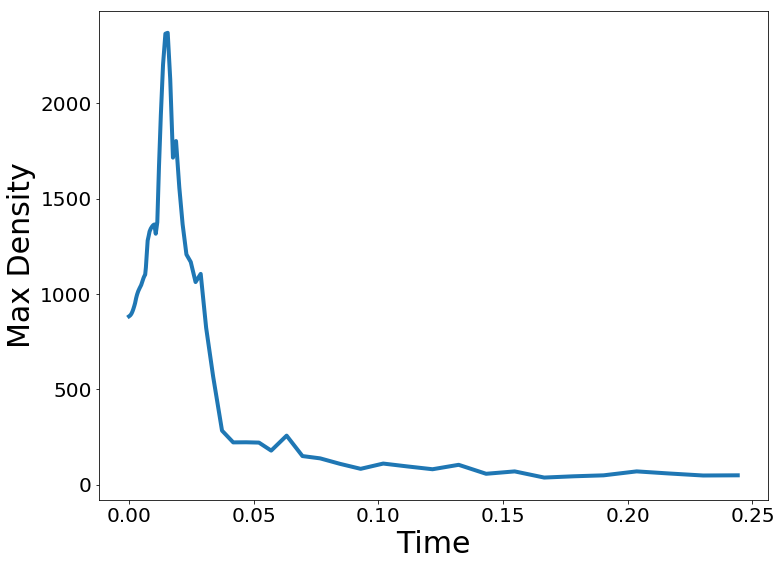

In [13]:
plt.plot(times, density_max,lw=4)
plt.ylabel("Max Density",fontsize=30)
plt.xlabel("Time",fontsize=30)
# pylab.xlim(0, 0.2)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show()

/home/cwagner4/applications/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log10
  """Entry point for launching an IPython kernel.


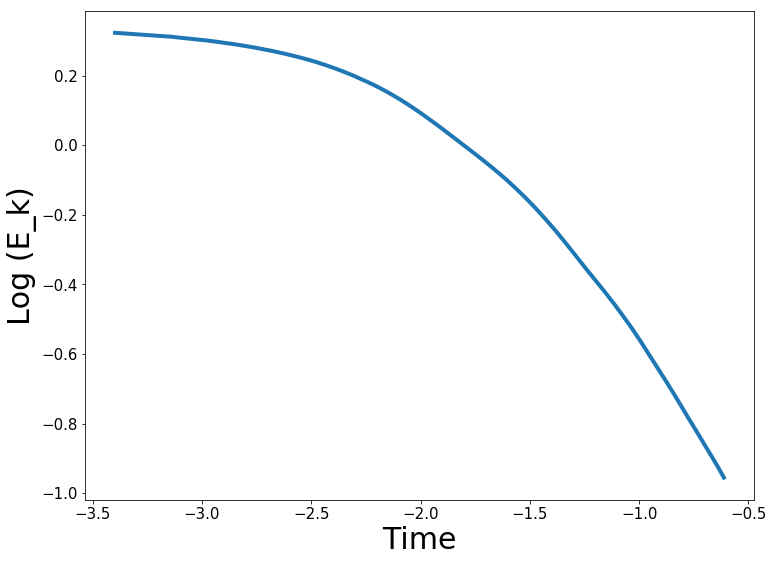

In [21]:
plt.plot(np.log10(times), np.log10(K_energy/np.mean(K_energy)),lw=4)
plt.ylabel("Log (E_k)",fontsize=30)
plt.xlabel("Time",fontsize=30)
# pylab.xlim(0, 0.2)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()